In [1]:
import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.dates import (YEARLY, DateFormatter,
                              rrulewrapper, RRuleLocator, drange)
import datetime   # package that helps manipulate dates
import matplotlib.dates as mdates
import calendar

from dateutil.parser import parse     # package for date parsing
from prophet import Prophet
from pmdarima import auto_arima




# Aqicn data

If you are working with data from aqicn.org, then you need to run this code before using rolling_prophet_forcast_CI_with arima.

In [2]:
def change_df (df):
    data = df.copy()
    data.date = pd.to_datetime(data.date)
    data = data.sort_values(by ='date', ascending= False)

    data.columns = ['date','PM25','PM10','O3','NO2','SO2','CO']

    for col in data.columns:
        if col != 'date':
            data[col] = pd.to_numeric(data[col], errors ='coerce')
    data = data.dropna()
    data = data.sort_values('date', ascending =False)
    return data




# Nasa data

If you are working with data from NASA, then you need to run this code before using rolling_prophet_forcast_CI_with_arima.

In [3]:
def cleaning_NASA_data(a, pollutant):
    """
    Cleans NASA CSV data: renames columns, drops metadata rows, converts types, sorts by date,
    and filters for positive values of the pollutant.
    """
    a.columns = ['date', pollutant]
    a.drop(list(range(0, 7)), inplace=True)  # drops first 7 rows, adjust if necessary
    a[pollutant] = pd.to_numeric(a[pollutant], errors='coerce')
    a['date'] = pd.to_datetime(a['date'])
    a = a.sort_values('date')
    a = a[a[pollutant] > 0]
    a = a.reset_index(drop=True)
    return a


In [4]:
def make_agg(df, freq='D', pollutant='NO2'):
    df_agg = df.copy()
    df_agg['date'] = pd.to_datetime(df_agg['date'])
    if freq == 'D':
        df_agg = df_agg[['date', pollutant]]
        return df_agg.rename(columns={pollutant:  pollutant})
    elif freq == 'W':
        df_agg['date'] = df_agg['date'].dt.to_period('W').dt.start_time
        result = df_agg.groupby('date')[pollutant].mean().reset_index()
        return result.rename(columns={pollutant:  pollutant})
    elif freq == 'M':
        df_agg['date'] = df_agg['date'].dt.to_period('M').dt.start_time
        result = df_agg.groupby('date')[pollutant].mean().reset_index()
        return result.rename(columns={pollutant:  pollutant })
    else:
        raise ValueError("freq must be 'D', 'W', or 'M'")

In [5]:
from pmdarima import auto_arima

def rolling_prophet_forecast_CI_with_arima(
    df, pollutant='no2', train_steps=730, test_steps=30, step=30, z_thresh=3, freq='D', plot=True
):
    # Prophet rolling
    df = df.sort_values('date').reset_index(drop=True)
    df_prophet = df.rename(columns={'date':'ds', pollutant:'y'})[['ds','y']].dropna()
    results = []
    for train_end in range(train_steps, len(df_prophet)-test_steps+1, step):
        train = df_prophet.iloc[:train_end]
        test  = df_prophet.iloc[train_end:train_end+test_steps]
        m = Prophet(yearly_seasonality=True, weekly_seasonality=(freq!='M'), daily_seasonality=(freq=='D'), interval_width=0.95)
        m.fit(train)
        fcst = m.predict(test[['ds']])
        pred = fcst['yhat'].values
        lower = fcst['yhat_lower'].values
        upper = fcst['yhat_upper'].values
        y_true = test['y'].values
        for i in range(len(pred)):
            results.append({
                'ds': test['ds'].values[i],
                'real': y_true[i],
                'prophet_pred': pred[i],
                'lower_CI': lower[i],
                'upper_CI': upper[i]
            })
        del m

    results_df = pd.DataFrame(results)
    results_df = results_df.drop_duplicates(subset=['ds'])
    # Prophet residual
    results_df['residual'] = results_df['real'] - results_df['prophet_pred']
    # ARIMA modification
    arima_mod = auto_arima(results_df['residual'].values, seasonal=False, suppress_warnings=True, stepwise=True, error_action='ignore')
    arima_pred = arima_mod.predict_in_sample()
    results_df['arima_correction'] = arima_pred
    results_df['final_pred'] = results_df['prophet_pred'] + arima_pred
    results_df['arima_residual'] = results_df['real'] - results_df['final_pred']
    sigma = results_df['arima_residual'].std()
    results_df['zscore'] = results_df['arima_residual'] / sigma if sigma > 0 else 0
    results_df['outlier'] = np.abs(results_df['zscore']) > z_thresh

    if plot:
        plt.figure(figsize=(15,5))
        plt.plot(results_df['ds'], results_df['real'], color='gray', alpha=0.4, label='Observed')
        plt.plot(results_df['ds'], results_df['final_pred'], color='blue', label='Prophet(rolling)+ARIMA')
        plt.fill_between(results_df['ds'], results_df['lower_CI'], results_df['upper_CI'], color='skyblue', alpha=0.18, label='Prophet 95% CI')
        plt.scatter(results_df.loc[results_df['outlier'], 'ds'],
                    results_df.loc[results_df['outlier'], 'real'],
                    color='red', s=32, label=f'Anomaly (|z|>{z_thresh})')
        plt.xlabel('Date'); plt.ylabel(pollutant.upper())
        plt.title(f'Prophet(rolling)+ARIMA: Prediction, CI, Residual, Anomaly [{freq}]')
        plt.legend(); plt.tight_layout(); plt.show()

    return results_df



In [6]:
def plot_arima_anomaly_band(results_df, pollutant='NO2', shading_k=3, z_thresh=3, freq='D'):
    """
    results_df: DataFrame with columns ['ds', 'real', 'final_pred', 'arima_residual', 'outlier']
    """
    sigma = results_df['arima_residual'].std()
    # 신뢰구간 계산
    lower = results_df['final_pred'] - shading_k * sigma
    upper = results_df['final_pred'] + shading_k * sigma

    plt.figure(figsize=(15,5))
    plt.plot(results_df['ds'], results_df['real'], color='gray', alpha=0.4, label='Observed')
    plt.plot(results_df['ds'], results_df['final_pred'], color='blue', label='Prophet(rolling)+ARIMA')
    plt.fill_between(results_df['ds'], lower, upper, color='skyblue', alpha=0.18, label=f'Prophet+ARIMA ±{shading_k}σ')
    plt.scatter(results_df.loc[results_df['outlier'], 'ds'],
                results_df.loc[results_df['outlier'], 'real'],
                color='red', s=32, label=f'Anomaly (|z|>{z_thresh})')
    plt.xlabel('Date'); plt.ylabel(pollutant.upper())
    plt.title(f'Prophet(rolling)+ARIMA: Prediction, Anomaly Band, Outlier [{freq}]')
    plt.legend(); plt.tight_layout(); plt.show()

In [8]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.stats.diagnostic import acorr_ljungbox
import matplotlib.pyplot as plt

def residual_diagnostics(res_df, lags=[10, 20, 30], title=''):
    resid = res_df['arima_residual'].values
    max_lags = min(max(lags), len(resid)//2 - 1)  # 데이터 길이에 맞춰 최대 lags 제한
    lags_to_use = [lag for lag in lags if lag <= max_lags]
    
    import matplotlib.pyplot as plt
    from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
    from statsmodels.stats.diagnostic import acorr_ljungbox

    plt.figure(figsize=(12,4))
    plt.subplot(1,2,1)
    plot_acf(resid, lags=max_lags, zero=False, ax=plt.gca())
    plt.title(f'ACF {title}')
    plt.subplot(1,2,2)
    plot_pacf(resid, lags=max_lags, zero=False, ax=plt.gca())
    plt.title(f'PACF {title}')
    plt.tight_layout()
    plt.show()

    lb = acorr_ljungbox(resid, lags=lags_to_use, return_df=True)
    print(f'Ljung-Box Test {title} (using lags {lags_to_use}):\n{lb}\n')


# Chengdu

In [10]:
df_chd_AQICN = pd.read_csv("data/aqicn/chengdu.csv")
df_chd_AQICN = change_df(df_chd_AQICN)
df_chd_NASA = pd.read_csv('data/nasa_data/chengduNO2.csv')
df_chd_NASA = cleaning_NASA_data(df_chd_NASA,'NO2')

22:10:26 - cmdstanpy - INFO - Chain [1] start processing
22:10:27 - cmdstanpy - INFO - Chain [1] done processing
22:10:27 - cmdstanpy - INFO - Chain [1] start processing
22:10:27 - cmdstanpy - INFO - Chain [1] done processing
22:10:27 - cmdstanpy - INFO - Chain [1] start processing
22:10:27 - cmdstanpy - INFO - Chain [1] done processing
22:10:27 - cmdstanpy - INFO - Chain [1] start processing
22:10:27 - cmdstanpy - INFO - Chain [1] done processing
22:10:27 - cmdstanpy - INFO - Chain [1] start processing
22:10:27 - cmdstanpy - INFO - Chain [1] done processing
22:10:28 - cmdstanpy - INFO - Chain [1] start processing
22:10:28 - cmdstanpy - INFO - Chain [1] done processing
22:10:28 - cmdstanpy - INFO - Chain [1] start processing
22:10:28 - cmdstanpy - INFO - Chain [1] done processing
22:10:28 - cmdstanpy - INFO - Chain [1] start processing
22:10:28 - cmdstanpy - INFO - Chain [1] done processing
22:10:28 - cmdstanpy - INFO - Chain [1] start processing
22:10:28 - cmdstanpy - INFO - Chain [1]

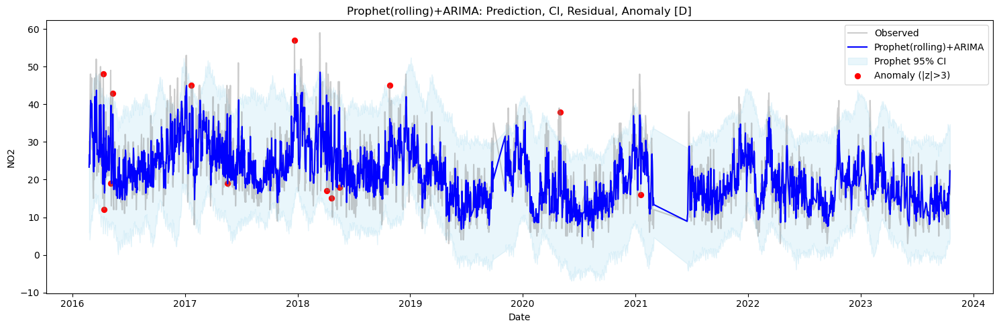

22:11:08 - cmdstanpy - INFO - Chain [1] start processing
22:11:08 - cmdstanpy - INFO - Chain [1] done processing
22:11:09 - cmdstanpy - INFO - Chain [1] start processing
22:11:09 - cmdstanpy - INFO - Chain [1] done processing
22:11:09 - cmdstanpy - INFO - Chain [1] start processing
22:11:09 - cmdstanpy - INFO - Chain [1] done processing
22:11:09 - cmdstanpy - INFO - Chain [1] start processing
22:11:09 - cmdstanpy - INFO - Chain [1] done processing
22:11:09 - cmdstanpy - INFO - Chain [1] start processing
22:11:09 - cmdstanpy - INFO - Chain [1] done processing
22:11:09 - cmdstanpy - INFO - Chain [1] start processing
22:11:09 - cmdstanpy - INFO - Chain [1] done processing
22:11:09 - cmdstanpy - INFO - Chain [1] start processing
22:11:09 - cmdstanpy - INFO - Chain [1] done processing
22:11:10 - cmdstanpy - INFO - Chain [1] start processing
22:11:10 - cmdstanpy - INFO - Chain [1] done processing
22:11:10 - cmdstanpy - INFO - Chain [1] start processing
22:11:10 - cmdstanpy - INFO - Chain [1]

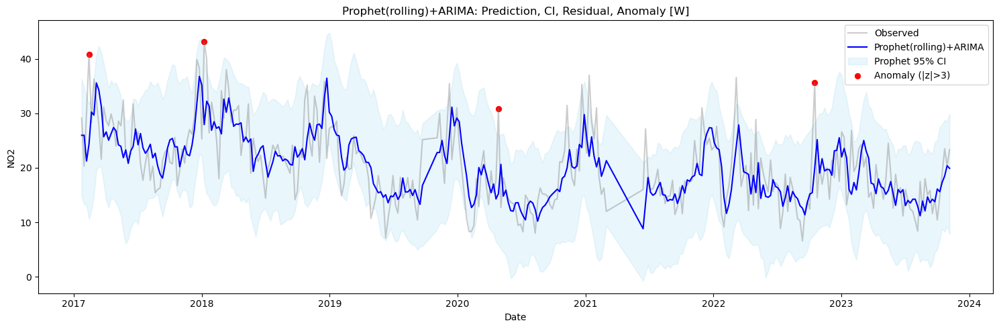

22:11:24 - cmdstanpy - INFO - Chain [1] start processing
22:11:24 - cmdstanpy - INFO - Chain [1] done processing
22:11:24 - cmdstanpy - INFO - Chain [1] start processing
22:11:25 - cmdstanpy - INFO - Chain [1] done processing
22:11:25 - cmdstanpy - INFO - Chain [1] start processing
22:11:25 - cmdstanpy - INFO - Chain [1] done processing
22:11:25 - cmdstanpy - INFO - Chain [1] start processing
22:11:25 - cmdstanpy - INFO - Chain [1] done processing
22:11:25 - cmdstanpy - INFO - Chain [1] start processing
22:11:25 - cmdstanpy - INFO - Chain [1] done processing
22:11:25 - cmdstanpy - INFO - Chain [1] start processing
22:11:26 - cmdstanpy - INFO - Chain [1] done processing
22:11:26 - cmdstanpy - INFO - Chain [1] start processing
22:11:26 - cmdstanpy - INFO - Chain [1] done processing
22:11:26 - cmdstanpy - INFO - Chain [1] start processing
22:11:26 - cmdstanpy - INFO - Chain [1] done processing
22:11:26 - cmdstanpy - INFO - Chain [1] start processing
22:11:26 - cmdstanpy - INFO - Chain [1]

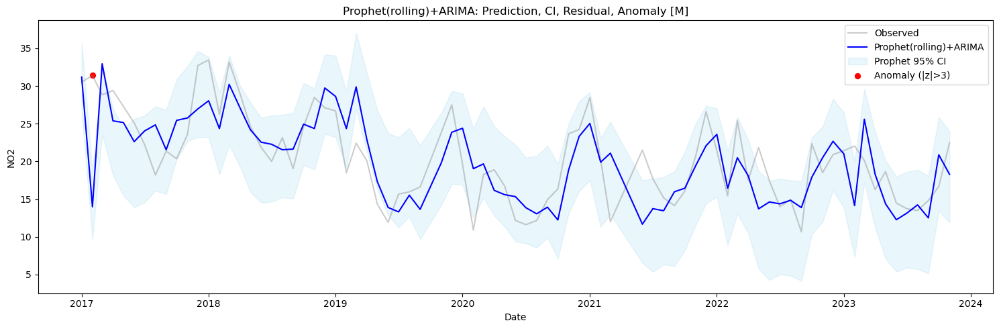

In [11]:
df_chd_daily_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_chd_AQICN, freq='D',pollutant='NO2'), pollutant='NO2',
    train_steps=730, test_steps=30, step=30, z_thresh=3, freq='D', plot=True
)
df_chd_weekly_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_chd_AQICN, freq='W',pollutant='NO2'), pollutant='NO2',
    train_steps=156, test_steps=8, step=4, z_thresh=3, freq='W', plot=True
)
df_chd_monthly_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_chd_AQICN, freq='M',pollutant='NO2'), pollutant='NO2',
    train_steps=36, test_steps=4, step=1, z_thresh=3, freq='M', plot=True
)

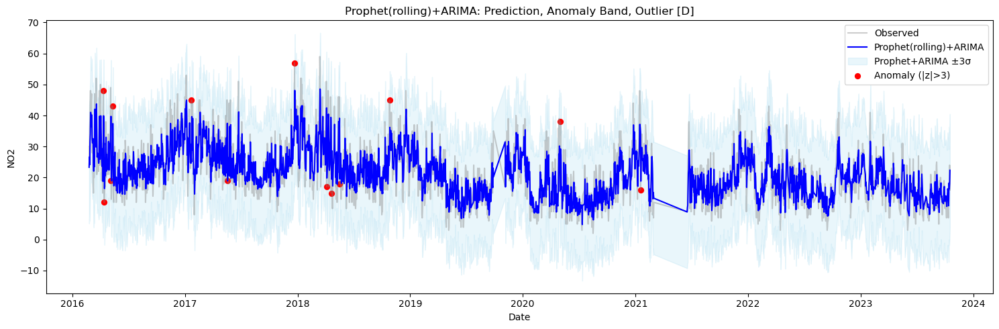

In [12]:
plot_arima_anomaly_band(df_chd_daily_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='D')


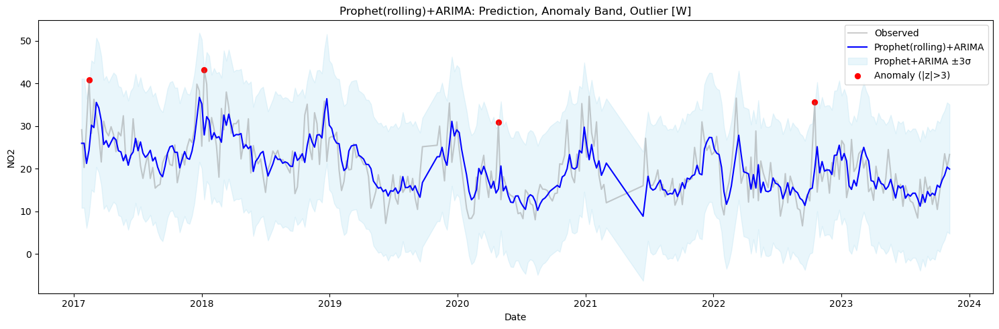

In [13]:
plot_arima_anomaly_band(df_chd_weekly_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='W')


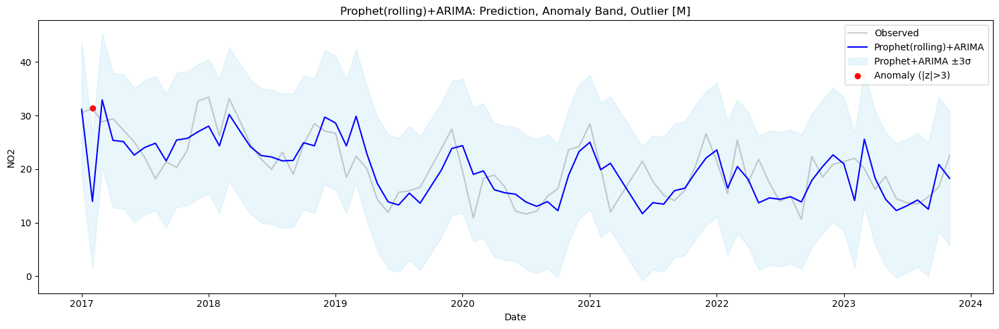

In [14]:
plot_arima_anomaly_band(df_chd_monthly_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='M')


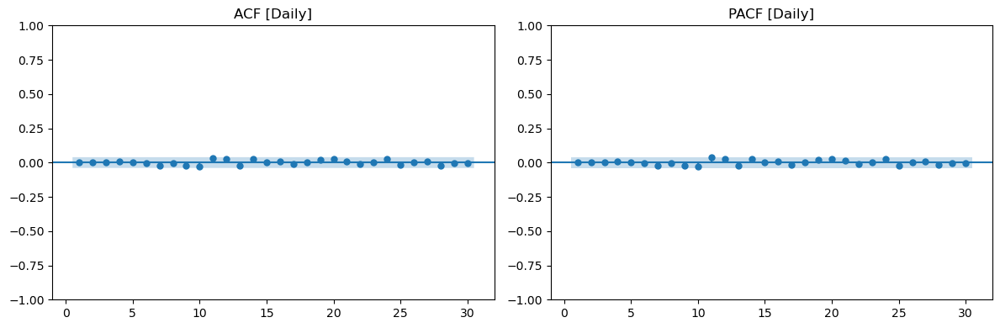

Ljung-Box Test [Daily] (using lags [10, 20, 30]):
      lb_stat  lb_pvalue
10   4.982740   0.892328
20  15.675515   0.736540
30  19.678300   0.924649



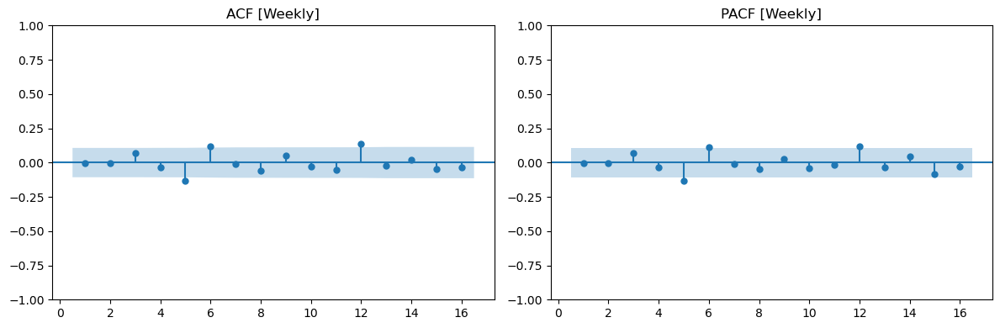

Ljung-Box Test [Weekly] (using lags [8, 12, 16]):
      lb_stat  lb_pvalue
8   14.251466   0.075442
12  23.110220   0.026805
16  24.635285   0.076518



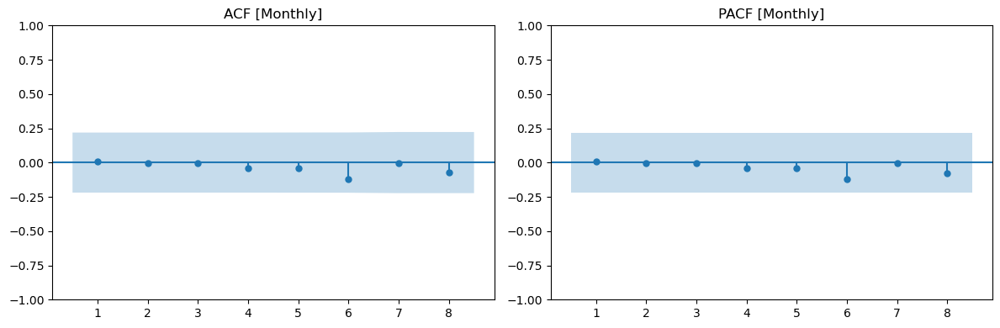

Ljung-Box Test [Monthly] (using lags [4, 8]):
    lb_stat  lb_pvalue
4  0.157821   0.997046
8  2.074414   0.978645



In [15]:
# Daily residual
residual_diagnostics(df_chd_daily_result_aqicn, lags=[10,20,30], title='[Daily]')
# Weekly residual
residual_diagnostics(df_chd_weekly_result_aqicn, lags=[8,12,16], title='[Weekly]')
# Monthly residual
residual_diagnostics(df_chd_monthly_result_aqicn, lags=[4,8], title='[Monthly]')

22:11:52 - cmdstanpy - INFO - Chain [1] start processing
22:11:52 - cmdstanpy - INFO - Chain [1] done processing
22:11:52 - cmdstanpy - INFO - Chain [1] start processing
22:11:52 - cmdstanpy - INFO - Chain [1] done processing
22:11:52 - cmdstanpy - INFO - Chain [1] start processing
22:11:52 - cmdstanpy - INFO - Chain [1] done processing
22:11:53 - cmdstanpy - INFO - Chain [1] start processing
22:11:53 - cmdstanpy - INFO - Chain [1] done processing
22:11:53 - cmdstanpy - INFO - Chain [1] start processing
22:11:53 - cmdstanpy - INFO - Chain [1] done processing
22:11:53 - cmdstanpy - INFO - Chain [1] start processing
22:11:53 - cmdstanpy - INFO - Chain [1] done processing
22:11:53 - cmdstanpy - INFO - Chain [1] start processing
22:11:53 - cmdstanpy - INFO - Chain [1] done processing
22:11:53 - cmdstanpy - INFO - Chain [1] start processing
22:11:54 - cmdstanpy - INFO - Chain [1] done processing
22:11:54 - cmdstanpy - INFO - Chain [1] start processing
22:11:54 - cmdstanpy - INFO - Chain [1]

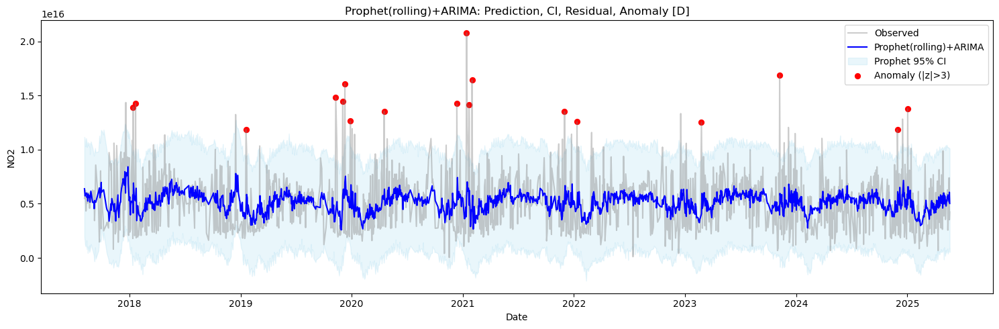

22:12:11 - cmdstanpy - INFO - Chain [1] start processing
22:12:11 - cmdstanpy - INFO - Chain [1] done processing
22:12:11 - cmdstanpy - INFO - Chain [1] start processing
22:12:11 - cmdstanpy - INFO - Chain [1] done processing
22:12:12 - cmdstanpy - INFO - Chain [1] start processing
22:12:12 - cmdstanpy - INFO - Chain [1] done processing
22:12:12 - cmdstanpy - INFO - Chain [1] start processing
22:12:12 - cmdstanpy - INFO - Chain [1] done processing
22:12:12 - cmdstanpy - INFO - Chain [1] start processing
22:12:12 - cmdstanpy - INFO - Chain [1] done processing
22:12:12 - cmdstanpy - INFO - Chain [1] start processing
22:12:12 - cmdstanpy - INFO - Chain [1] done processing
22:12:12 - cmdstanpy - INFO - Chain [1] start processing
22:12:12 - cmdstanpy - INFO - Chain [1] done processing
22:12:12 - cmdstanpy - INFO - Chain [1] start processing
22:12:12 - cmdstanpy - INFO - Chain [1] done processing
22:12:12 - cmdstanpy - INFO - Chain [1] start processing
22:12:13 - cmdstanpy - INFO - Chain [1]

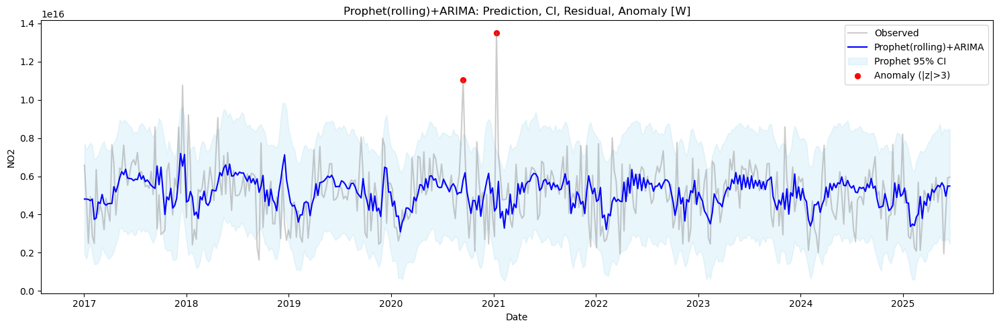

22:12:31 - cmdstanpy - INFO - Chain [1] start processing
22:12:31 - cmdstanpy - INFO - Chain [1] done processing
22:12:31 - cmdstanpy - INFO - Chain [1] start processing
22:12:32 - cmdstanpy - INFO - Chain [1] done processing
22:12:32 - cmdstanpy - INFO - Chain [1] start processing
22:12:32 - cmdstanpy - INFO - Chain [1] done processing
22:12:32 - cmdstanpy - INFO - Chain [1] start processing
22:12:32 - cmdstanpy - INFO - Chain [1] done processing
22:12:32 - cmdstanpy - INFO - Chain [1] start processing
22:12:32 - cmdstanpy - INFO - Chain [1] done processing
22:12:32 - cmdstanpy - INFO - Chain [1] start processing
22:12:33 - cmdstanpy - INFO - Chain [1] done processing
22:12:33 - cmdstanpy - INFO - Chain [1] start processing
22:12:33 - cmdstanpy - INFO - Chain [1] done processing
22:12:33 - cmdstanpy - INFO - Chain [1] start processing
22:12:33 - cmdstanpy - INFO - Chain [1] done processing
22:12:33 - cmdstanpy - INFO - Chain [1] start processing
22:12:33 - cmdstanpy - INFO - Chain [1]

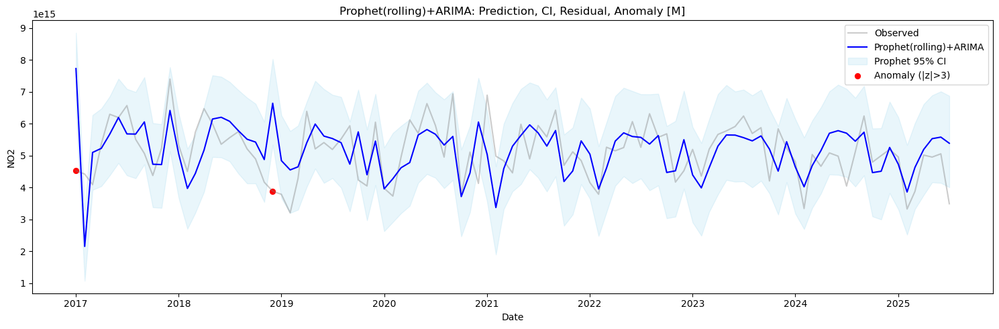

In [16]:
df_chd_daily_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_chd_NASA, freq='D',pollutant='NO2'), pollutant='NO2',
    train_steps=730, test_steps=30, step=30, z_thresh=3, freq='D', plot=True
)
df_chd_weekly_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_chd_NASA, freq='W',pollutant='NO2'), pollutant='NO2',
    train_steps=156, test_steps=8, step=4, z_thresh=3, freq='W', plot=True
)
df_chd_monthly_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_chd_NASA, freq='M',pollutant='NO2'), pollutant='NO2',
    train_steps=36, test_steps=4, step=1, z_thresh=3, freq='M', plot=True
)

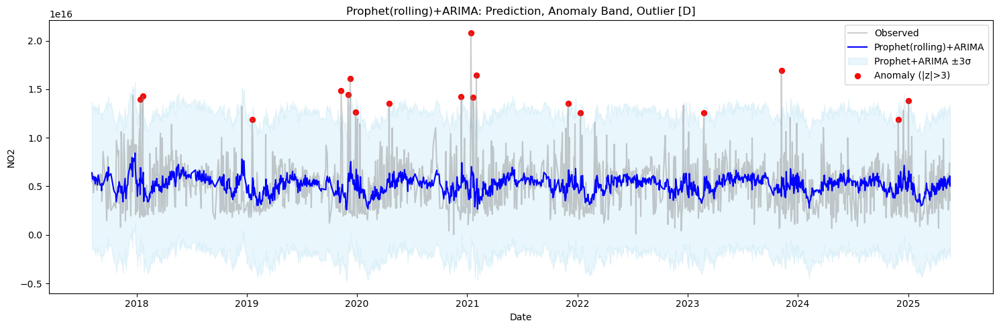

In [17]:
plot_arima_anomaly_band(df_chd_daily_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='D')


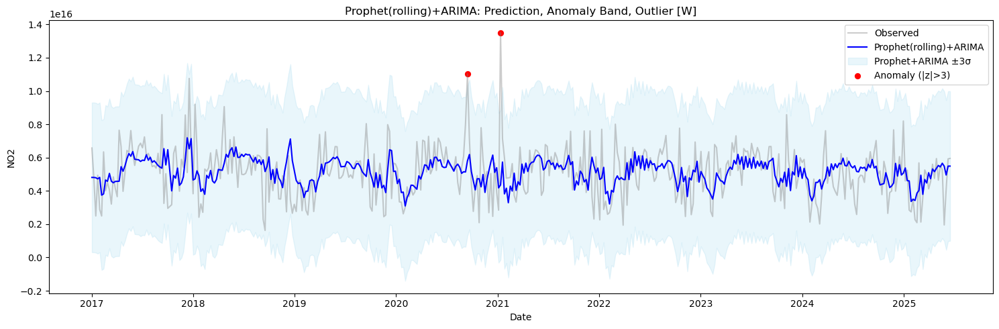

In [18]:
plot_arima_anomaly_band(df_chd_weekly_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='W')


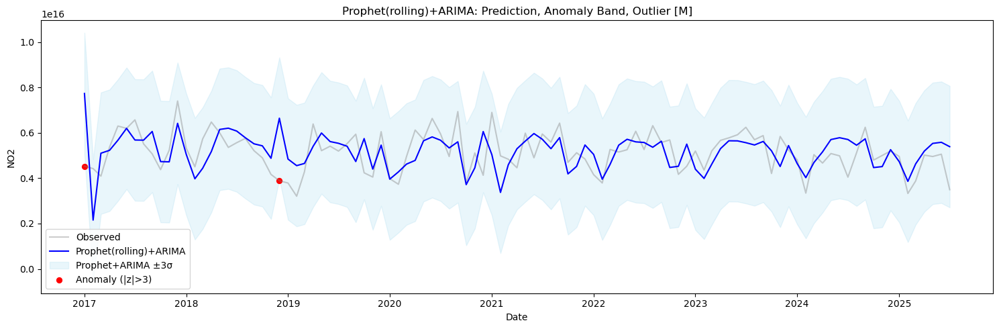

In [19]:
plot_arima_anomaly_band(df_chd_monthly_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='M')


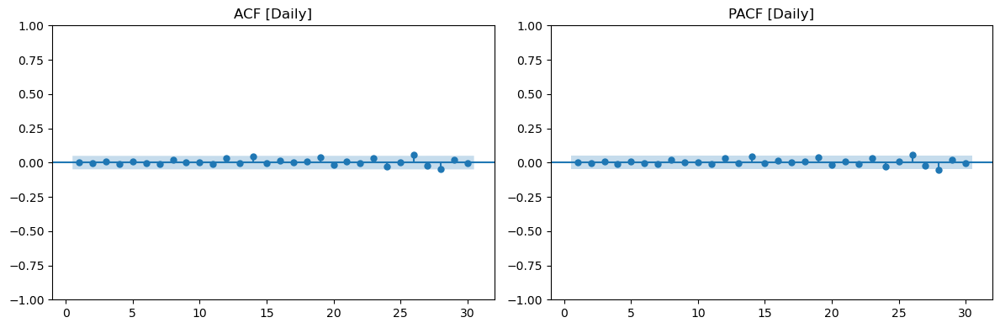

Ljung-Box Test [Daily] (using lags [10, 20, 30]):
      lb_stat  lb_pvalue
10   1.411795   0.999185
20   8.885758   0.984193
30  22.943959   0.817557



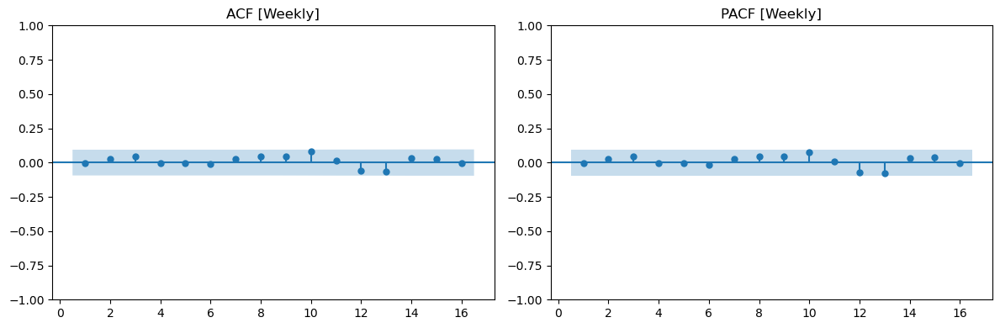

Ljung-Box Test [Weekly] (using lags [8, 12, 16]):
      lb_stat  lb_pvalue
8    2.312080   0.969919
12   7.752251   0.804179
16  10.487590   0.839956



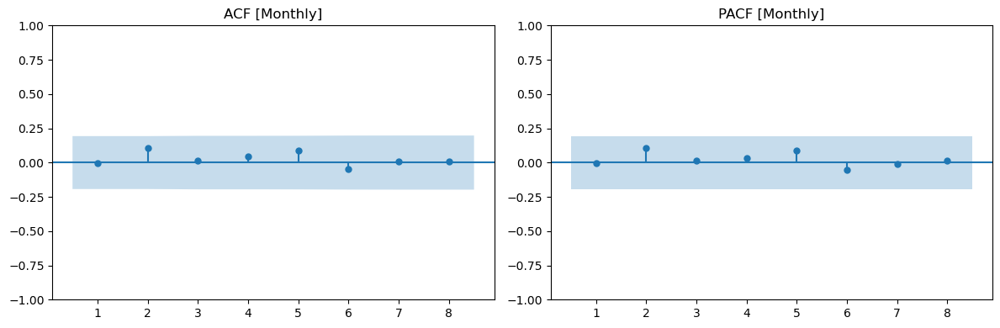

Ljung-Box Test [Monthly] (using lags [4, 8]):
    lb_stat  lb_pvalue
4  1.397665   0.844601
8  2.469735   0.963127



In [20]:
# Daily residual
residual_diagnostics(df_chd_daily_result_nasa, lags=[10,20,30], title='[Daily]')
# Weekly residual
residual_diagnostics(df_chd_weekly_result_nasa, lags=[8,12,16], title='[Weekly]')
# Monthly residual
residual_diagnostics(df_chd_monthly_result_nasa, lags=[4,8], title='[Monthly]')

# Chongqing

In [21]:
df_cqn_AQICN = pd.read_csv("data/aqicn/chongqing.csv")
df_cqn_AQICN = change_df(df_cqn_AQICN)
df_cqn_NASA = pd.read_csv('data/nasa_data/chongqingNO2.csv')
df_cqn_NASA = cleaning_NASA_data(df_cqn_NASA,'NO2')

22:18:51 - cmdstanpy - INFO - Chain [1] start processing
22:18:51 - cmdstanpy - INFO - Chain [1] done processing
22:18:51 - cmdstanpy - INFO - Chain [1] start processing
22:18:51 - cmdstanpy - INFO - Chain [1] done processing
22:18:51 - cmdstanpy - INFO - Chain [1] start processing
22:18:51 - cmdstanpy - INFO - Chain [1] done processing
22:18:52 - cmdstanpy - INFO - Chain [1] start processing
22:18:52 - cmdstanpy - INFO - Chain [1] done processing
22:18:52 - cmdstanpy - INFO - Chain [1] start processing
22:18:52 - cmdstanpy - INFO - Chain [1] done processing
22:18:52 - cmdstanpy - INFO - Chain [1] start processing
22:18:52 - cmdstanpy - INFO - Chain [1] done processing
22:18:52 - cmdstanpy - INFO - Chain [1] start processing
22:18:52 - cmdstanpy - INFO - Chain [1] done processing
22:18:52 - cmdstanpy - INFO - Chain [1] start processing
22:18:52 - cmdstanpy - INFO - Chain [1] done processing
22:18:53 - cmdstanpy - INFO - Chain [1] start processing
22:18:53 - cmdstanpy - INFO - Chain [1]

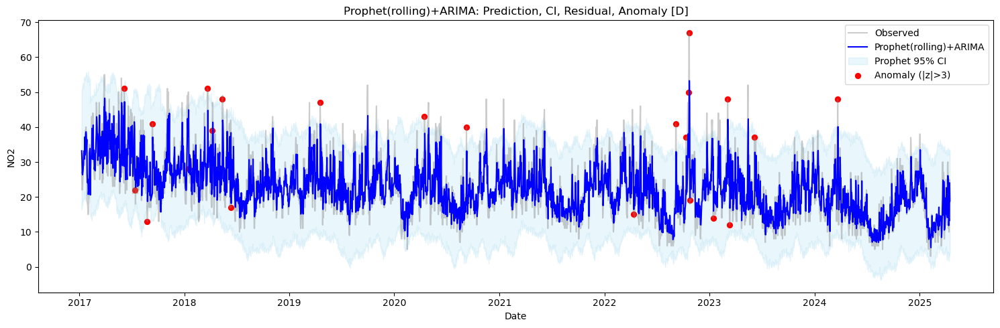

22:19:31 - cmdstanpy - INFO - Chain [1] start processing
22:19:31 - cmdstanpy - INFO - Chain [1] done processing
22:19:32 - cmdstanpy - INFO - Chain [1] start processing
22:19:32 - cmdstanpy - INFO - Chain [1] done processing
22:19:32 - cmdstanpy - INFO - Chain [1] start processing
22:19:32 - cmdstanpy - INFO - Chain [1] done processing
22:19:32 - cmdstanpy - INFO - Chain [1] start processing
22:19:32 - cmdstanpy - INFO - Chain [1] done processing
22:19:32 - cmdstanpy - INFO - Chain [1] start processing
22:19:32 - cmdstanpy - INFO - Chain [1] done processing
22:19:32 - cmdstanpy - INFO - Chain [1] start processing
22:19:32 - cmdstanpy - INFO - Chain [1] done processing
22:19:32 - cmdstanpy - INFO - Chain [1] start processing
22:19:32 - cmdstanpy - INFO - Chain [1] done processing
22:19:33 - cmdstanpy - INFO - Chain [1] start processing
22:19:33 - cmdstanpy - INFO - Chain [1] done processing
22:19:33 - cmdstanpy - INFO - Chain [1] start processing
22:19:33 - cmdstanpy - INFO - Chain [1]

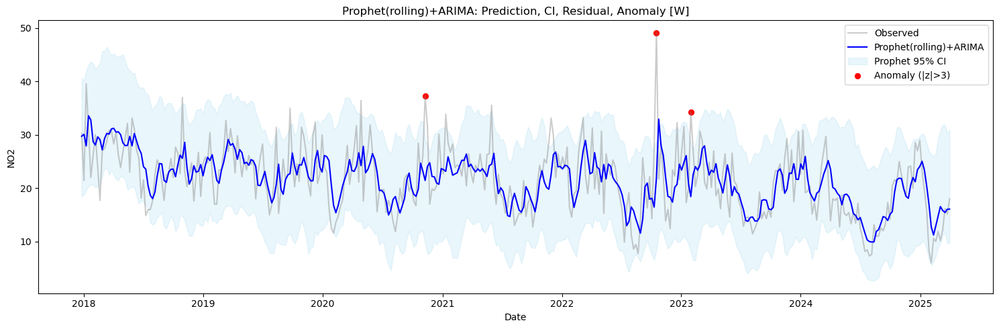

22:19:49 - cmdstanpy - INFO - Chain [1] start processing
22:19:49 - cmdstanpy - INFO - Chain [1] done processing
22:19:49 - cmdstanpy - INFO - Chain [1] start processing
22:19:49 - cmdstanpy - INFO - Chain [1] done processing
22:19:49 - cmdstanpy - INFO - Chain [1] start processing
22:19:49 - cmdstanpy - INFO - Chain [1] done processing
22:19:50 - cmdstanpy - INFO - Chain [1] start processing
22:19:50 - cmdstanpy - INFO - Chain [1] done processing
22:19:50 - cmdstanpy - INFO - Chain [1] start processing
22:19:50 - cmdstanpy - INFO - Chain [1] done processing
22:19:50 - cmdstanpy - INFO - Chain [1] start processing
22:19:50 - cmdstanpy - INFO - Chain [1] done processing
22:19:50 - cmdstanpy - INFO - Chain [1] start processing
22:19:51 - cmdstanpy - INFO - Chain [1] done processing
22:19:51 - cmdstanpy - INFO - Chain [1] start processing
22:19:51 - cmdstanpy - INFO - Chain [1] done processing
22:19:51 - cmdstanpy - INFO - Chain [1] start processing
22:19:51 - cmdstanpy - INFO - Chain [1]

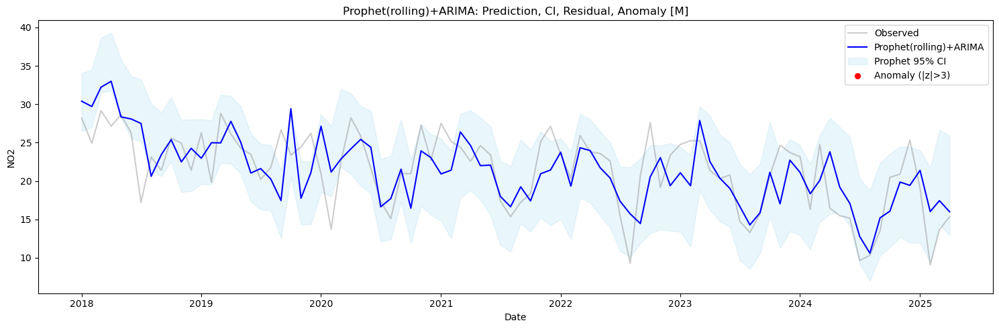

In [22]:
df_cqn_daily_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_cqn_AQICN, freq='D',pollutant='NO2'), pollutant='NO2',
    train_steps=730, test_steps=30, step=30, z_thresh=3, freq='D', plot=True
)
df_cqn_weekly_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_cqn_AQICN, freq='W',pollutant='NO2'), pollutant='NO2',
    train_steps=156, test_steps=8, step=4, z_thresh=3, freq='W', plot=True
)
df_cqn_monthly_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_cqn_AQICN, freq='M',pollutant='NO2'), pollutant='NO2',
    train_steps=36, test_steps=4, step=1, z_thresh=3, freq='M', plot=True
)

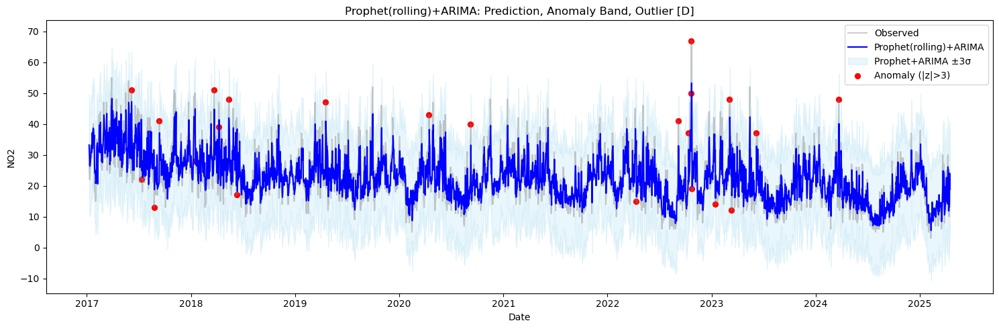

In [23]:
plot_arima_anomaly_band(df_cqn_daily_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='D')


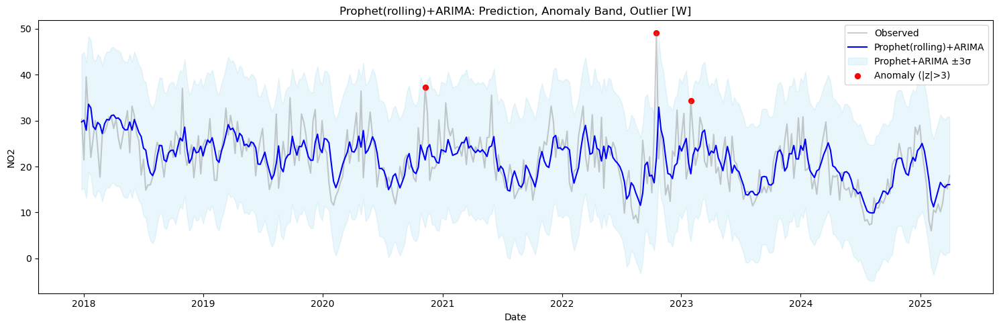

In [24]:
plot_arima_anomaly_band(df_cqn_weekly_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='W')


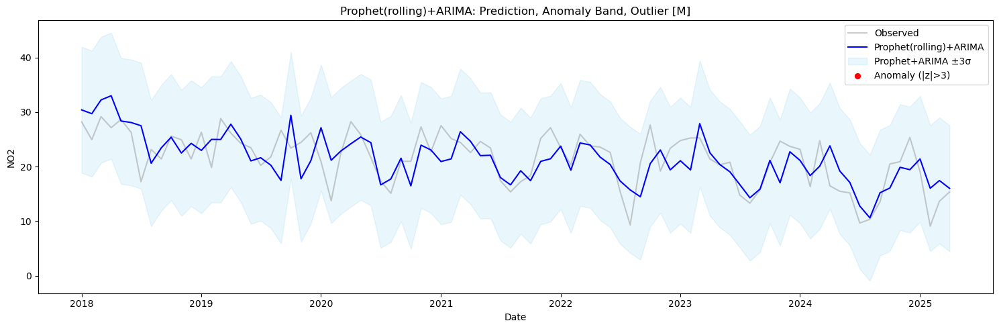

In [25]:
plot_arima_anomaly_band(df_cqn_monthly_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='M')


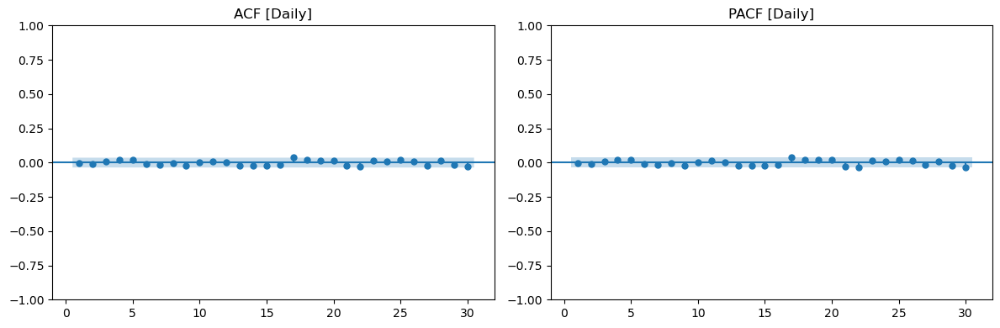

Ljung-Box Test [Daily] (using lags [10, 20, 30]):
      lb_stat  lb_pvalue
10   4.939891   0.895157
20  18.202562   0.574066
30  29.635180   0.484447



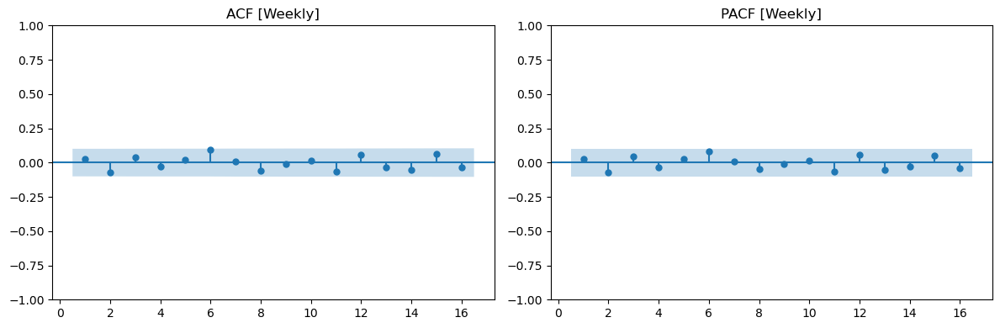

Ljung-Box Test [Weekly] (using lags [8, 12, 16]):
      lb_stat  lb_pvalue
8    7.978770   0.435547
12  11.020539   0.527159
16  14.757054   0.542499



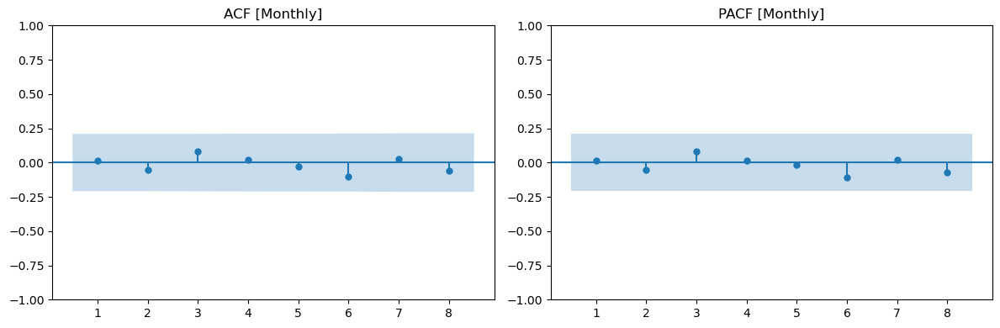

Ljung-Box Test [Monthly] (using lags [4, 8]):
    lb_stat  lb_pvalue
4  0.962359   0.915449
8  2.514716   0.961041



In [26]:
# Daily residual
residual_diagnostics(df_cqn_daily_result_aqicn, lags=[10,20,30], title='[Daily]')
# Weekly residual
residual_diagnostics(df_cqn_weekly_result_aqicn, lags=[8,12,16], title='[Weekly]')
# Monthly residual
residual_diagnostics(df_cqn_monthly_result_aqicn, lags=[4,8], title='[Monthly]')

22:20:15 - cmdstanpy - INFO - Chain [1] start processing
22:20:15 - cmdstanpy - INFO - Chain [1] done processing
22:20:15 - cmdstanpy - INFO - Chain [1] start processing
22:20:15 - cmdstanpy - INFO - Chain [1] done processing
22:20:15 - cmdstanpy - INFO - Chain [1] start processing
22:20:15 - cmdstanpy - INFO - Chain [1] done processing
22:20:16 - cmdstanpy - INFO - Chain [1] start processing
22:20:16 - cmdstanpy - INFO - Chain [1] done processing
22:20:16 - cmdstanpy - INFO - Chain [1] start processing
22:20:16 - cmdstanpy - INFO - Chain [1] done processing
22:20:16 - cmdstanpy - INFO - Chain [1] start processing
22:20:16 - cmdstanpy - INFO - Chain [1] done processing
22:20:16 - cmdstanpy - INFO - Chain [1] start processing
22:20:16 - cmdstanpy - INFO - Chain [1] done processing
22:20:17 - cmdstanpy - INFO - Chain [1] start processing
22:20:17 - cmdstanpy - INFO - Chain [1] done processing
22:20:17 - cmdstanpy - INFO - Chain [1] start processing
22:20:17 - cmdstanpy - INFO - Chain [1]

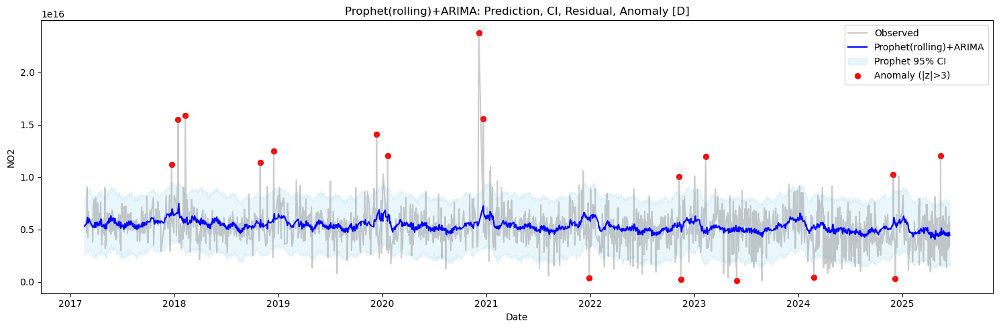

22:20:36 - cmdstanpy - INFO - Chain [1] start processing
22:20:36 - cmdstanpy - INFO - Chain [1] done processing
22:20:36 - cmdstanpy - INFO - Chain [1] start processing
22:20:37 - cmdstanpy - INFO - Chain [1] done processing
22:20:37 - cmdstanpy - INFO - Chain [1] start processing
22:20:37 - cmdstanpy - INFO - Chain [1] done processing
22:20:37 - cmdstanpy - INFO - Chain [1] start processing
22:20:37 - cmdstanpy - INFO - Chain [1] done processing
22:20:37 - cmdstanpy - INFO - Chain [1] start processing
22:20:37 - cmdstanpy - INFO - Chain [1] done processing
22:20:37 - cmdstanpy - INFO - Chain [1] start processing
22:20:37 - cmdstanpy - INFO - Chain [1] done processing
22:20:37 - cmdstanpy - INFO - Chain [1] start processing
22:20:37 - cmdstanpy - INFO - Chain [1] done processing
22:20:37 - cmdstanpy - INFO - Chain [1] start processing
22:20:37 - cmdstanpy - INFO - Chain [1] done processing
22:20:38 - cmdstanpy - INFO - Chain [1] start processing
22:20:38 - cmdstanpy - INFO - Chain [1]

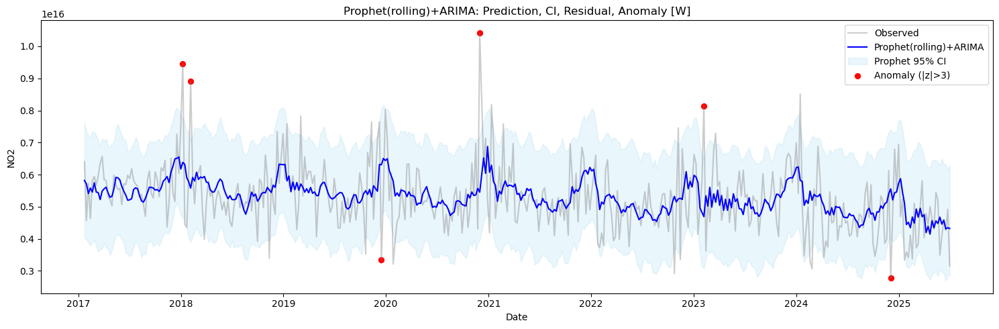

22:20:58 - cmdstanpy - INFO - Chain [1] start processing
22:20:59 - cmdstanpy - INFO - Chain [1] done processing
22:20:59 - cmdstanpy - INFO - Chain [1] start processing
22:20:59 - cmdstanpy - INFO - Chain [1] done processing
22:20:59 - cmdstanpy - INFO - Chain [1] start processing
22:20:59 - cmdstanpy - INFO - Chain [1] done processing
22:20:59 - cmdstanpy - INFO - Chain [1] start processing
22:20:59 - cmdstanpy - INFO - Chain [1] done processing
22:21:00 - cmdstanpy - INFO - Chain [1] start processing
22:21:00 - cmdstanpy - INFO - Chain [1] done processing
22:21:00 - cmdstanpy - INFO - Chain [1] start processing
22:21:00 - cmdstanpy - INFO - Chain [1] done processing
22:21:00 - cmdstanpy - INFO - Chain [1] start processing
22:21:00 - cmdstanpy - INFO - Chain [1] done processing
22:21:00 - cmdstanpy - INFO - Chain [1] start processing
22:21:01 - cmdstanpy - INFO - Chain [1] done processing
22:21:01 - cmdstanpy - INFO - Chain [1] start processing
22:21:01 - cmdstanpy - INFO - Chain [1]

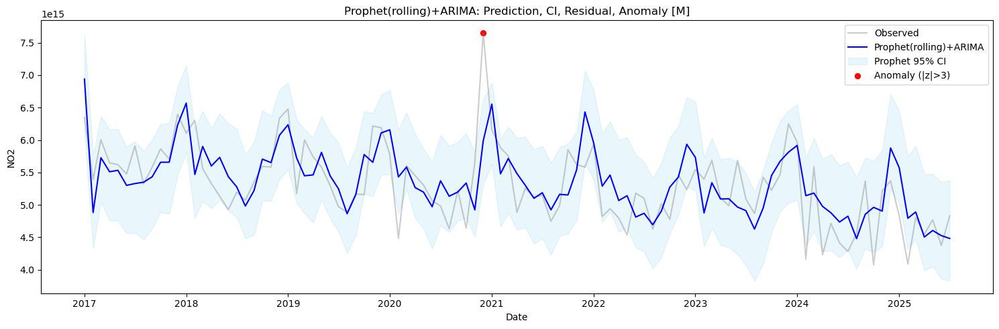

In [27]:
df_cqn_daily_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_cqn_NASA, freq='D',pollutant='NO2'), pollutant='NO2',
    train_steps=730, test_steps=30, step=30, z_thresh=3, freq='D', plot=True
)
df_cqn_weekly_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_cqn_NASA, freq='W',pollutant='NO2'), pollutant='NO2',
    train_steps=156, test_steps=8, step=4, z_thresh=3, freq='W', plot=True
)
df_cqn_monthly_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_cqn_NASA, freq='M',pollutant='NO2'), pollutant='NO2',
    train_steps=36, test_steps=4, step=1, z_thresh=3, freq='M', plot=True
)

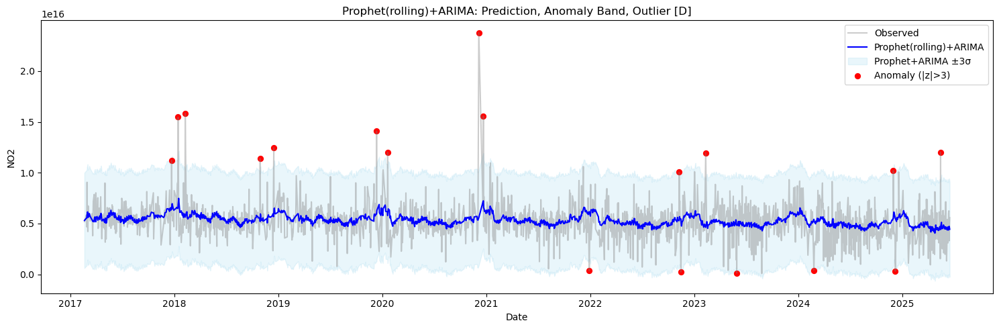

In [28]:
plot_arima_anomaly_band(df_cqn_daily_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='D')


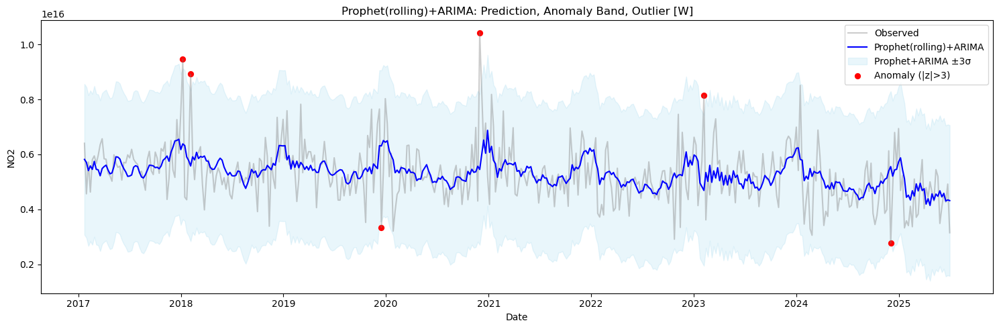

In [29]:
plot_arima_anomaly_band(df_cqn_weekly_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='W')


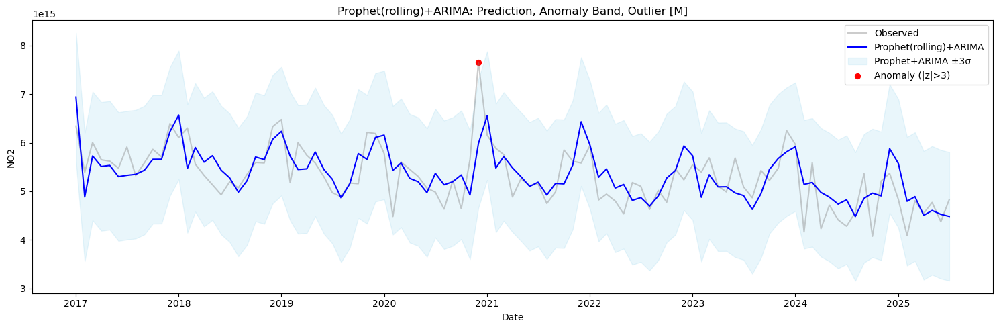

In [30]:
plot_arima_anomaly_band(df_cqn_monthly_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='M')


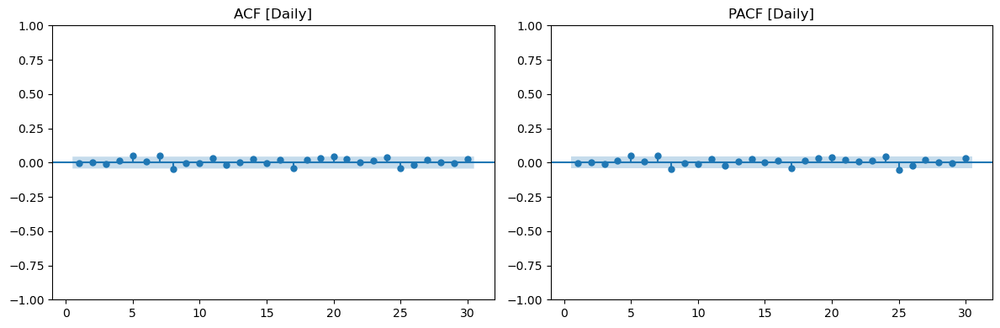

Ljung-Box Test [Daily] (using lags [10, 20, 30]):
      lb_stat  lb_pvalue
10  16.760523   0.079834
20  31.563624   0.048176
30  43.418328   0.053798



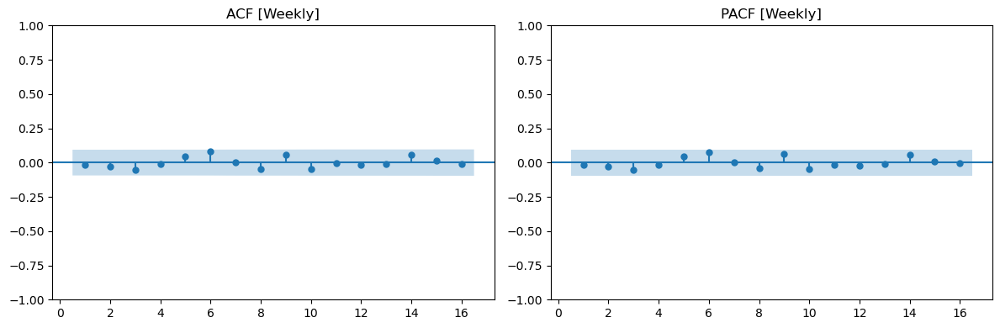

Ljung-Box Test [Weekly] (using lags [8, 12, 16]):
      lb_stat  lb_pvalue
8    6.578494   0.582715
12   9.176805   0.687759
16  10.916942   0.814583



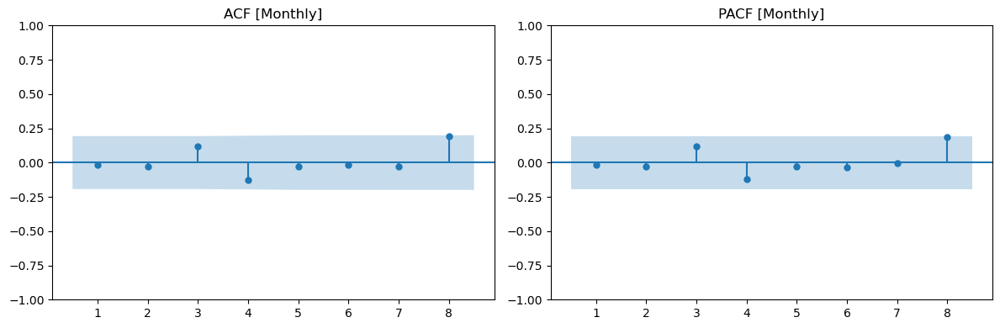

Ljung-Box Test [Monthly] (using lags [4, 8]):
    lb_stat  lb_pvalue
4  3.317771   0.506122
8  7.731508   0.460127



In [31]:
# Daily residual
residual_diagnostics(df_cqn_daily_result_nasa, lags=[10,20,30], title='[Daily]')
# Weekly residual
residual_diagnostics(df_cqn_weekly_result_nasa, lags=[8,12,16], title='[Weekly]')
# Monthly residual
residual_diagnostics(df_cqn_monthly_result_nasa, lags=[4,8], title='[Monthly]')

# Guangzhou

In [32]:
df_ggu_AQICN = pd.read_csv("data/aqicn/guangzhou.csv")
df_ggu_AQICN = change_df(df_ggu_AQICN)
df_ggu_NASA = pd.read_csv('data/nasa_data/guangzhouNO2.csv')
df_ggu_NASA = cleaning_NASA_data(df_ggu_NASA,'NO2')

22:21:59 - cmdstanpy - INFO - Chain [1] start processing
22:21:59 - cmdstanpy - INFO - Chain [1] done processing
22:21:59 - cmdstanpy - INFO - Chain [1] start processing
22:21:59 - cmdstanpy - INFO - Chain [1] done processing
22:21:59 - cmdstanpy - INFO - Chain [1] start processing
22:21:59 - cmdstanpy - INFO - Chain [1] done processing
22:21:59 - cmdstanpy - INFO - Chain [1] start processing
22:21:59 - cmdstanpy - INFO - Chain [1] done processing
22:21:59 - cmdstanpy - INFO - Chain [1] start processing
22:22:00 - cmdstanpy - INFO - Chain [1] done processing
22:22:00 - cmdstanpy - INFO - Chain [1] start processing
22:22:00 - cmdstanpy - INFO - Chain [1] done processing
22:22:00 - cmdstanpy - INFO - Chain [1] start processing
22:22:00 - cmdstanpy - INFO - Chain [1] done processing
22:22:00 - cmdstanpy - INFO - Chain [1] start processing
22:22:00 - cmdstanpy - INFO - Chain [1] done processing
22:22:00 - cmdstanpy - INFO - Chain [1] start processing
22:22:00 - cmdstanpy - INFO - Chain [1]

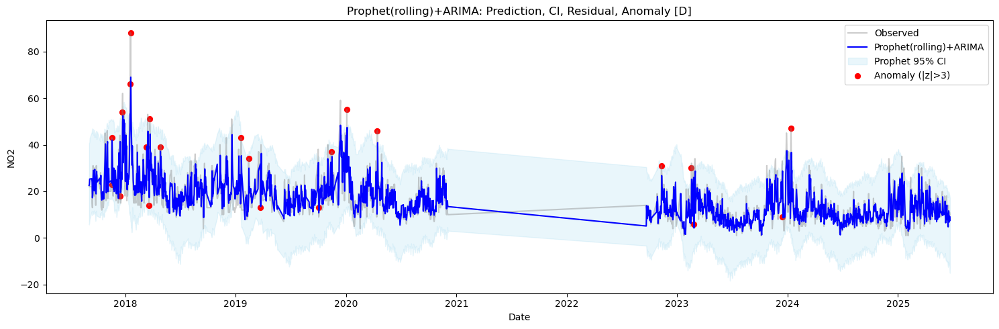

22:22:22 - cmdstanpy - INFO - Chain [1] start processing
22:22:22 - cmdstanpy - INFO - Chain [1] done processing
22:22:22 - cmdstanpy - INFO - Chain [1] start processing
22:22:22 - cmdstanpy - INFO - Chain [1] done processing
22:22:22 - cmdstanpy - INFO - Chain [1] start processing
22:22:22 - cmdstanpy - INFO - Chain [1] done processing
22:22:22 - cmdstanpy - INFO - Chain [1] start processing
22:22:22 - cmdstanpy - INFO - Chain [1] done processing
22:22:22 - cmdstanpy - INFO - Chain [1] start processing
22:22:22 - cmdstanpy - INFO - Chain [1] done processing
22:22:22 - cmdstanpy - INFO - Chain [1] start processing
22:22:22 - cmdstanpy - INFO - Chain [1] done processing
22:22:23 - cmdstanpy - INFO - Chain [1] start processing
22:22:23 - cmdstanpy - INFO - Chain [1] done processing
22:22:23 - cmdstanpy - INFO - Chain [1] start processing
22:22:23 - cmdstanpy - INFO - Chain [1] done processing
22:22:23 - cmdstanpy - INFO - Chain [1] start processing
22:22:23 - cmdstanpy - INFO - Chain [1]

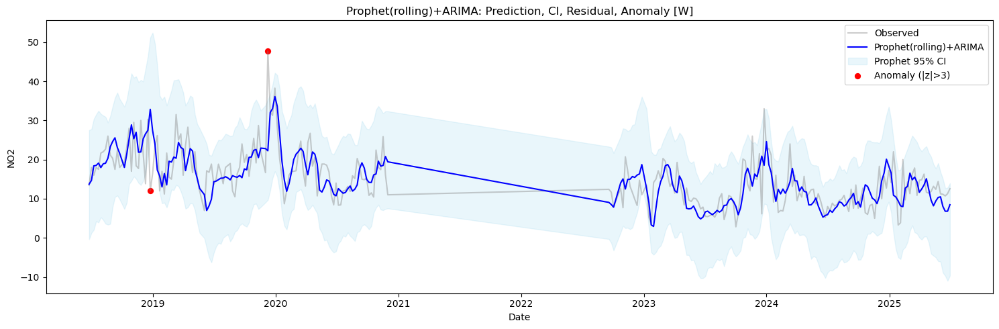

22:22:36 - cmdstanpy - INFO - Chain [1] start processing
22:22:36 - cmdstanpy - INFO - Chain [1] done processing
22:22:36 - cmdstanpy - INFO - Chain [1] start processing
22:22:36 - cmdstanpy - INFO - Chain [1] done processing
22:22:36 - cmdstanpy - INFO - Chain [1] start processing
22:22:36 - cmdstanpy - INFO - Chain [1] done processing
22:22:36 - cmdstanpy - INFO - Chain [1] start processing
22:22:37 - cmdstanpy - INFO - Chain [1] done processing
22:22:37 - cmdstanpy - INFO - Chain [1] start processing
22:22:37 - cmdstanpy - INFO - Chain [1] done processing
22:22:37 - cmdstanpy - INFO - Chain [1] start processing
22:22:37 - cmdstanpy - INFO - Chain [1] done processing
22:22:37 - cmdstanpy - INFO - Chain [1] start processing
22:22:38 - cmdstanpy - INFO - Chain [1] done processing
22:22:38 - cmdstanpy - INFO - Chain [1] start processing
22:22:38 - cmdstanpy - INFO - Chain [1] done processing
22:22:38 - cmdstanpy - INFO - Chain [1] start processing
22:22:38 - cmdstanpy - INFO - Chain [1]

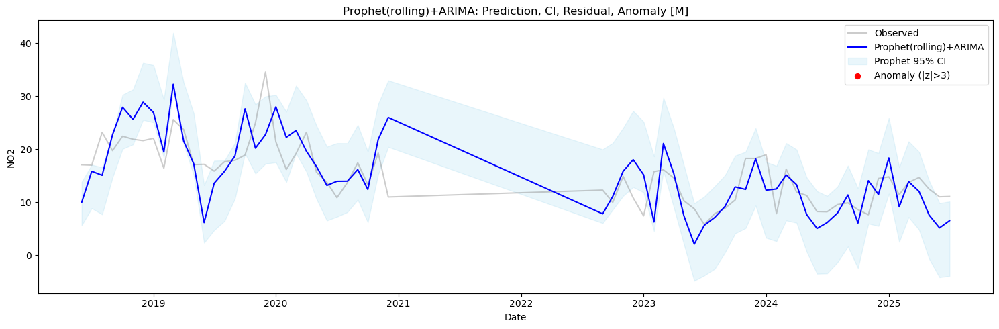

In [33]:
df_ggu_daily_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_ggu_AQICN, freq='D',pollutant='NO2'), pollutant='NO2',
    train_steps=730, test_steps=30, step=30, z_thresh=3, freq='D', plot=True
)
df_ggu_weekly_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_ggu_AQICN, freq='W',pollutant='NO2'), pollutant='NO2',
    train_steps=156, test_steps=8, step=4, z_thresh=3, freq='W', plot=True
)
df_ggu_monthly_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_ggu_AQICN, freq='M',pollutant='NO2'), pollutant='NO2',
    train_steps=36, test_steps=4, step=1, z_thresh=3, freq='M', plot=True
)

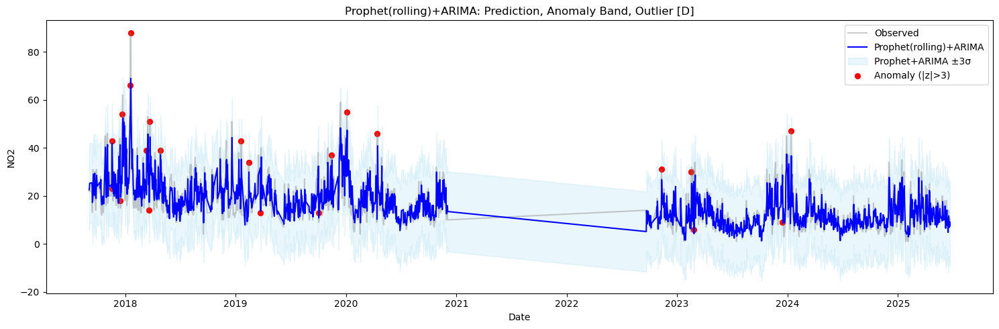

In [34]:
plot_arima_anomaly_band(df_ggu_daily_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='D')

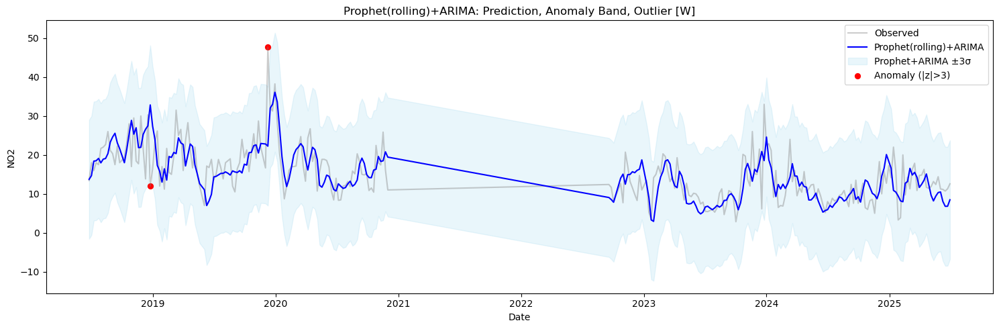

In [35]:
plot_arima_anomaly_band(df_ggu_weekly_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='W')


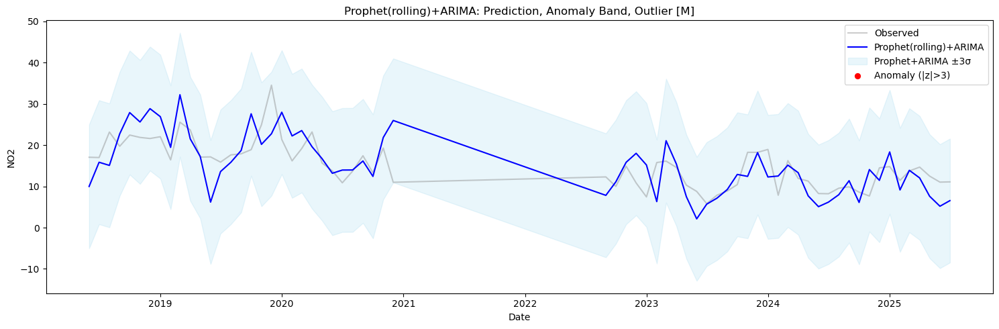

In [36]:
plot_arima_anomaly_band(df_ggu_monthly_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='M')


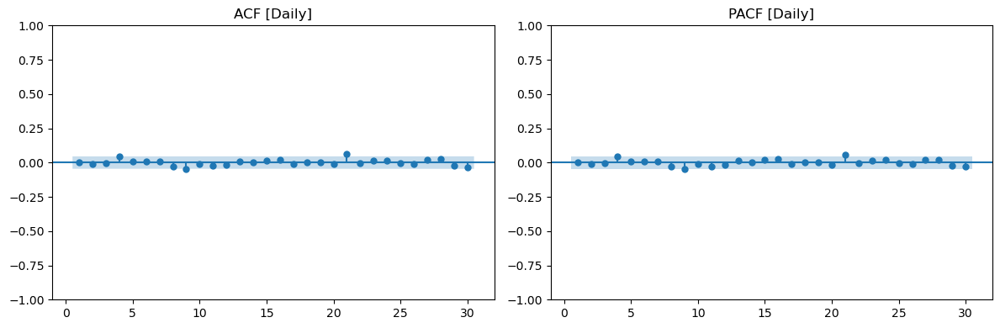

Ljung-Box Test [Daily] (using lags [10, 20, 30]):
      lb_stat  lb_pvalue
10  10.243435   0.419402
20  13.941155   0.833467
30  27.238624   0.610715



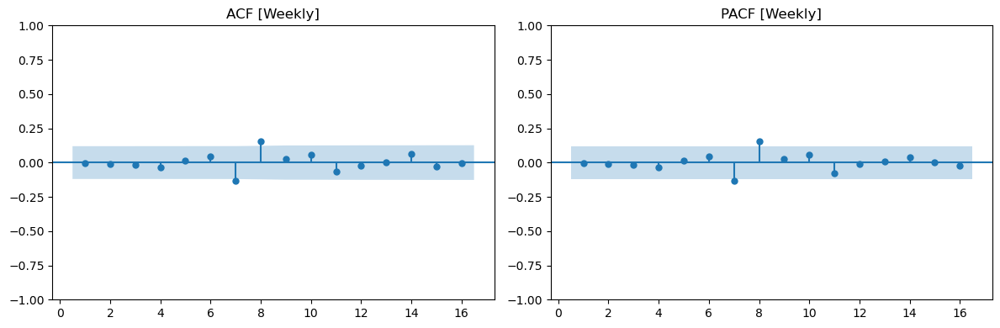

Ljung-Box Test [Weekly] (using lags [8, 12, 16]):
      lb_stat  lb_pvalue
8   12.414620   0.133641
12  14.926728   0.245468
16  16.369153   0.427507



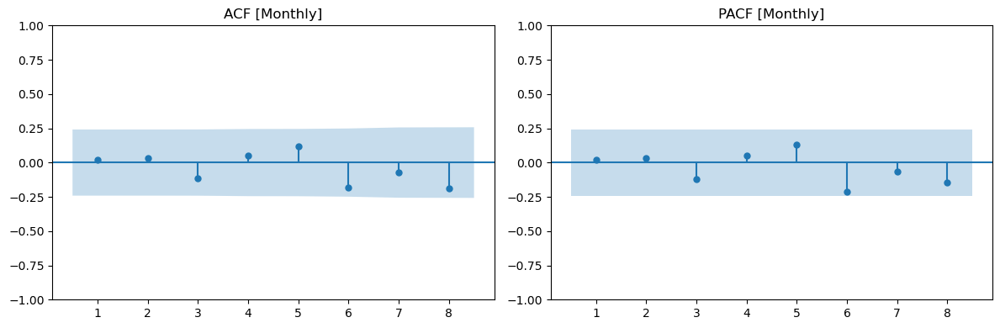

Ljung-Box Test [Monthly] (using lags [4, 8]):
    lb_stat  lb_pvalue
4  1.263515   0.867535
8  7.966029   0.436796



In [37]:
# Daily residual
residual_diagnostics(df_ggu_daily_result_aqicn, lags=[10,20,30], title='[Daily]')
# Weekly residual
residual_diagnostics(df_ggu_weekly_result_aqicn, lags=[8,12,16], title='[Weekly]')
# Monthly residual
residual_diagnostics(df_ggu_monthly_result_aqicn, lags=[4,8], title='[Monthly]')

22:23:00 - cmdstanpy - INFO - Chain [1] start processing
22:23:00 - cmdstanpy - INFO - Chain [1] done processing
22:23:00 - cmdstanpy - INFO - Chain [1] start processing
22:23:00 - cmdstanpy - INFO - Chain [1] done processing
22:23:00 - cmdstanpy - INFO - Chain [1] start processing
22:23:00 - cmdstanpy - INFO - Chain [1] done processing
22:23:00 - cmdstanpy - INFO - Chain [1] start processing
22:23:00 - cmdstanpy - INFO - Chain [1] done processing
22:23:00 - cmdstanpy - INFO - Chain [1] start processing
22:23:01 - cmdstanpy - INFO - Chain [1] done processing
22:23:01 - cmdstanpy - INFO - Chain [1] start processing
22:23:01 - cmdstanpy - INFO - Chain [1] done processing
22:23:01 - cmdstanpy - INFO - Chain [1] start processing
22:23:01 - cmdstanpy - INFO - Chain [1] done processing
22:23:01 - cmdstanpy - INFO - Chain [1] start processing
22:23:01 - cmdstanpy - INFO - Chain [1] done processing
22:23:01 - cmdstanpy - INFO - Chain [1] start processing
22:23:01 - cmdstanpy - INFO - Chain [1]

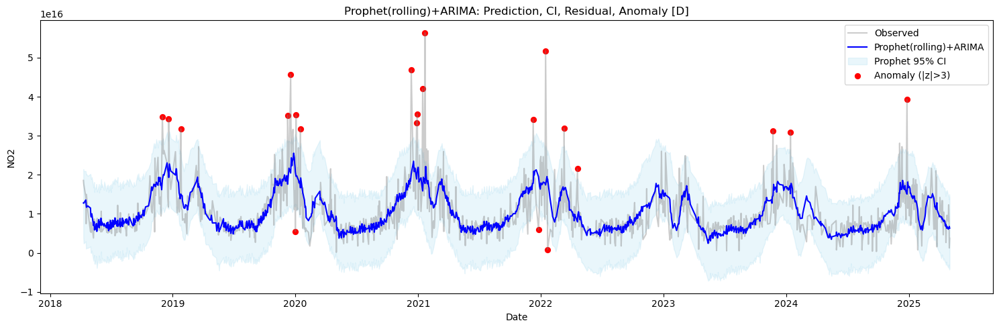

22:23:12 - cmdstanpy - INFO - Chain [1] start processing
22:23:13 - cmdstanpy - INFO - Chain [1] done processing
22:23:13 - cmdstanpy - INFO - Chain [1] start processing
22:23:13 - cmdstanpy - INFO - Chain [1] done processing
22:23:13 - cmdstanpy - INFO - Chain [1] start processing
22:23:13 - cmdstanpy - INFO - Chain [1] done processing
22:23:13 - cmdstanpy - INFO - Chain [1] start processing
22:23:13 - cmdstanpy - INFO - Chain [1] done processing
22:23:13 - cmdstanpy - INFO - Chain [1] start processing
22:23:13 - cmdstanpy - INFO - Chain [1] done processing
22:23:13 - cmdstanpy - INFO - Chain [1] start processing
22:23:13 - cmdstanpy - INFO - Chain [1] done processing
22:23:14 - cmdstanpy - INFO - Chain [1] start processing
22:23:14 - cmdstanpy - INFO - Chain [1] done processing
22:23:14 - cmdstanpy - INFO - Chain [1] start processing
22:23:14 - cmdstanpy - INFO - Chain [1] done processing
22:23:14 - cmdstanpy - INFO - Chain [1] start processing
22:23:14 - cmdstanpy - INFO - Chain [1]

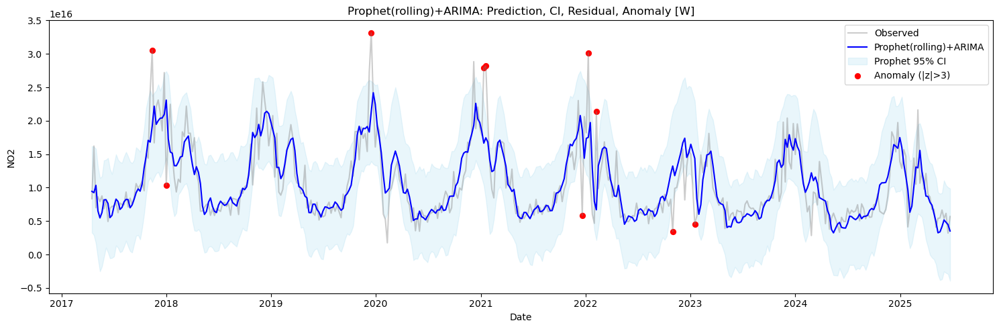

22:23:31 - cmdstanpy - INFO - Chain [1] start processing
22:23:31 - cmdstanpy - INFO - Chain [1] done processing
22:23:31 - cmdstanpy - INFO - Chain [1] start processing
22:23:32 - cmdstanpy - INFO - Chain [1] done processing
22:23:32 - cmdstanpy - INFO - Chain [1] start processing
22:23:32 - cmdstanpy - INFO - Chain [1] done processing
22:23:32 - cmdstanpy - INFO - Chain [1] start processing
22:23:32 - cmdstanpy - INFO - Chain [1] done processing
22:23:32 - cmdstanpy - INFO - Chain [1] start processing
22:23:33 - cmdstanpy - INFO - Chain [1] done processing
22:23:33 - cmdstanpy - INFO - Chain [1] start processing
22:23:33 - cmdstanpy - INFO - Chain [1] done processing
22:23:33 - cmdstanpy - INFO - Chain [1] start processing
22:23:33 - cmdstanpy - INFO - Chain [1] done processing
22:23:33 - cmdstanpy - INFO - Chain [1] start processing
22:23:34 - cmdstanpy - INFO - Chain [1] done processing
22:23:34 - cmdstanpy - INFO - Chain [1] start processing
22:23:34 - cmdstanpy - INFO - Chain [1]

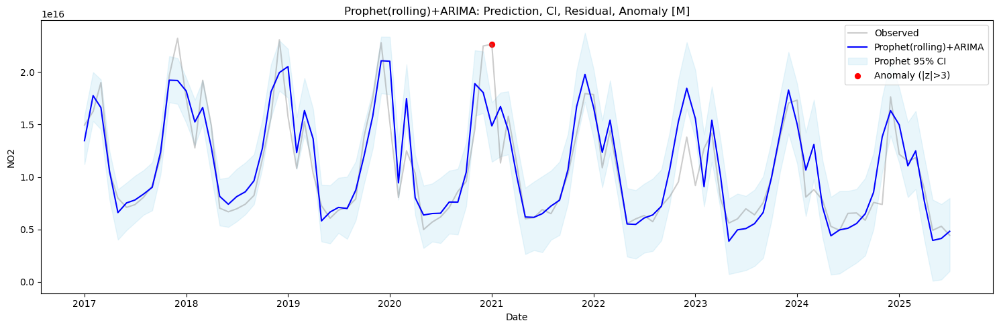

In [38]:
df_ggu_daily_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_ggu_NASA, freq='D',pollutant='NO2'), pollutant='NO2',
    train_steps=730, test_steps=30, step=30, z_thresh=3, freq='D', plot=True
)
df_ggu_weekly_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_ggu_NASA, freq='W',pollutant='NO2'), pollutant='NO2',
    train_steps=156, test_steps=8, step=4, z_thresh=3, freq='W', plot=True
)
df_ggu_monthly_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_ggu_NASA, freq='M',pollutant='NO2'), pollutant='NO2',
    train_steps=36, test_steps=4, step=1, z_thresh=3, freq='M', plot=True
)

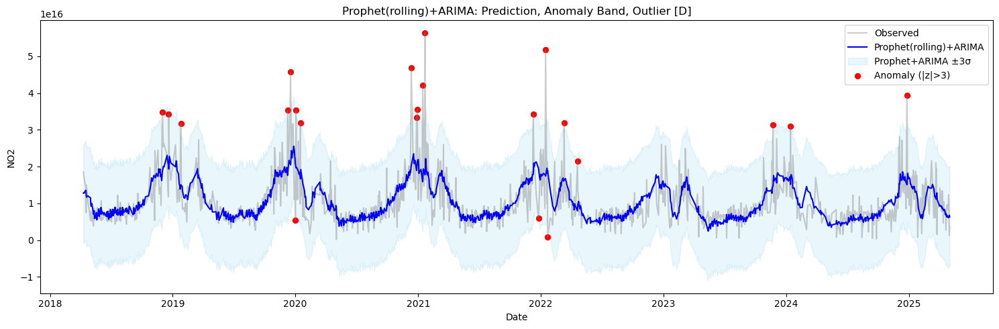

In [39]:
plot_arima_anomaly_band(df_ggu_daily_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='D')


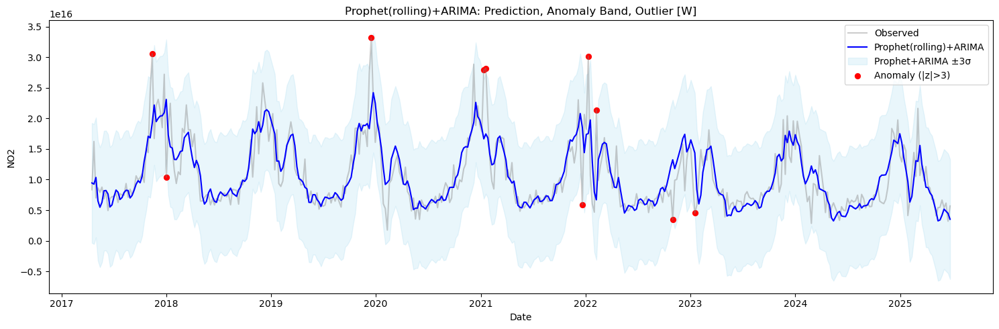

In [40]:
plot_arima_anomaly_band(df_ggu_weekly_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='W')


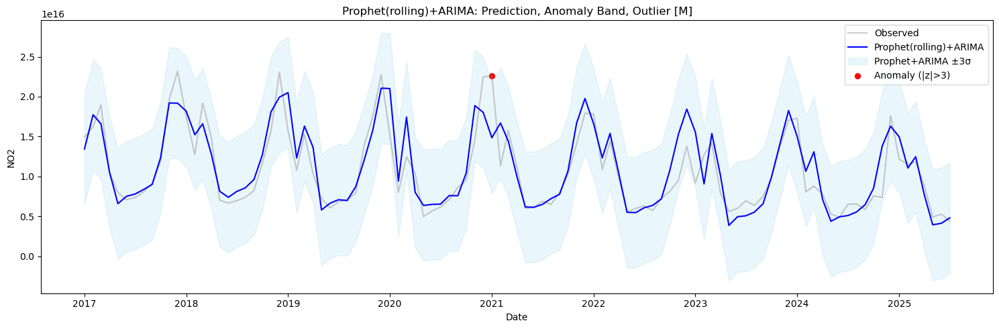

In [41]:
plot_arima_anomaly_band(df_ggu_monthly_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='M')


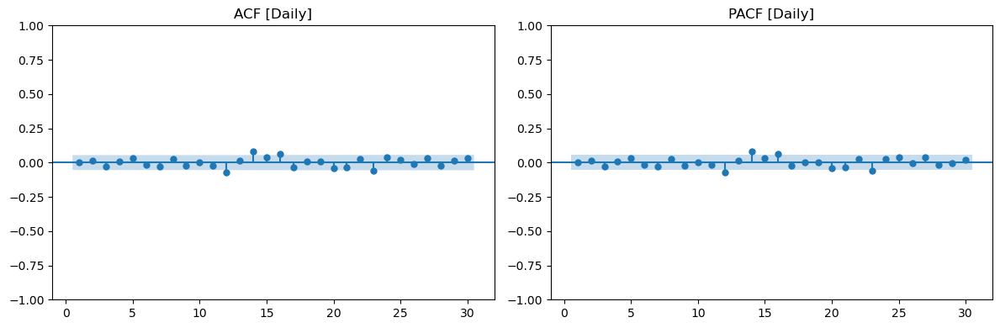

Ljung-Box Test [Daily] (using lags [10, 20, 30]):
      lb_stat  lb_pvalue
10   5.244429   0.874263
20  31.224009   0.052302
30  44.083141   0.046872



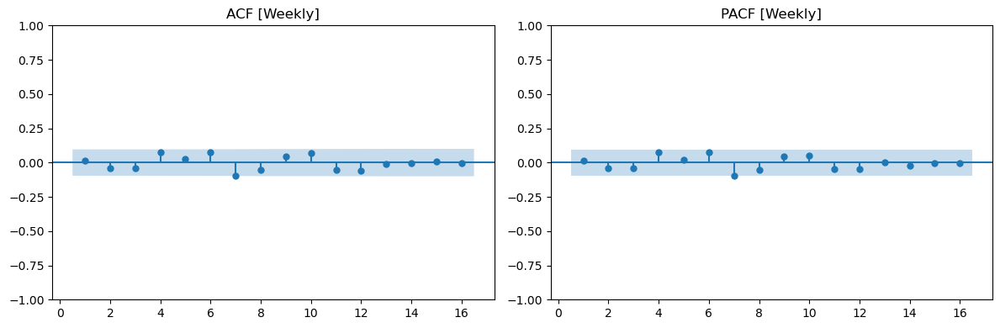

Ljung-Box Test [Weekly] (using lags [8, 12, 16]):
      lb_stat  lb_pvalue
8   11.917723   0.154913
12  17.823335   0.121161
16  17.968695   0.325733



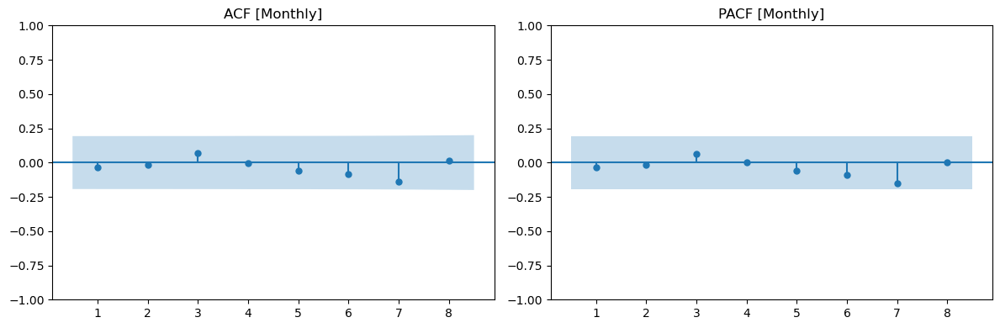

Ljung-Box Test [Monthly] (using lags [4, 8]):
    lb_stat  lb_pvalue
4  0.639314   0.958596
8  4.045537   0.852992



In [42]:
# Daily residual
residual_diagnostics(df_ggu_daily_result_nasa, lags=[10,20,30], title='[Daily]')
# Weekly residual
residual_diagnostics(df_ggu_weekly_result_nasa, lags=[8,12,16], title='[Weekly]')
# Monthly residual
residual_diagnostics(df_ggu_monthly_result_nasa, lags=[4,8], title='[Monthly]')

# Panzhihua

In [43]:
df_pzh_AQICN = pd.read_csv("data/aqicn/panzhihua.csv")
df_pzh_AQICN = change_df(df_pzh_AQICN)
df_pzh_NASA = pd.read_csv('data/nasa_data/panzhihuaNO2.csv')
df_pzh_NASA = cleaning_NASA_data(df_pzh_NASA,'NO2')

22:24:04 - cmdstanpy - INFO - Chain [1] start processing
22:24:04 - cmdstanpy - INFO - Chain [1] done processing
22:24:04 - cmdstanpy - INFO - Chain [1] start processing
22:24:04 - cmdstanpy - INFO - Chain [1] done processing
22:24:04 - cmdstanpy - INFO - Chain [1] start processing
22:24:04 - cmdstanpy - INFO - Chain [1] done processing
22:24:04 - cmdstanpy - INFO - Chain [1] start processing
22:24:04 - cmdstanpy - INFO - Chain [1] done processing
22:24:05 - cmdstanpy - INFO - Chain [1] start processing
22:24:05 - cmdstanpy - INFO - Chain [1] done processing
22:24:05 - cmdstanpy - INFO - Chain [1] start processing
22:24:05 - cmdstanpy - INFO - Chain [1] done processing
22:24:05 - cmdstanpy - INFO - Chain [1] start processing
22:24:05 - cmdstanpy - INFO - Chain [1] done processing
22:24:05 - cmdstanpy - INFO - Chain [1] start processing
22:24:05 - cmdstanpy - INFO - Chain [1] done processing
22:24:06 - cmdstanpy - INFO - Chain [1] start processing
22:24:06 - cmdstanpy - INFO - Chain [1]

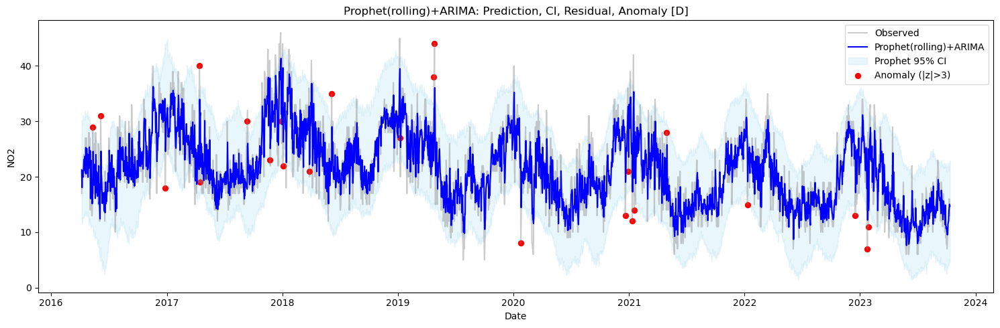

22:25:01 - cmdstanpy - INFO - Chain [1] start processing
22:25:01 - cmdstanpy - INFO - Chain [1] done processing
22:25:01 - cmdstanpy - INFO - Chain [1] start processing
22:25:01 - cmdstanpy - INFO - Chain [1] done processing
22:25:01 - cmdstanpy - INFO - Chain [1] start processing
22:25:01 - cmdstanpy - INFO - Chain [1] done processing
22:25:01 - cmdstanpy - INFO - Chain [1] start processing
22:25:01 - cmdstanpy - INFO - Chain [1] done processing
22:25:01 - cmdstanpy - INFO - Chain [1] start processing
22:25:01 - cmdstanpy - INFO - Chain [1] done processing
22:25:02 - cmdstanpy - INFO - Chain [1] start processing
22:25:02 - cmdstanpy - INFO - Chain [1] done processing
22:25:02 - cmdstanpy - INFO - Chain [1] start processing
22:25:02 - cmdstanpy - INFO - Chain [1] done processing
22:25:02 - cmdstanpy - INFO - Chain [1] start processing
22:25:02 - cmdstanpy - INFO - Chain [1] done processing
22:25:02 - cmdstanpy - INFO - Chain [1] start processing
22:25:02 - cmdstanpy - INFO - Chain [1]

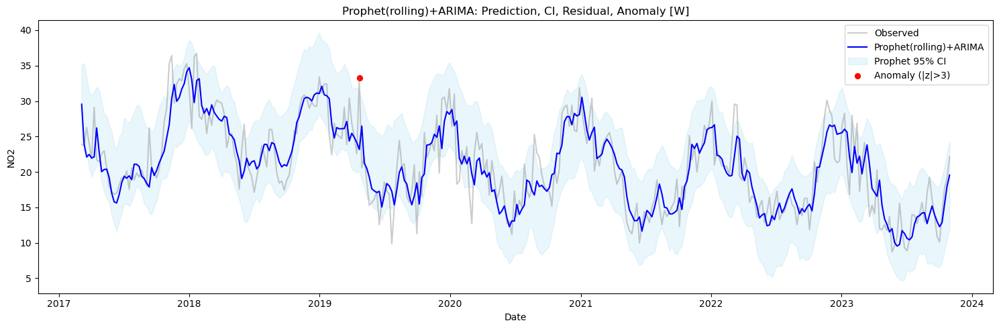

22:25:18 - cmdstanpy - INFO - Chain [1] start processing
22:25:19 - cmdstanpy - INFO - Chain [1] done processing
22:25:19 - cmdstanpy - INFO - Chain [1] start processing
22:25:19 - cmdstanpy - INFO - Chain [1] done processing
22:25:19 - cmdstanpy - INFO - Chain [1] start processing
22:25:19 - cmdstanpy - INFO - Chain [1] done processing
22:25:19 - cmdstanpy - INFO - Chain [1] start processing
22:25:19 - cmdstanpy - INFO - Chain [1] done processing
22:25:19 - cmdstanpy - INFO - Chain [1] start processing
22:25:20 - cmdstanpy - INFO - Chain [1] done processing
22:25:20 - cmdstanpy - INFO - Chain [1] start processing
22:25:20 - cmdstanpy - INFO - Chain [1] done processing
22:25:20 - cmdstanpy - INFO - Chain [1] start processing
22:25:20 - cmdstanpy - INFO - Chain [1] done processing
22:25:20 - cmdstanpy - INFO - Chain [1] start processing
22:25:21 - cmdstanpy - INFO - Chain [1] done processing
22:25:21 - cmdstanpy - INFO - Chain [1] start processing
22:25:21 - cmdstanpy - INFO - Chain [1]

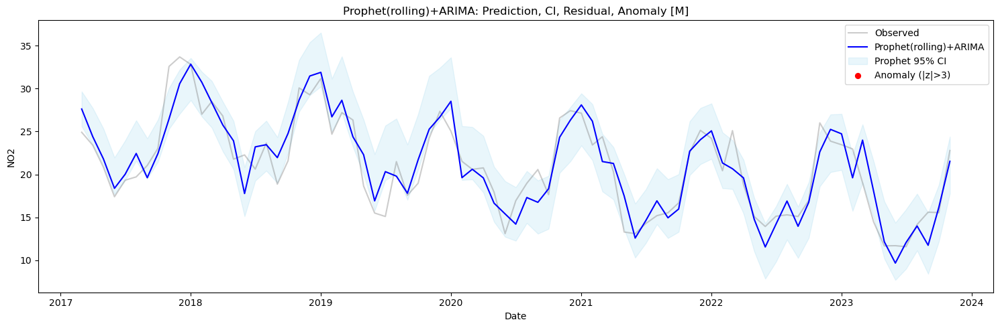

In [44]:
df_pzh_daily_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_pzh_AQICN, freq='D',pollutant='NO2'), pollutant='NO2',
    train_steps=730, test_steps=30, step=30, z_thresh=3, freq='D', plot=True
)
df_pzh_weekly_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_pzh_AQICN, freq='W',pollutant='NO2'), pollutant='NO2',
    train_steps=156, test_steps=8, step=4, z_thresh=3, freq='W', plot=True
)
df_pzh_monthly_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_pzh_AQICN, freq='M',pollutant='NO2'), pollutant='NO2',
    train_steps=36, test_steps=4, step=1, z_thresh=3, freq='M', plot=True
)

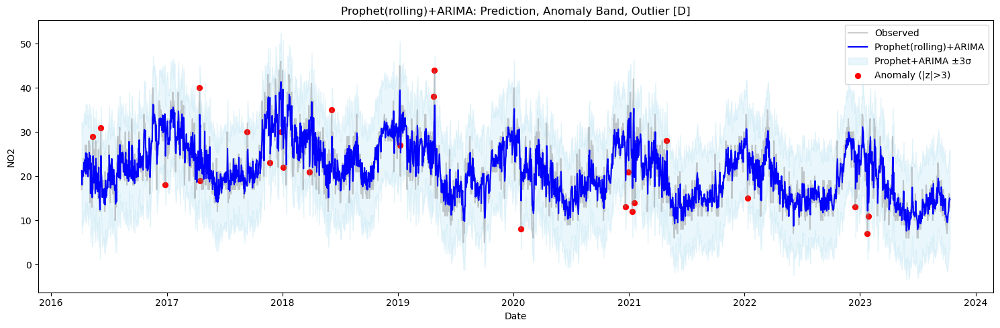

In [45]:
plot_arima_anomaly_band(df_pzh_daily_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='D')

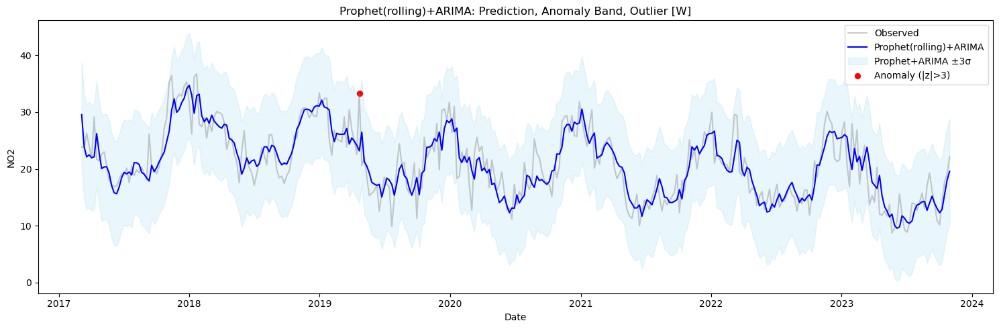

In [46]:
plot_arima_anomaly_band(df_pzh_weekly_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='W')


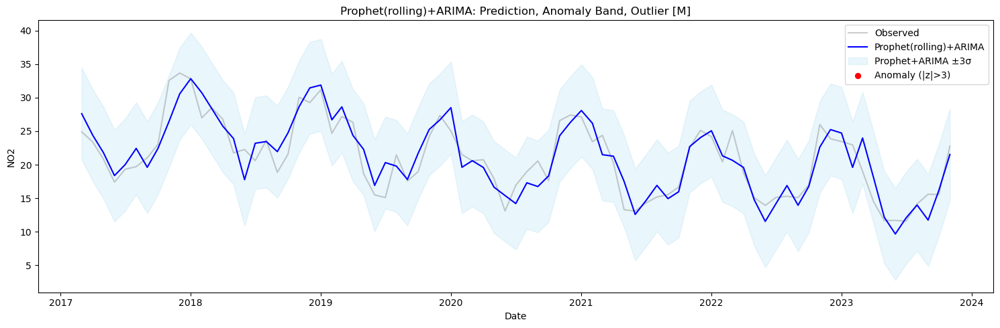

In [47]:
plot_arima_anomaly_band(df_pzh_monthly_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='M')


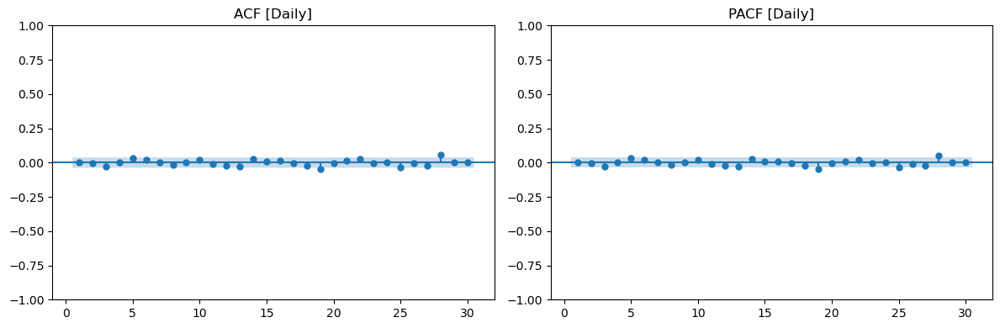

Ljung-Box Test [Daily] (using lags [10, 20, 30]):
      lb_stat  lb_pvalue
10   7.946793   0.634034
20  22.153507   0.332239
30  38.004112   0.149644



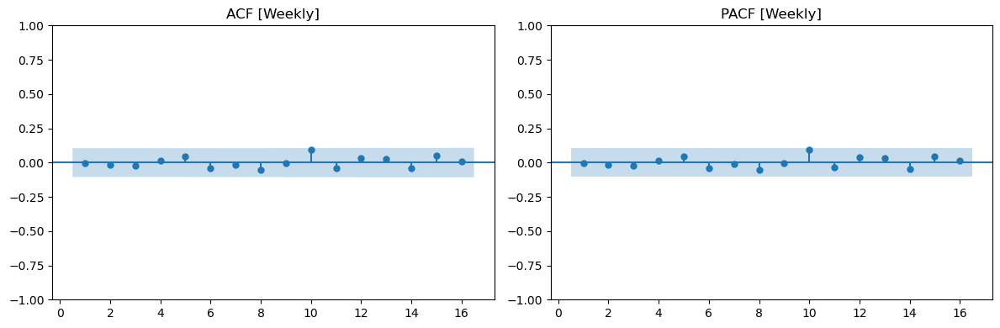

Ljung-Box Test [Weekly] (using lags [8, 12, 16]):
     lb_stat  lb_pvalue
8   2.859059   0.942888
12  7.144457   0.847921
16  8.948345   0.915526



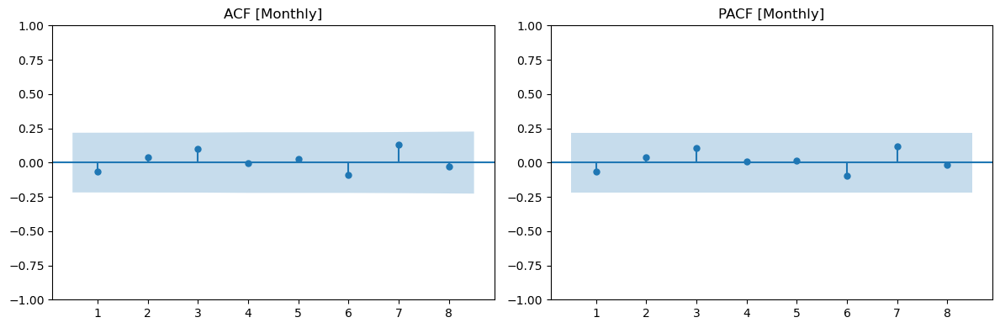

Ljung-Box Test [Monthly] (using lags [4, 8]):
    lb_stat  lb_pvalue
4  1.304647   0.860587
8  3.663030   0.886175



In [48]:
# Daily residual
residual_diagnostics(df_pzh_daily_result_aqicn, lags=[10,20,30], title='[Daily]')
# Weekly residual
residual_diagnostics(df_pzh_weekly_result_aqicn, lags=[8,12,16], title='[Weekly]')
# Monthly residual
residual_diagnostics(df_pzh_monthly_result_aqicn, lags=[4,8], title='[Monthly]')

22:25:48 - cmdstanpy - INFO - Chain [1] start processing
22:25:48 - cmdstanpy - INFO - Chain [1] done processing
22:25:48 - cmdstanpy - INFO - Chain [1] start processing
22:25:48 - cmdstanpy - INFO - Chain [1] done processing
22:25:48 - cmdstanpy - INFO - Chain [1] start processing
22:25:48 - cmdstanpy - INFO - Chain [1] done processing
22:25:49 - cmdstanpy - INFO - Chain [1] start processing
22:25:49 - cmdstanpy - INFO - Chain [1] done processing
22:25:49 - cmdstanpy - INFO - Chain [1] start processing
22:25:49 - cmdstanpy - INFO - Chain [1] done processing
22:25:49 - cmdstanpy - INFO - Chain [1] start processing
22:25:49 - cmdstanpy - INFO - Chain [1] done processing
22:25:49 - cmdstanpy - INFO - Chain [1] start processing
22:25:49 - cmdstanpy - INFO - Chain [1] done processing
22:25:49 - cmdstanpy - INFO - Chain [1] start processing
22:25:50 - cmdstanpy - INFO - Chain [1] done processing
22:25:50 - cmdstanpy - INFO - Chain [1] start processing
22:25:50 - cmdstanpy - INFO - Chain [1]

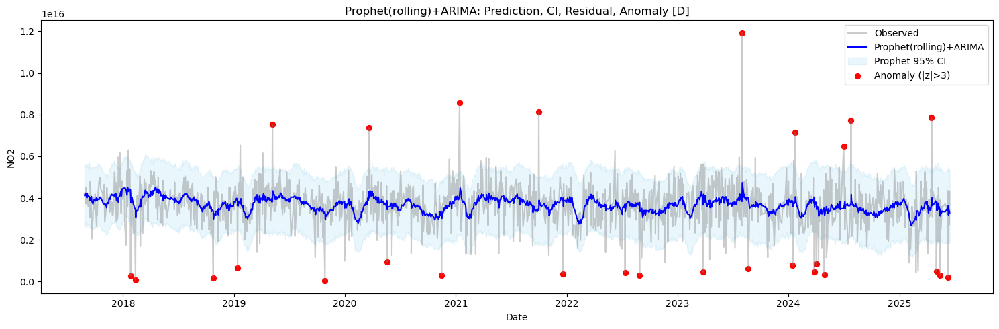

22:26:06 - cmdstanpy - INFO - Chain [1] start processing
22:26:06 - cmdstanpy - INFO - Chain [1] done processing
22:26:07 - cmdstanpy - INFO - Chain [1] start processing
22:26:07 - cmdstanpy - INFO - Chain [1] done processing
22:26:07 - cmdstanpy - INFO - Chain [1] start processing
22:26:07 - cmdstanpy - INFO - Chain [1] done processing
22:26:07 - cmdstanpy - INFO - Chain [1] start processing
22:26:07 - cmdstanpy - INFO - Chain [1] done processing
22:26:07 - cmdstanpy - INFO - Chain [1] start processing
22:26:07 - cmdstanpy - INFO - Chain [1] done processing
22:26:07 - cmdstanpy - INFO - Chain [1] start processing
22:26:07 - cmdstanpy - INFO - Chain [1] done processing
22:26:07 - cmdstanpy - INFO - Chain [1] start processing
22:26:07 - cmdstanpy - INFO - Chain [1] done processing
22:26:08 - cmdstanpy - INFO - Chain [1] start processing
22:26:08 - cmdstanpy - INFO - Chain [1] done processing
22:26:08 - cmdstanpy - INFO - Chain [1] start processing
22:26:08 - cmdstanpy - INFO - Chain [1]

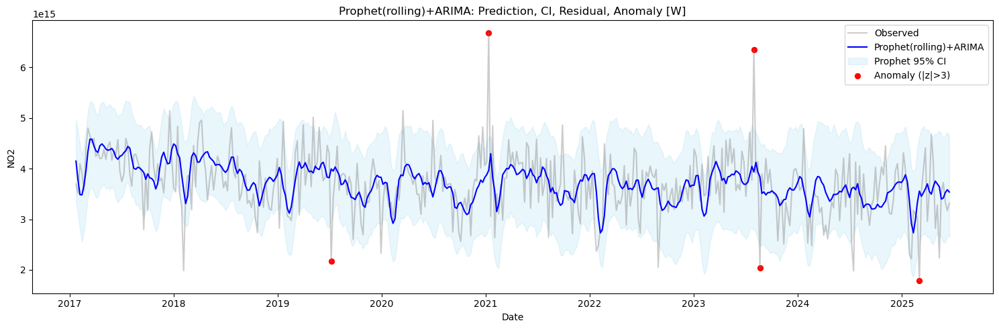

22:26:27 - cmdstanpy - INFO - Chain [1] start processing
22:26:27 - cmdstanpy - INFO - Chain [1] done processing
22:26:27 - cmdstanpy - INFO - Chain [1] start processing
22:26:28 - cmdstanpy - INFO - Chain [1] done processing
22:26:28 - cmdstanpy - INFO - Chain [1] start processing
22:26:28 - cmdstanpy - INFO - Chain [1] done processing
22:26:28 - cmdstanpy - INFO - Chain [1] start processing
22:26:28 - cmdstanpy - INFO - Chain [1] done processing
22:26:28 - cmdstanpy - INFO - Chain [1] start processing
22:26:29 - cmdstanpy - INFO - Chain [1] done processing
22:26:29 - cmdstanpy - INFO - Chain [1] start processing
22:26:29 - cmdstanpy - INFO - Chain [1] done processing
22:26:29 - cmdstanpy - INFO - Chain [1] start processing
22:26:29 - cmdstanpy - INFO - Chain [1] done processing
22:26:29 - cmdstanpy - INFO - Chain [1] start processing
22:26:29 - cmdstanpy - INFO - Chain [1] done processing
22:26:30 - cmdstanpy - INFO - Chain [1] start processing
22:26:30 - cmdstanpy - INFO - Chain [1]

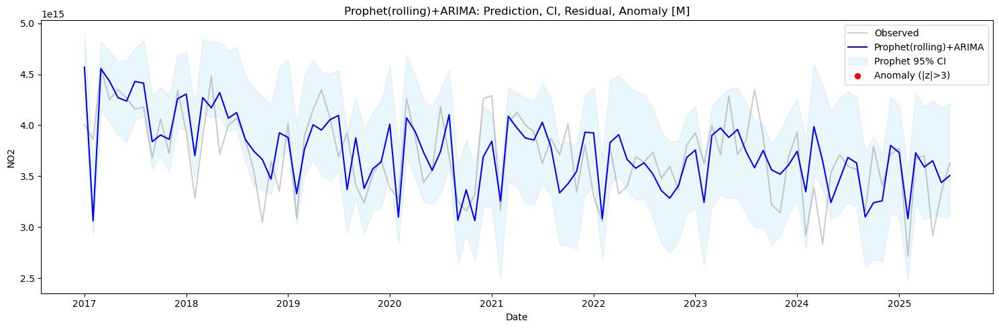

In [49]:
df_pzh_daily_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_pzh_NASA, freq='D',pollutant='NO2'), pollutant='NO2',
    train_steps=730, test_steps=30, step=30, z_thresh=3, freq='D', plot=True
)
df_pzh_weekly_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_pzh_NASA, freq='W',pollutant='NO2'), pollutant='NO2',
    train_steps=156, test_steps=8, step=4, z_thresh=3, freq='W', plot=True
)
df_pzh_monthly_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_pzh_NASA, freq='M',pollutant='NO2'), pollutant='NO2',
    train_steps=36, test_steps=4, step=1, z_thresh=3, freq='M', plot=True
)

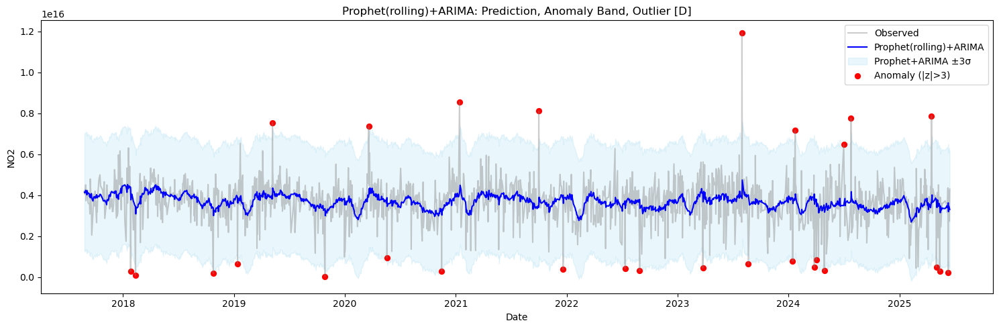

In [50]:
plot_arima_anomaly_band(df_pzh_daily_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='D')


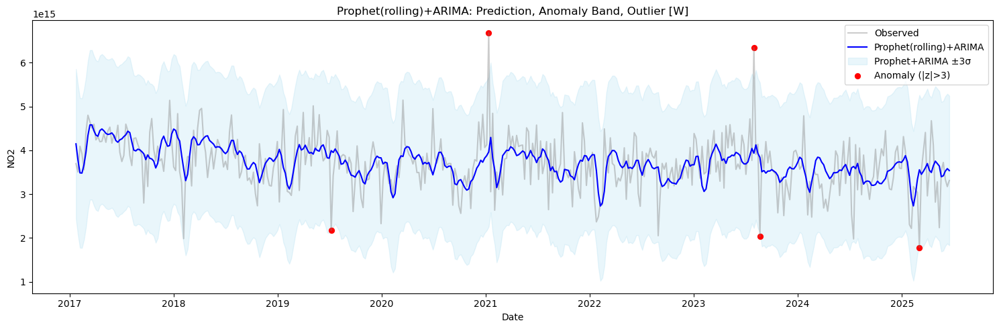

In [51]:
plot_arima_anomaly_band(df_pzh_weekly_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='W')


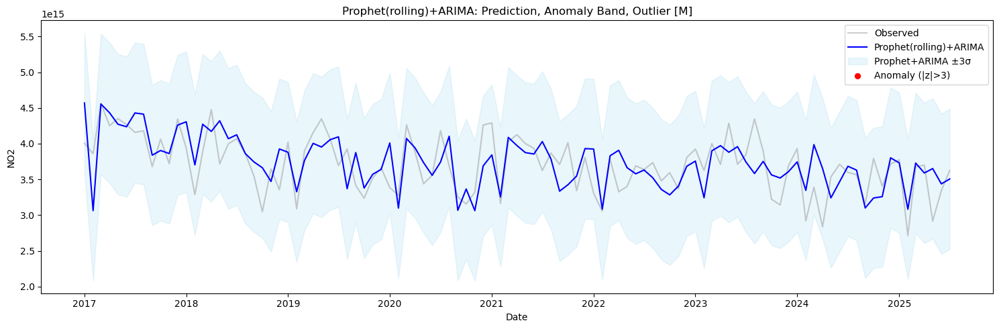

In [52]:
plot_arima_anomaly_band(df_pzh_monthly_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='M')


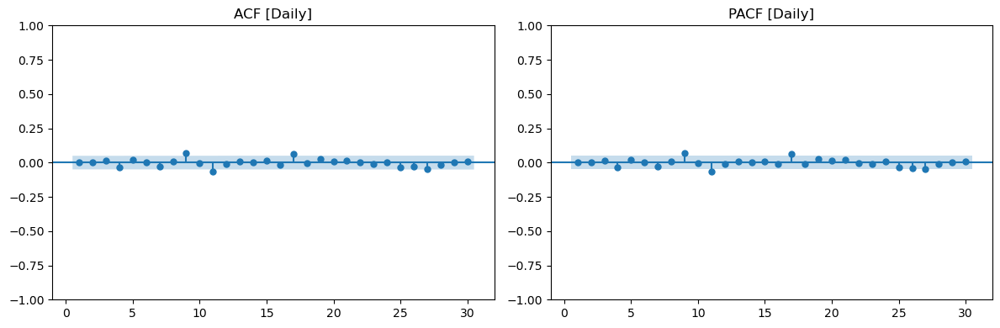

Ljung-Box Test [Daily] (using lags [10, 20, 30]):
      lb_stat  lb_pvalue
10  10.839387   0.370168
20  25.993873   0.166014
30  34.317964   0.268300



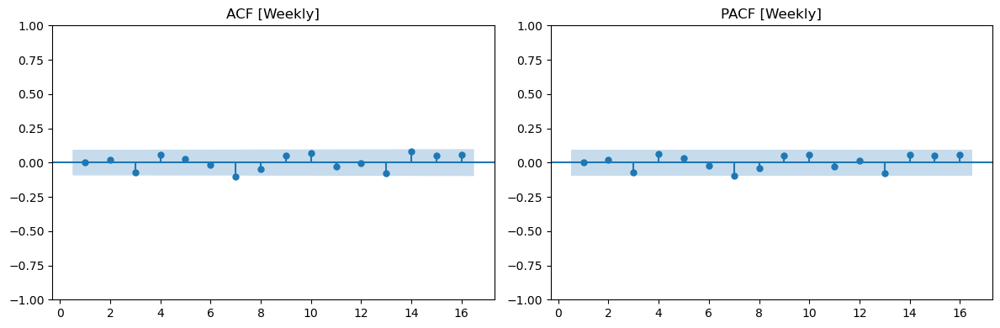

Ljung-Box Test [Weekly] (using lags [8, 12, 16]):
      lb_stat  lb_pvalue
8   10.297575   0.244758
12  13.814391   0.312718
16  22.465776   0.128779



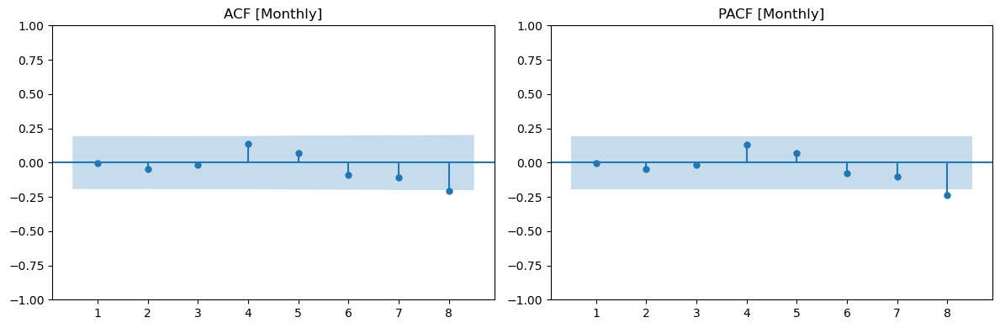

Ljung-Box Test [Monthly] (using lags [4, 8]):
    lb_stat  lb_pvalue
4  2.283513   0.683772
8  9.683110   0.287975



In [53]:
# Daily residual
residual_diagnostics(df_pzh_daily_result_nasa, lags=[10,20,30], title='[Daily]')
# Weekly residual
residual_diagnostics(df_pzh_weekly_result_nasa, lags=[8,12,16], title='[Weekly]')
# Monthly residual
residual_diagnostics(df_pzh_monthly_result_nasa, lags=[4,8], title='[Monthly]')

# quanzhou

In [54]:
df_qzu_AQICN = pd.read_csv("data/aqicn/quanzhou.csv")
df_qzu_AQICN = change_df(df_qzu_AQICN)
df_qzu_NASA = pd.read_csv('data/nasa_data/quanzhouNO2.csv')
df_qzu_NASA = cleaning_NASA_data(df_qzu_NASA,'NO2')

22:26:59 - cmdstanpy - INFO - Chain [1] start processing
22:26:59 - cmdstanpy - INFO - Chain [1] done processing
22:27:00 - cmdstanpy - INFO - Chain [1] start processing
22:27:00 - cmdstanpy - INFO - Chain [1] done processing
22:27:00 - cmdstanpy - INFO - Chain [1] start processing
22:27:00 - cmdstanpy - INFO - Chain [1] done processing
22:27:00 - cmdstanpy - INFO - Chain [1] start processing
22:27:00 - cmdstanpy - INFO - Chain [1] done processing
22:27:00 - cmdstanpy - INFO - Chain [1] start processing
22:27:00 - cmdstanpy - INFO - Chain [1] done processing
22:27:00 - cmdstanpy - INFO - Chain [1] start processing
22:27:01 - cmdstanpy - INFO - Chain [1] done processing
22:27:01 - cmdstanpy - INFO - Chain [1] start processing
22:27:01 - cmdstanpy - INFO - Chain [1] done processing
22:27:01 - cmdstanpy - INFO - Chain [1] start processing
22:27:01 - cmdstanpy - INFO - Chain [1] done processing
22:27:01 - cmdstanpy - INFO - Chain [1] start processing
22:27:01 - cmdstanpy - INFO - Chain [1]

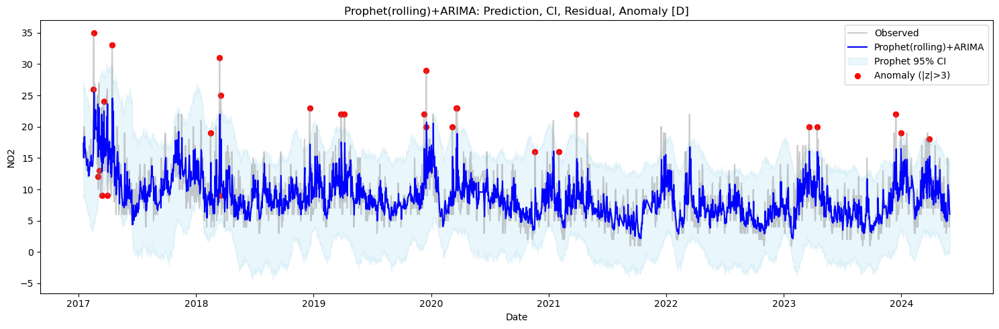

22:27:44 - cmdstanpy - INFO - Chain [1] start processing
22:27:44 - cmdstanpy - INFO - Chain [1] done processing
22:27:44 - cmdstanpy - INFO - Chain [1] start processing
22:27:44 - cmdstanpy - INFO - Chain [1] done processing
22:27:44 - cmdstanpy - INFO - Chain [1] start processing
22:27:44 - cmdstanpy - INFO - Chain [1] done processing
22:27:44 - cmdstanpy - INFO - Chain [1] start processing
22:27:44 - cmdstanpy - INFO - Chain [1] done processing
22:27:44 - cmdstanpy - INFO - Chain [1] start processing
22:27:44 - cmdstanpy - INFO - Chain [1] done processing
22:27:45 - cmdstanpy - INFO - Chain [1] start processing
22:27:45 - cmdstanpy - INFO - Chain [1] done processing
22:27:45 - cmdstanpy - INFO - Chain [1] start processing
22:27:45 - cmdstanpy - INFO - Chain [1] done processing
22:27:45 - cmdstanpy - INFO - Chain [1] start processing
22:27:45 - cmdstanpy - INFO - Chain [1] done processing
22:27:45 - cmdstanpy - INFO - Chain [1] start processing
22:27:45 - cmdstanpy - INFO - Chain [1]

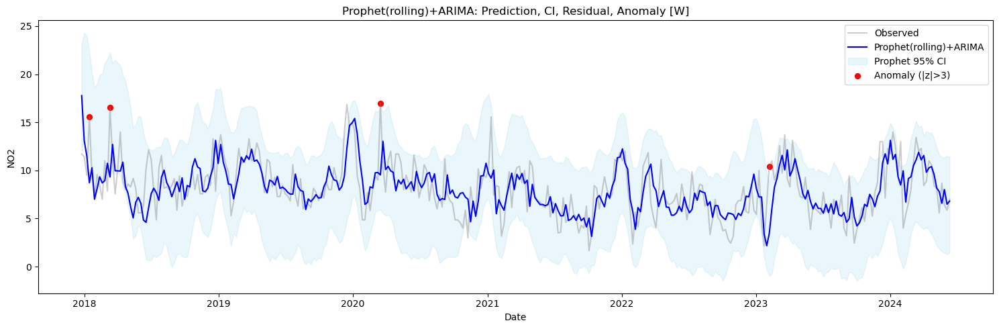

22:28:00 - cmdstanpy - INFO - Chain [1] start processing
22:28:00 - cmdstanpy - INFO - Chain [1] done processing
22:28:01 - cmdstanpy - INFO - Chain [1] start processing
22:28:01 - cmdstanpy - INFO - Chain [1] done processing
22:28:01 - cmdstanpy - INFO - Chain [1] start processing
22:28:01 - cmdstanpy - INFO - Chain [1] done processing
22:28:01 - cmdstanpy - INFO - Chain [1] start processing
22:28:01 - cmdstanpy - INFO - Chain [1] done processing
22:28:01 - cmdstanpy - INFO - Chain [1] start processing
22:28:02 - cmdstanpy - INFO - Chain [1] done processing
22:28:02 - cmdstanpy - INFO - Chain [1] start processing
22:28:02 - cmdstanpy - INFO - Chain [1] done processing
22:28:02 - cmdstanpy - INFO - Chain [1] start processing
22:28:02 - cmdstanpy - INFO - Chain [1] done processing
22:28:03 - cmdstanpy - INFO - Chain [1] start processing
22:28:03 - cmdstanpy - INFO - Chain [1] done processing
22:28:03 - cmdstanpy - INFO - Chain [1] start processing
22:28:03 - cmdstanpy - INFO - Chain [1]

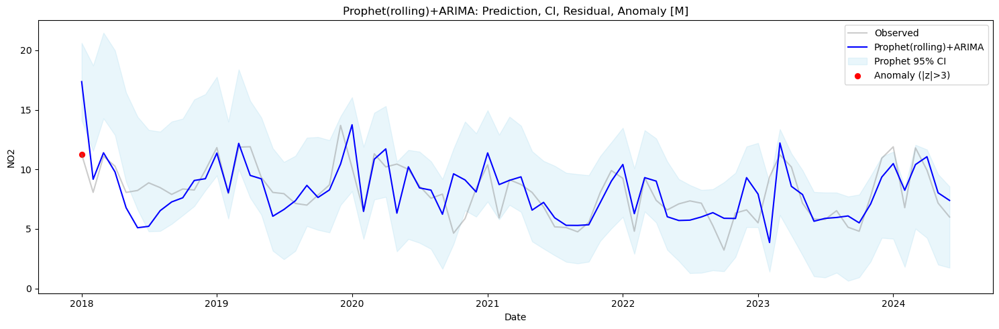

In [55]:
df_qzu_daily_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_qzu_AQICN, freq='D',pollutant='NO2'), pollutant='NO2',
    train_steps=730, test_steps=30, step=30, z_thresh=3, freq='D', plot=True
)
df_qzu_weekly_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_qzu_AQICN, freq='W',pollutant='NO2'), pollutant='NO2',
    train_steps=156, test_steps=8, step=4, z_thresh=3, freq='W', plot=True
)
df_qzu_monthly_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_qzu_AQICN, freq='M',pollutant='NO2'), pollutant='NO2',
    train_steps=36, test_steps=4, step=1, z_thresh=3, freq='M', plot=True
)

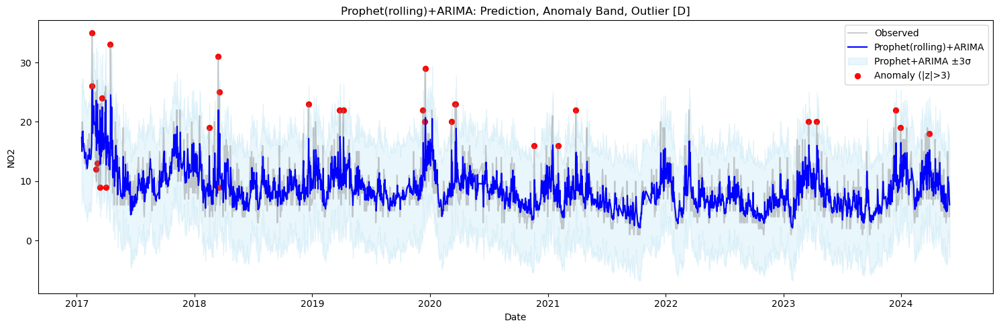

In [56]:
plot_arima_anomaly_band(df_qzu_daily_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='D')

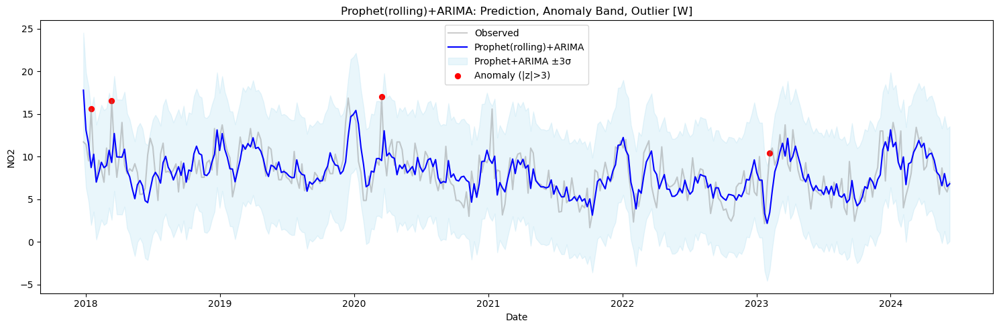

In [57]:
plot_arima_anomaly_band(df_qzu_weekly_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='W')


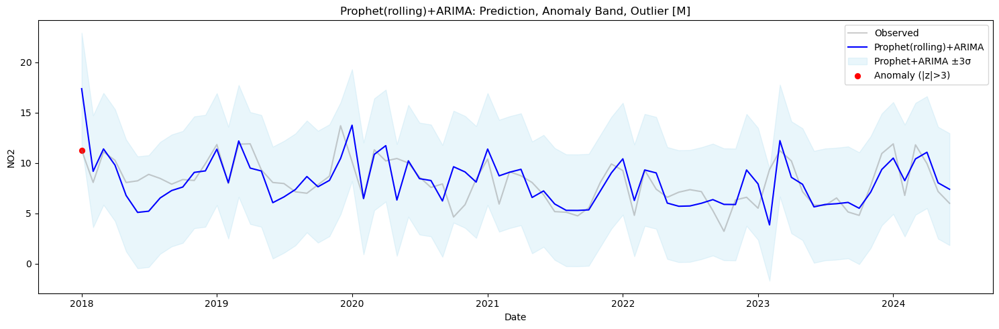

In [58]:
plot_arima_anomaly_band(df_qzu_monthly_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='M')


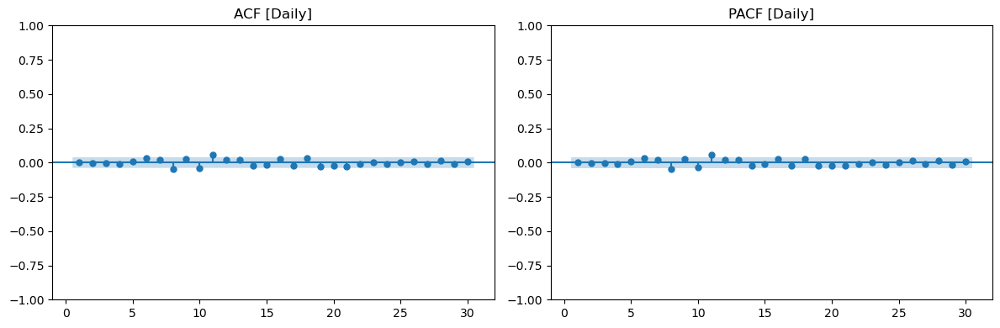

Ljung-Box Test [Daily] (using lags [10, 20, 30]):
      lb_stat  lb_pvalue
10  14.816670   0.138890
20  36.706834   0.012686
30  40.223518   0.100607



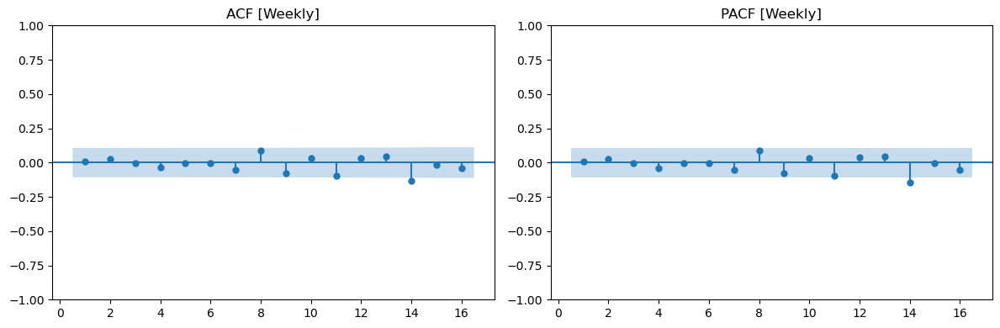

Ljung-Box Test [Weekly] (using lags [8, 12, 16]):
      lb_stat  lb_pvalue
8    4.406043   0.818758
12  10.342211   0.585966
16  18.359975   0.303243



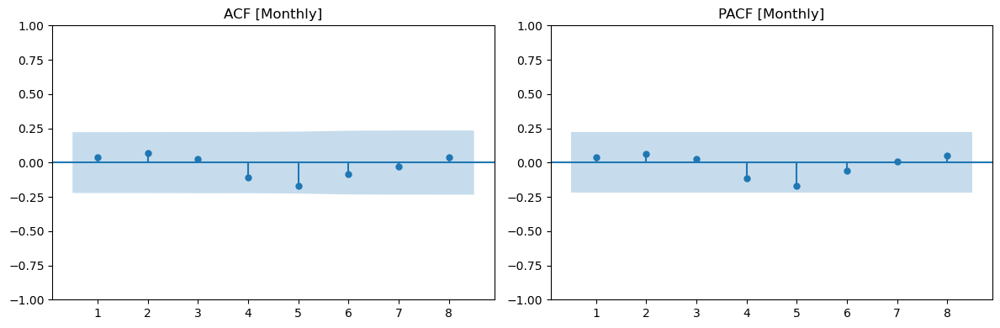

Ljung-Box Test [Monthly] (using lags [4, 8]):
    lb_stat  lb_pvalue
4  1.568946   0.814362
8  4.927466   0.765300



In [59]:
# Daily residual
residual_diagnostics(df_qzu_daily_result_aqicn, lags=[10,20,30], title='[Daily]')
# Weekly residual
residual_diagnostics(df_qzu_weekly_result_aqicn, lags=[8,12,16], title='[Weekly]')
# Monthly residual
residual_diagnostics(df_qzu_monthly_result_aqicn, lags=[4,8], title='[Monthly]')

22:28:27 - cmdstanpy - INFO - Chain [1] start processing
22:28:27 - cmdstanpy - INFO - Chain [1] done processing
22:28:27 - cmdstanpy - INFO - Chain [1] start processing
22:28:27 - cmdstanpy - INFO - Chain [1] done processing
22:28:27 - cmdstanpy - INFO - Chain [1] start processing
22:28:27 - cmdstanpy - INFO - Chain [1] done processing
22:28:27 - cmdstanpy - INFO - Chain [1] start processing
22:28:27 - cmdstanpy - INFO - Chain [1] done processing
22:28:28 - cmdstanpy - INFO - Chain [1] start processing
22:28:28 - cmdstanpy - INFO - Chain [1] done processing
22:28:28 - cmdstanpy - INFO - Chain [1] start processing
22:28:28 - cmdstanpy - INFO - Chain [1] done processing
22:28:28 - cmdstanpy - INFO - Chain [1] start processing
22:28:28 - cmdstanpy - INFO - Chain [1] done processing
22:28:28 - cmdstanpy - INFO - Chain [1] start processing
22:28:28 - cmdstanpy - INFO - Chain [1] done processing
22:28:28 - cmdstanpy - INFO - Chain [1] start processing
22:28:29 - cmdstanpy - INFO - Chain [1]

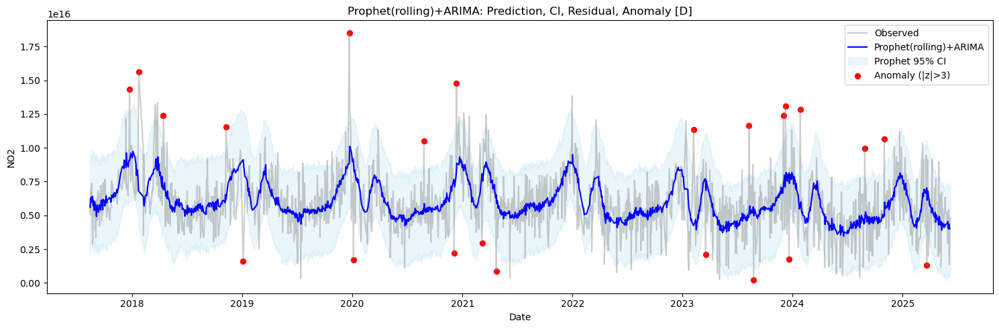

22:28:44 - cmdstanpy - INFO - Chain [1] start processing
22:28:45 - cmdstanpy - INFO - Chain [1] done processing
22:28:45 - cmdstanpy - INFO - Chain [1] start processing
22:28:45 - cmdstanpy - INFO - Chain [1] done processing
22:28:45 - cmdstanpy - INFO - Chain [1] start processing
22:28:45 - cmdstanpy - INFO - Chain [1] done processing
22:28:45 - cmdstanpy - INFO - Chain [1] start processing
22:28:45 - cmdstanpy - INFO - Chain [1] done processing
22:28:45 - cmdstanpy - INFO - Chain [1] start processing
22:28:45 - cmdstanpy - INFO - Chain [1] done processing
22:28:45 - cmdstanpy - INFO - Chain [1] start processing
22:28:45 - cmdstanpy - INFO - Chain [1] done processing
22:28:46 - cmdstanpy - INFO - Chain [1] start processing
22:28:46 - cmdstanpy - INFO - Chain [1] done processing
22:28:46 - cmdstanpy - INFO - Chain [1] start processing
22:28:46 - cmdstanpy - INFO - Chain [1] done processing
22:28:46 - cmdstanpy - INFO - Chain [1] start processing
22:28:46 - cmdstanpy - INFO - Chain [1]

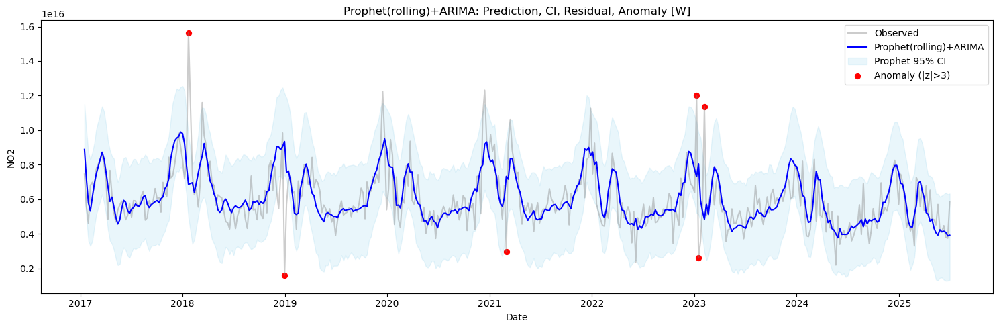

22:29:05 - cmdstanpy - INFO - Chain [1] start processing
22:29:05 - cmdstanpy - INFO - Chain [1] done processing
22:29:05 - cmdstanpy - INFO - Chain [1] start processing
22:29:05 - cmdstanpy - INFO - Chain [1] done processing
22:29:05 - cmdstanpy - INFO - Chain [1] start processing
22:29:06 - cmdstanpy - INFO - Chain [1] done processing
22:29:06 - cmdstanpy - INFO - Chain [1] start processing
22:29:06 - cmdstanpy - INFO - Chain [1] done processing
22:29:06 - cmdstanpy - INFO - Chain [1] start processing
22:29:06 - cmdstanpy - INFO - Chain [1] done processing
22:29:06 - cmdstanpy - INFO - Chain [1] start processing
22:29:07 - cmdstanpy - INFO - Chain [1] done processing
22:29:07 - cmdstanpy - INFO - Chain [1] start processing
22:29:07 - cmdstanpy - INFO - Chain [1] done processing
22:29:07 - cmdstanpy - INFO - Chain [1] start processing
22:29:07 - cmdstanpy - INFO - Chain [1] done processing
22:29:07 - cmdstanpy - INFO - Chain [1] start processing
22:29:07 - cmdstanpy - INFO - Chain [1]

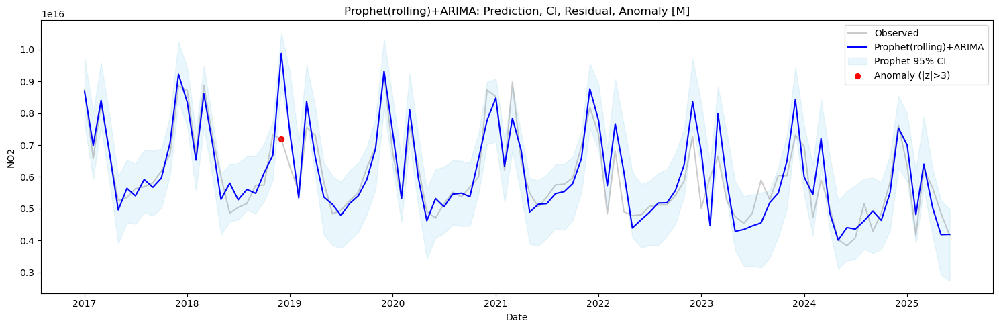

In [60]:
df_qzu_daily_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_qzu_NASA, freq='D',pollutant='NO2'), pollutant='NO2',
    train_steps=730, test_steps=30, step=30, z_thresh=3, freq='D', plot=True
)
df_qzu_weekly_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_qzu_NASA, freq='W',pollutant='NO2'), pollutant='NO2',
    train_steps=156, test_steps=8, step=4, z_thresh=3, freq='W', plot=True
)
df_qzu_monthly_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_qzu_NASA, freq='M',pollutant='NO2'), pollutant='NO2',
    train_steps=36, test_steps=4, step=1, z_thresh=3, freq='M', plot=True
)

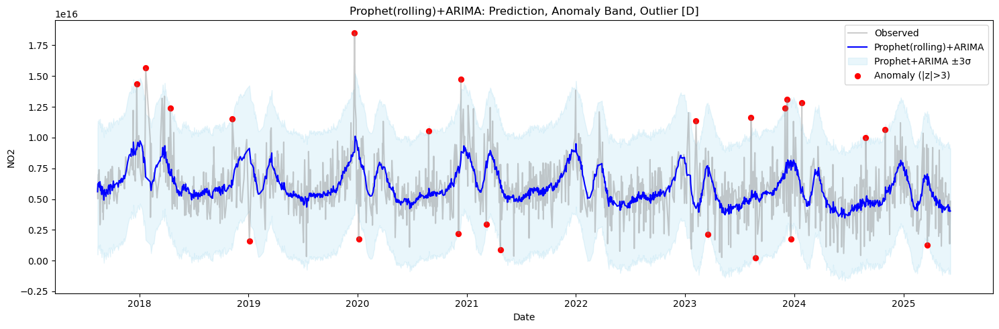

In [61]:
plot_arima_anomaly_band(df_qzu_daily_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='D')


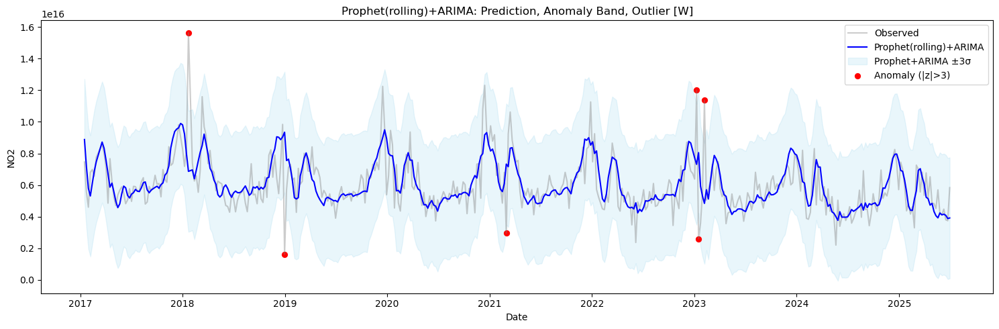

In [62]:
plot_arima_anomaly_band(df_qzu_weekly_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='W')


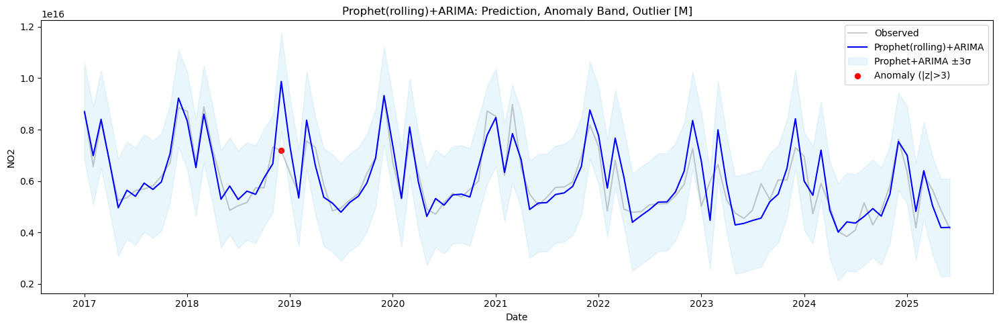

In [63]:
plot_arima_anomaly_band(df_qzu_monthly_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='M')


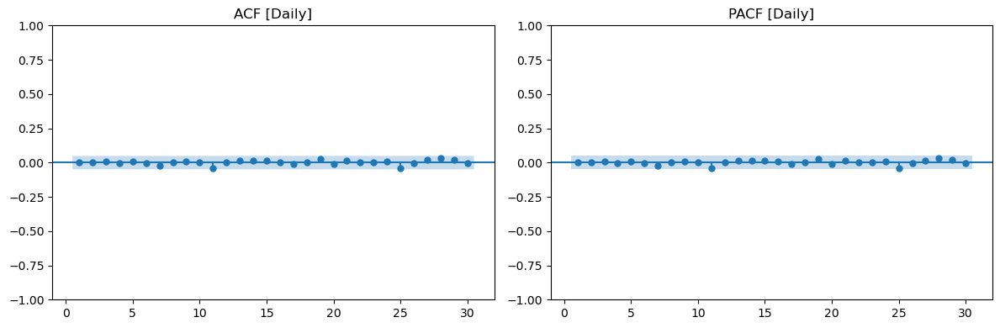

Ljung-Box Test [Daily] (using lags [10, 20, 30]):
      lb_stat  lb_pvalue
10   1.350041   0.999331
20   6.693895   0.997575
30  12.925388   0.997196



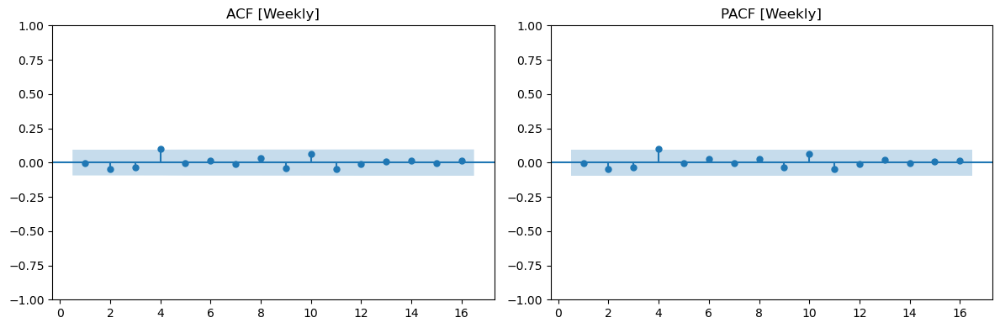

Ljung-Box Test [Weekly] (using lags [8, 12, 16]):
      lb_stat  lb_pvalue
8    6.851398   0.552747
12  10.343379   0.585864
16  10.643419   0.830942



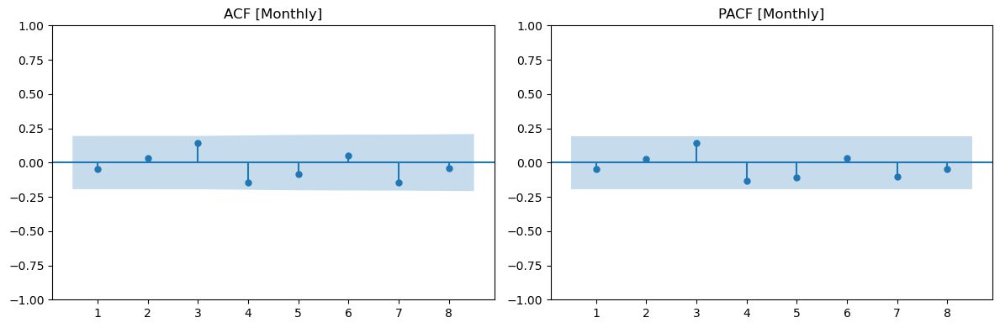

Ljung-Box Test [Monthly] (using lags [4, 8]):
    lb_stat  lb_pvalue
4  4.681605   0.321553
8  8.377067   0.397530



In [64]:
# Daily residual
residual_diagnostics(df_qzu_daily_result_nasa, lags=[10,20,30], title='[Daily]')
# Weekly residual
residual_diagnostics(df_qzu_weekly_result_nasa, lags=[8,12,16], title='[Weekly]')
# Monthly residual
residual_diagnostics(df_qzu_monthly_result_nasa, lags=[4,8], title='[Monthly]')

# shenzhen

In [65]:
df_shn_AQICN = pd.read_csv("data/aqicn/shenzhen.csv")
df_shn_AQICN = change_df(df_shn_AQICN)
df_shn_NASA = pd.read_csv('data/nasa_data/shenzhenNO2.csv')
df_shn_NASA = cleaning_NASA_data(df_shn_NASA,'NO2')

22:29:36 - cmdstanpy - INFO - Chain [1] start processing
22:29:36 - cmdstanpy - INFO - Chain [1] done processing
22:29:36 - cmdstanpy - INFO - Chain [1] start processing
22:29:36 - cmdstanpy - INFO - Chain [1] done processing
22:29:36 - cmdstanpy - INFO - Chain [1] start processing
22:29:36 - cmdstanpy - INFO - Chain [1] done processing
22:29:36 - cmdstanpy - INFO - Chain [1] start processing
22:29:36 - cmdstanpy - INFO - Chain [1] done processing
22:29:37 - cmdstanpy - INFO - Chain [1] start processing
22:29:37 - cmdstanpy - INFO - Chain [1] done processing
22:29:37 - cmdstanpy - INFO - Chain [1] start processing
22:29:37 - cmdstanpy - INFO - Chain [1] done processing
22:29:37 - cmdstanpy - INFO - Chain [1] start processing
22:29:37 - cmdstanpy - INFO - Chain [1] done processing
22:29:37 - cmdstanpy - INFO - Chain [1] start processing
22:29:37 - cmdstanpy - INFO - Chain [1] done processing
22:29:38 - cmdstanpy - INFO - Chain [1] start processing
22:29:38 - cmdstanpy - INFO - Chain [1]

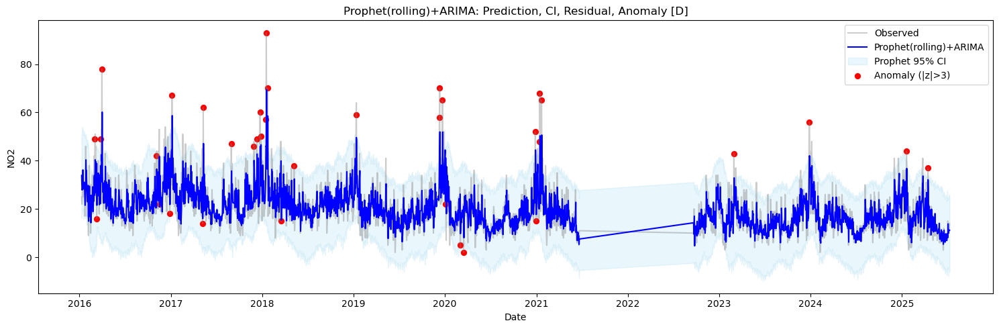

22:30:19 - cmdstanpy - INFO - Chain [1] start processing
22:30:19 - cmdstanpy - INFO - Chain [1] done processing
22:30:19 - cmdstanpy - INFO - Chain [1] start processing
22:30:20 - cmdstanpy - INFO - Chain [1] done processing
22:30:20 - cmdstanpy - INFO - Chain [1] start processing
22:30:20 - cmdstanpy - INFO - Chain [1] done processing
22:30:20 - cmdstanpy - INFO - Chain [1] start processing
22:30:20 - cmdstanpy - INFO - Chain [1] done processing
22:30:20 - cmdstanpy - INFO - Chain [1] start processing
22:30:20 - cmdstanpy - INFO - Chain [1] done processing
22:30:20 - cmdstanpy - INFO - Chain [1] start processing
22:30:20 - cmdstanpy - INFO - Chain [1] done processing
22:30:20 - cmdstanpy - INFO - Chain [1] start processing
22:30:20 - cmdstanpy - INFO - Chain [1] done processing
22:30:20 - cmdstanpy - INFO - Chain [1] start processing
22:30:20 - cmdstanpy - INFO - Chain [1] done processing
22:30:21 - cmdstanpy - INFO - Chain [1] start processing
22:30:21 - cmdstanpy - INFO - Chain [1]

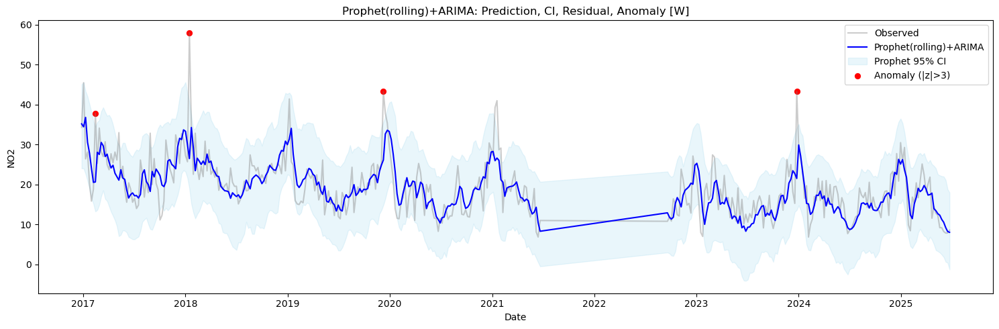

22:30:37 - cmdstanpy - INFO - Chain [1] start processing
22:30:37 - cmdstanpy - INFO - Chain [1] done processing
22:30:37 - cmdstanpy - INFO - Chain [1] start processing
22:30:37 - cmdstanpy - INFO - Chain [1] done processing
22:30:37 - cmdstanpy - INFO - Chain [1] start processing
22:30:37 - cmdstanpy - INFO - Chain [1] done processing
22:30:37 - cmdstanpy - INFO - Chain [1] start processing
22:30:38 - cmdstanpy - INFO - Chain [1] done processing
22:30:38 - cmdstanpy - INFO - Chain [1] start processing
22:30:38 - cmdstanpy - INFO - Chain [1] done processing
22:30:38 - cmdstanpy - INFO - Chain [1] start processing
22:30:38 - cmdstanpy - INFO - Chain [1] done processing
22:30:38 - cmdstanpy - INFO - Chain [1] start processing
22:30:38 - cmdstanpy - INFO - Chain [1] done processing
22:30:39 - cmdstanpy - INFO - Chain [1] start processing
22:30:39 - cmdstanpy - INFO - Chain [1] done processing
22:30:39 - cmdstanpy - INFO - Chain [1] start processing
22:30:39 - cmdstanpy - INFO - Chain [1]

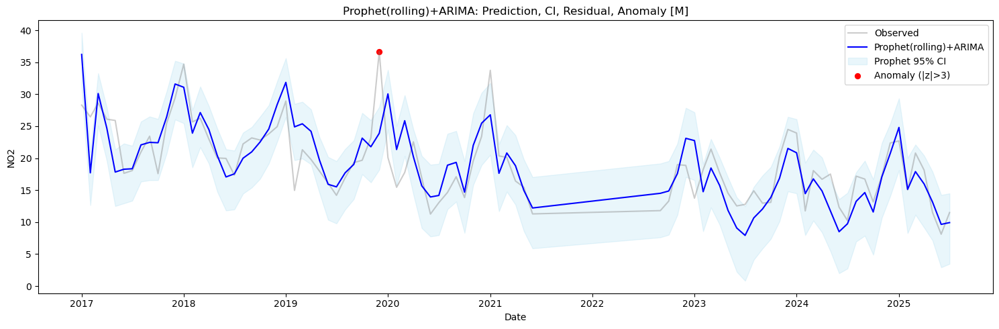

In [66]:
df_shn_daily_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_shn_AQICN, freq='D',pollutant='NO2'), pollutant='NO2',
    train_steps=730, test_steps=30, step=30, z_thresh=3, freq='D', plot=True
)
df_shn_weekly_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_shn_AQICN, freq='W',pollutant='NO2'), pollutant='NO2',
    train_steps=156, test_steps=8, step=4, z_thresh=3, freq='W', plot=True
)
df_shn_monthly_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_shn_AQICN, freq='M',pollutant='NO2'), pollutant='NO2',
    train_steps=36, test_steps=4, step=1, z_thresh=3, freq='M', plot=True
)

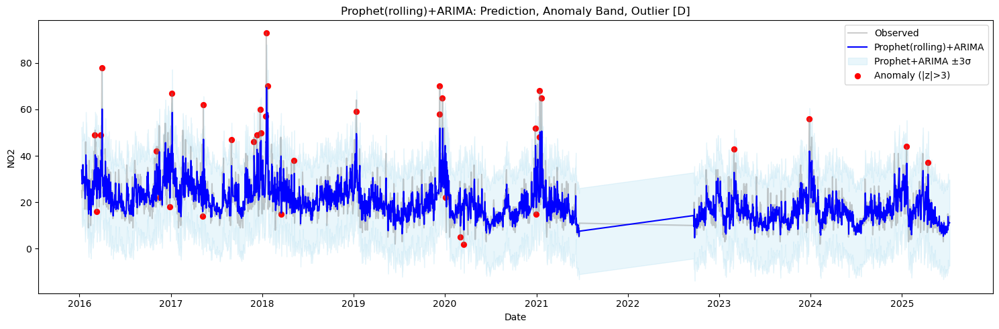

In [67]:
plot_arima_anomaly_band(df_shn_daily_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='D')

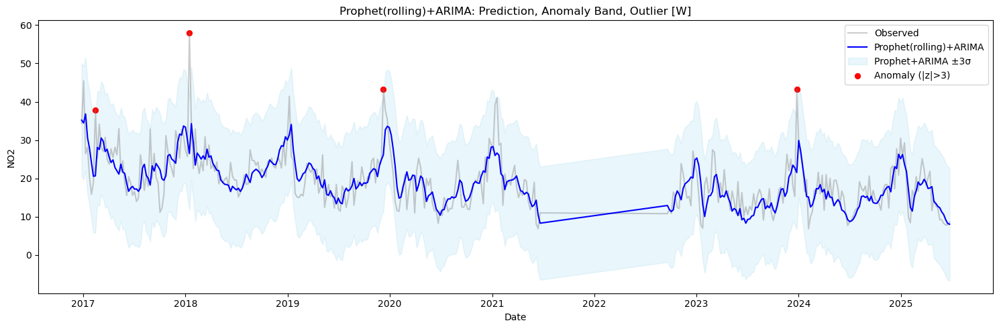

In [68]:
plot_arima_anomaly_band(df_shn_weekly_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='W')


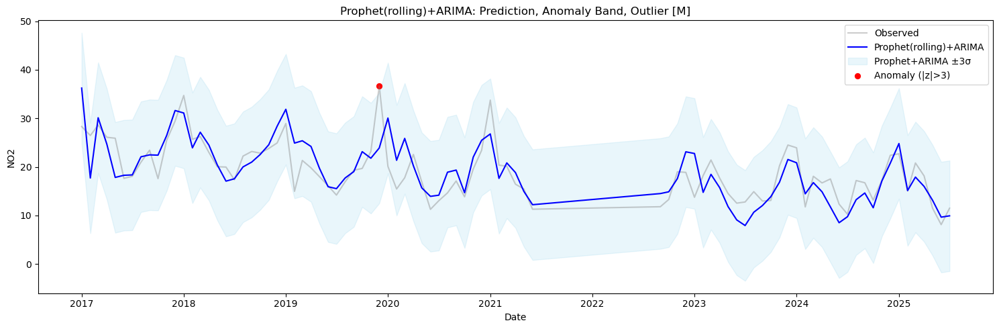

In [69]:
plot_arima_anomaly_band(df_shn_monthly_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='M')


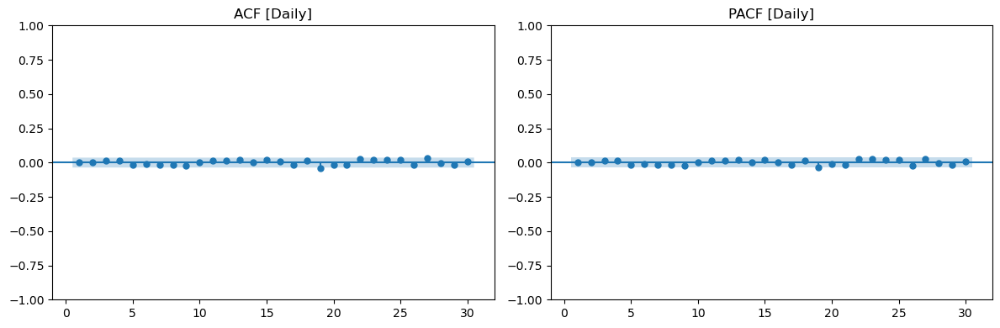

Ljung-Box Test [Daily] (using lags [10, 20, 30]):
      lb_stat  lb_pvalue
10   5.217912   0.876154
20  15.899459   0.722842
30  27.724070   0.585056



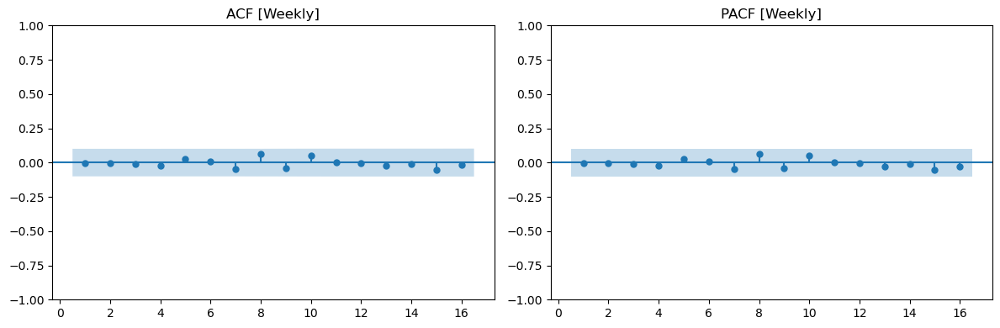

Ljung-Box Test [Weekly] (using lags [8, 12, 16]):
     lb_stat  lb_pvalue
8   2.782799   0.947240
12  4.433024   0.974296
16  5.989764   0.988206



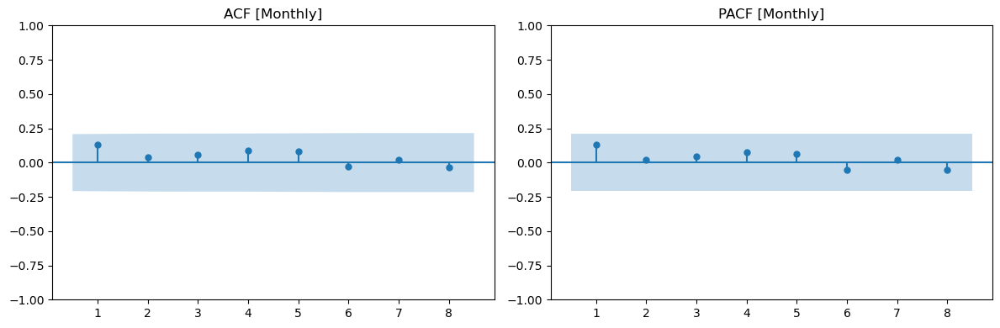

Ljung-Box Test [Monthly] (using lags [4, 8]):
    lb_stat  lb_pvalue
4  2.727404   0.604428
8  3.627136   0.889102



In [70]:
# Daily residual
residual_diagnostics(df_shn_daily_result_aqicn, lags=[10,20,30], title='[Daily]')
# Weekly residual
residual_diagnostics(df_shn_weekly_result_aqicn, lags=[8,12,16], title='[Weekly]')
# Monthly residual
residual_diagnostics(df_shn_monthly_result_aqicn, lags=[4,8], title='[Monthly]')

22:31:05 - cmdstanpy - INFO - Chain [1] start processing
22:31:05 - cmdstanpy - INFO - Chain [1] done processing
22:31:05 - cmdstanpy - INFO - Chain [1] start processing
22:31:05 - cmdstanpy - INFO - Chain [1] done processing
22:31:06 - cmdstanpy - INFO - Chain [1] start processing
22:31:06 - cmdstanpy - INFO - Chain [1] done processing
22:31:06 - cmdstanpy - INFO - Chain [1] start processing
22:31:06 - cmdstanpy - INFO - Chain [1] done processing
22:31:06 - cmdstanpy - INFO - Chain [1] start processing
22:31:06 - cmdstanpy - INFO - Chain [1] done processing
22:31:06 - cmdstanpy - INFO - Chain [1] start processing
22:31:06 - cmdstanpy - INFO - Chain [1] done processing
22:31:07 - cmdstanpy - INFO - Chain [1] start processing
22:31:07 - cmdstanpy - INFO - Chain [1] done processing
22:31:07 - cmdstanpy - INFO - Chain [1] start processing
22:31:07 - cmdstanpy - INFO - Chain [1] done processing
22:31:07 - cmdstanpy - INFO - Chain [1] start processing
22:31:07 - cmdstanpy - INFO - Chain [1]

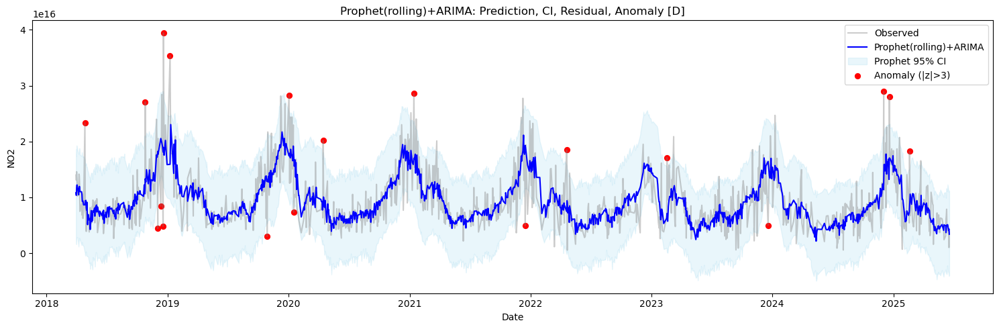

22:31:31 - cmdstanpy - INFO - Chain [1] start processing
22:31:31 - cmdstanpy - INFO - Chain [1] done processing
22:31:31 - cmdstanpy - INFO - Chain [1] start processing
22:31:31 - cmdstanpy - INFO - Chain [1] done processing
22:31:31 - cmdstanpy - INFO - Chain [1] start processing
22:31:31 - cmdstanpy - INFO - Chain [1] done processing
22:31:31 - cmdstanpy - INFO - Chain [1] start processing
22:31:31 - cmdstanpy - INFO - Chain [1] done processing
22:31:32 - cmdstanpy - INFO - Chain [1] start processing
22:31:32 - cmdstanpy - INFO - Chain [1] done processing
22:31:32 - cmdstanpy - INFO - Chain [1] start processing
22:31:32 - cmdstanpy - INFO - Chain [1] done processing
22:31:32 - cmdstanpy - INFO - Chain [1] start processing
22:31:32 - cmdstanpy - INFO - Chain [1] done processing
22:31:32 - cmdstanpy - INFO - Chain [1] start processing
22:31:32 - cmdstanpy - INFO - Chain [1] done processing
22:31:32 - cmdstanpy - INFO - Chain [1] start processing
22:31:32 - cmdstanpy - INFO - Chain [1]

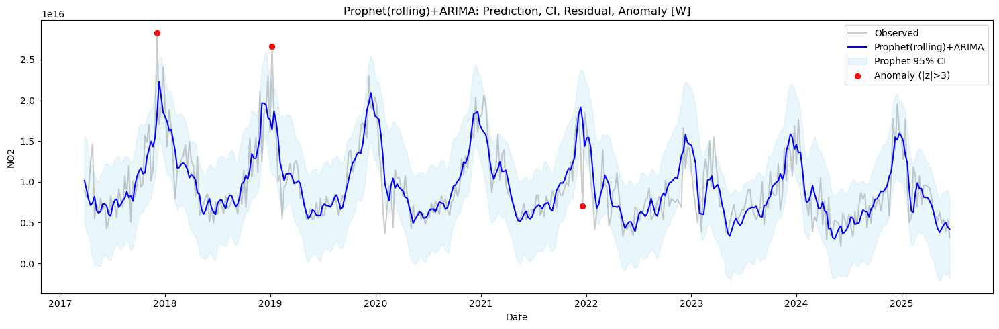

22:31:50 - cmdstanpy - INFO - Chain [1] start processing
22:31:50 - cmdstanpy - INFO - Chain [1] done processing
22:31:50 - cmdstanpy - INFO - Chain [1] start processing
22:31:51 - cmdstanpy - INFO - Chain [1] done processing
22:31:51 - cmdstanpy - INFO - Chain [1] start processing
22:31:51 - cmdstanpy - INFO - Chain [1] done processing
22:31:51 - cmdstanpy - INFO - Chain [1] start processing
22:31:51 - cmdstanpy - INFO - Chain [1] done processing
22:31:51 - cmdstanpy - INFO - Chain [1] start processing
22:31:52 - cmdstanpy - INFO - Chain [1] done processing
22:31:52 - cmdstanpy - INFO - Chain [1] start processing
22:31:52 - cmdstanpy - INFO - Chain [1] done processing
22:31:52 - cmdstanpy - INFO - Chain [1] start processing
22:31:52 - cmdstanpy - INFO - Chain [1] done processing
22:31:53 - cmdstanpy - INFO - Chain [1] start processing
22:31:53 - cmdstanpy - INFO - Chain [1] done processing
22:31:53 - cmdstanpy - INFO - Chain [1] start processing
22:31:53 - cmdstanpy - INFO - Chain [1]

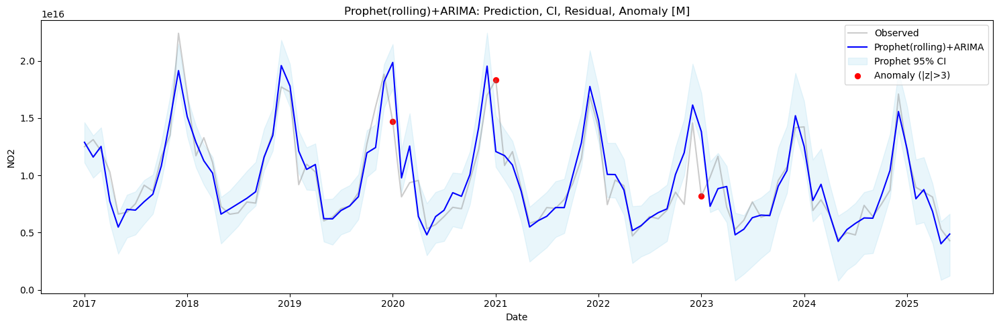

In [71]:
df_shn_daily_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_shn_NASA, freq='D',pollutant='NO2'), pollutant='NO2',
    train_steps=730, test_steps=30, step=30, z_thresh=3, freq='D', plot=True
)
df_shn_weekly_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_shn_NASA, freq='W',pollutant='NO2'), pollutant='NO2',
    train_steps=156, test_steps=8, step=4, z_thresh=3, freq='W', plot=True
)
df_shn_monthly_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_shn_NASA, freq='M',pollutant='NO2'), pollutant='NO2',
    train_steps=36, test_steps=4, step=1, z_thresh=3, freq='M', plot=True
)

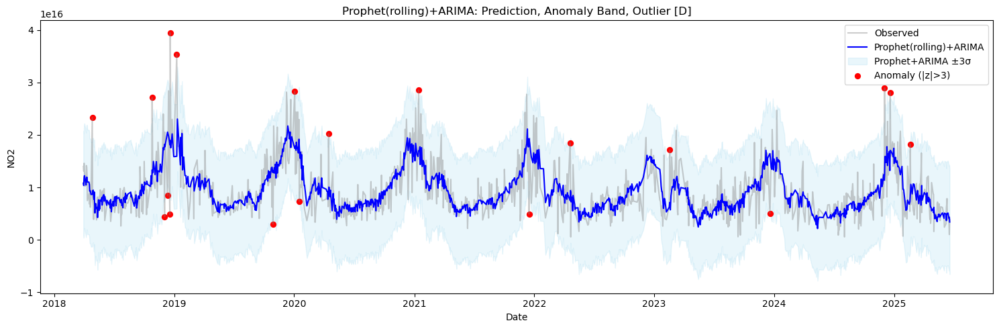

In [72]:
plot_arima_anomaly_band(df_shn_daily_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='D')


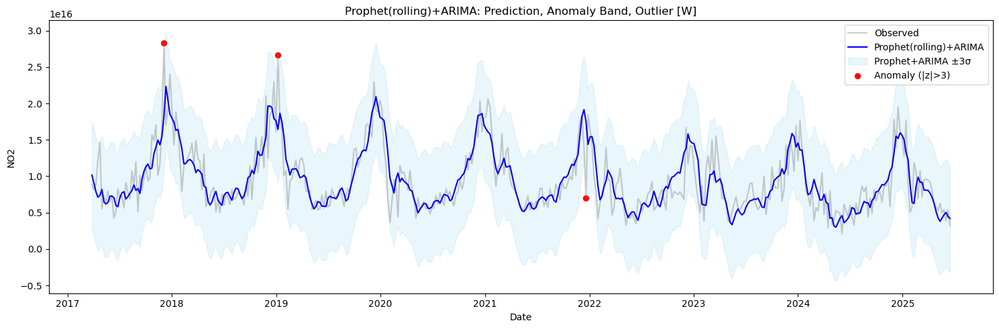

In [73]:
plot_arima_anomaly_band(df_shn_weekly_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='W')


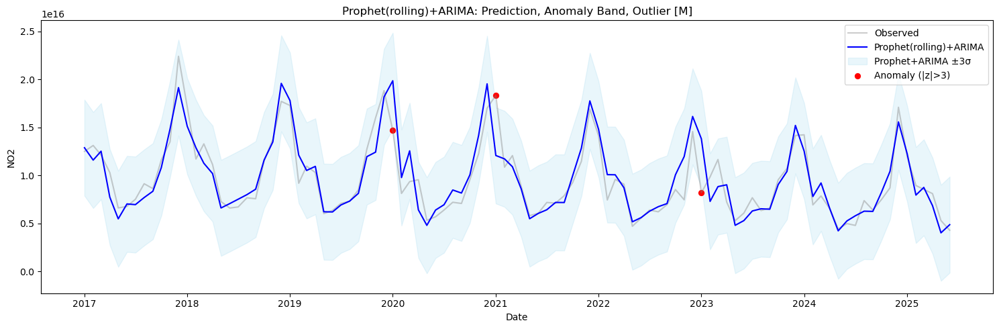

In [74]:
plot_arima_anomaly_band(df_shn_monthly_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='M')


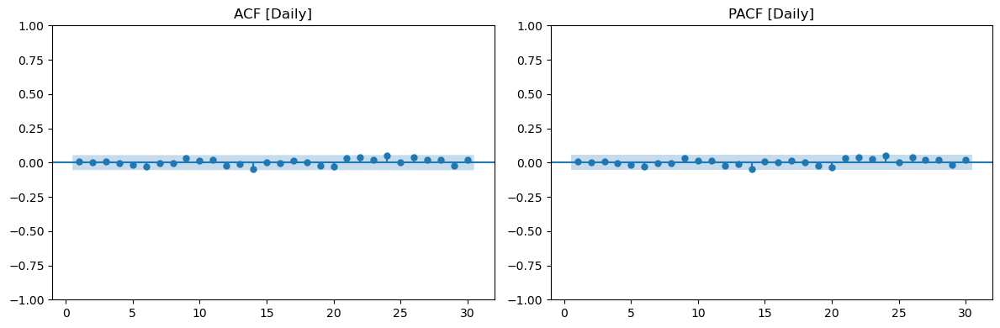

Ljung-Box Test [Daily] (using lags [10, 20, 30]):
      lb_stat  lb_pvalue
10   3.286190   0.973865
20   9.601699   0.974833
30  21.015441   0.887404



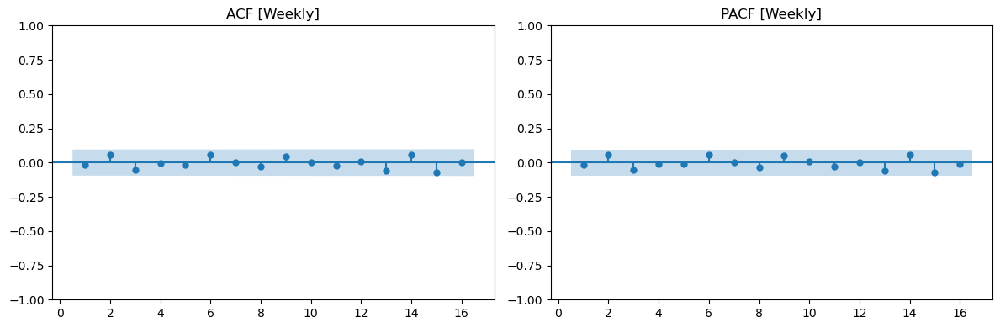

Ljung-Box Test [Weekly] (using lags [8, 12, 16]):
      lb_stat  lb_pvalue
8    4.483259   0.811106
12   5.572007   0.936104
16  10.814879   0.820765



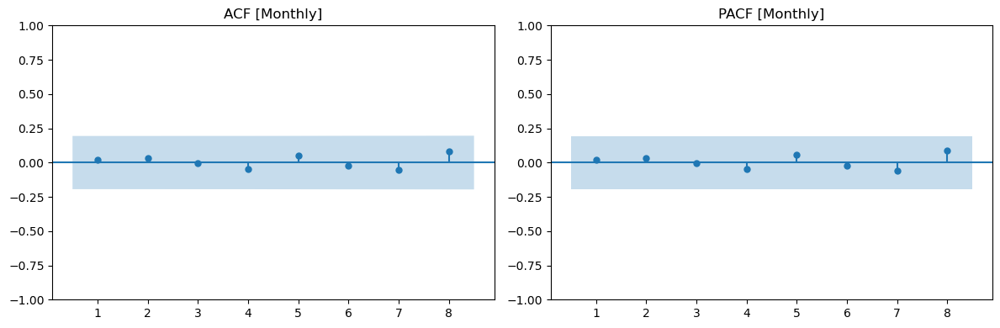

Ljung-Box Test [Monthly] (using lags [4, 8]):
    lb_stat  lb_pvalue
4  0.394564   0.982920
8  1.863808   0.984906



In [75]:
# Daily residual
residual_diagnostics(df_shn_daily_result_nasa, lags=[10,20,30], title='[Daily]')
# Weekly residual
residual_diagnostics(df_shn_weekly_result_nasa, lags=[8,12,16], title='[Weekly]')
# Monthly residual
residual_diagnostics(df_shn_monthly_result_nasa, lags=[4,8], title='[Monthly]')

# shouzhou

In [76]:
df_shu_AQICN = pd.read_csv("data/aqicn/shuozhou.csv")
df_shu_AQICN = change_df(df_shu_AQICN)
df_shu_NASA = pd.read_csv('data/nasa_data/shuozhouNO2.csv')
df_shu_NASA = cleaning_NASA_data(df_shu_NASA,'NO2')

22:32:22 - cmdstanpy - INFO - Chain [1] start processing
22:32:22 - cmdstanpy - INFO - Chain [1] done processing
22:32:22 - cmdstanpy - INFO - Chain [1] start processing
22:32:22 - cmdstanpy - INFO - Chain [1] done processing
22:32:22 - cmdstanpy - INFO - Chain [1] start processing
22:32:22 - cmdstanpy - INFO - Chain [1] done processing
22:32:22 - cmdstanpy - INFO - Chain [1] start processing
22:32:23 - cmdstanpy - INFO - Chain [1] done processing
22:32:23 - cmdstanpy - INFO - Chain [1] start processing
22:32:23 - cmdstanpy - INFO - Chain [1] done processing
22:32:23 - cmdstanpy - INFO - Chain [1] start processing
22:32:23 - cmdstanpy - INFO - Chain [1] done processing
22:32:23 - cmdstanpy - INFO - Chain [1] start processing
22:32:23 - cmdstanpy - INFO - Chain [1] done processing
22:32:23 - cmdstanpy - INFO - Chain [1] start processing
22:32:23 - cmdstanpy - INFO - Chain [1] done processing
22:32:24 - cmdstanpy - INFO - Chain [1] start processing
22:32:24 - cmdstanpy - INFO - Chain [1]

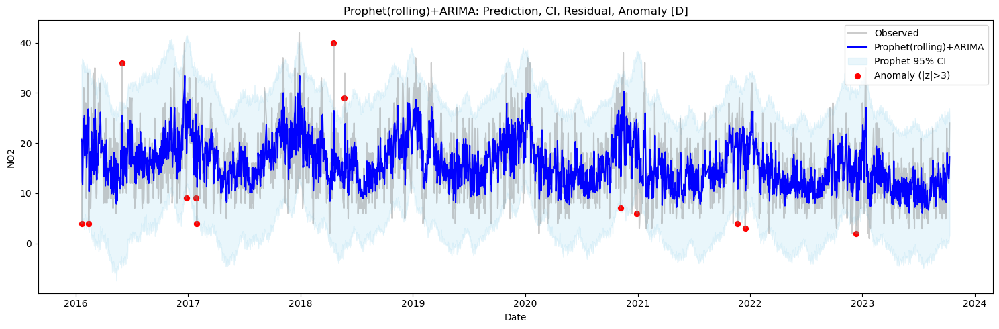

22:33:02 - cmdstanpy - INFO - Chain [1] start processing
22:33:03 - cmdstanpy - INFO - Chain [1] done processing
22:33:03 - cmdstanpy - INFO - Chain [1] start processing
22:33:03 - cmdstanpy - INFO - Chain [1] done processing
22:33:03 - cmdstanpy - INFO - Chain [1] start processing
22:33:03 - cmdstanpy - INFO - Chain [1] done processing
22:33:03 - cmdstanpy - INFO - Chain [1] start processing
22:33:03 - cmdstanpy - INFO - Chain [1] done processing
22:33:03 - cmdstanpy - INFO - Chain [1] start processing
22:33:03 - cmdstanpy - INFO - Chain [1] done processing
22:33:03 - cmdstanpy - INFO - Chain [1] start processing
22:33:03 - cmdstanpy - INFO - Chain [1] done processing
22:33:03 - cmdstanpy - INFO - Chain [1] start processing
22:33:03 - cmdstanpy - INFO - Chain [1] done processing
22:33:04 - cmdstanpy - INFO - Chain [1] start processing
22:33:04 - cmdstanpy - INFO - Chain [1] done processing
22:33:04 - cmdstanpy - INFO - Chain [1] start processing
22:33:04 - cmdstanpy - INFO - Chain [1]

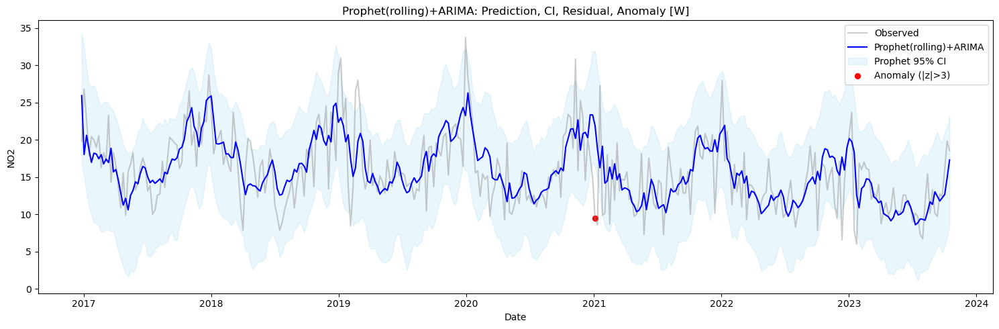

22:33:20 - cmdstanpy - INFO - Chain [1] start processing
22:33:20 - cmdstanpy - INFO - Chain [1] done processing
22:33:20 - cmdstanpy - INFO - Chain [1] start processing
22:33:20 - cmdstanpy - INFO - Chain [1] done processing
22:33:21 - cmdstanpy - INFO - Chain [1] start processing
22:33:21 - cmdstanpy - INFO - Chain [1] done processing
22:33:21 - cmdstanpy - INFO - Chain [1] start processing
22:33:21 - cmdstanpy - INFO - Chain [1] done processing
22:33:21 - cmdstanpy - INFO - Chain [1] start processing
22:33:21 - cmdstanpy - INFO - Chain [1] done processing
22:33:21 - cmdstanpy - INFO - Chain [1] start processing
22:33:22 - cmdstanpy - INFO - Chain [1] done processing
22:33:22 - cmdstanpy - INFO - Chain [1] start processing
22:33:22 - cmdstanpy - INFO - Chain [1] done processing
22:33:22 - cmdstanpy - INFO - Chain [1] start processing
22:33:22 - cmdstanpy - INFO - Chain [1] done processing
22:33:22 - cmdstanpy - INFO - Chain [1] start processing
22:33:23 - cmdstanpy - INFO - Chain [1]

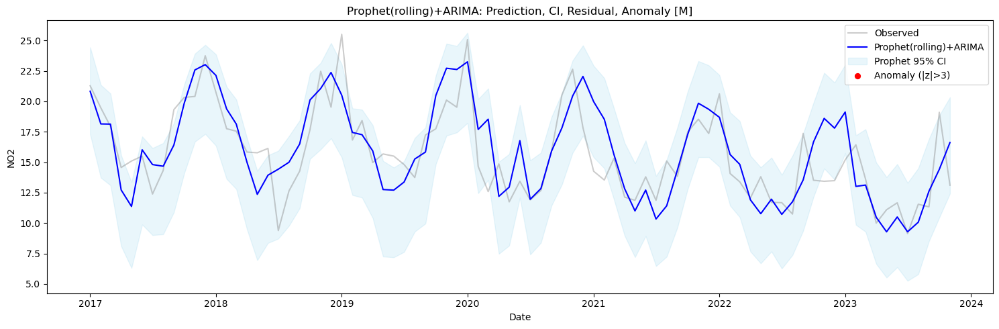

In [77]:
df_shu_daily_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_shu_AQICN, freq='D',pollutant='NO2'), pollutant='NO2',
    train_steps=730, test_steps=30, step=30, z_thresh=3, freq='D', plot=True
)
df_shu_weekly_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_shu_AQICN, freq='W',pollutant='NO2'), pollutant='NO2',
    train_steps=156, test_steps=8, step=4, z_thresh=3, freq='W', plot=True
)
df_shu_monthly_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_shu_AQICN, freq='M',pollutant='NO2'), pollutant='NO2',
    train_steps=36, test_steps=4, step=1, z_thresh=3, freq='M', plot=True
)

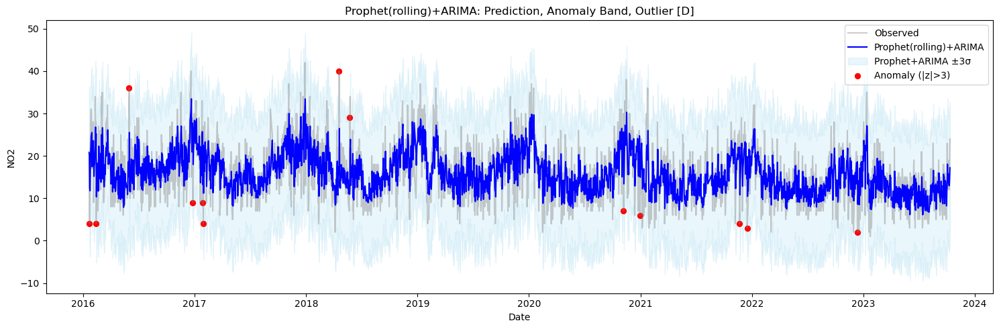

In [78]:
plot_arima_anomaly_band(df_shu_daily_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='D')

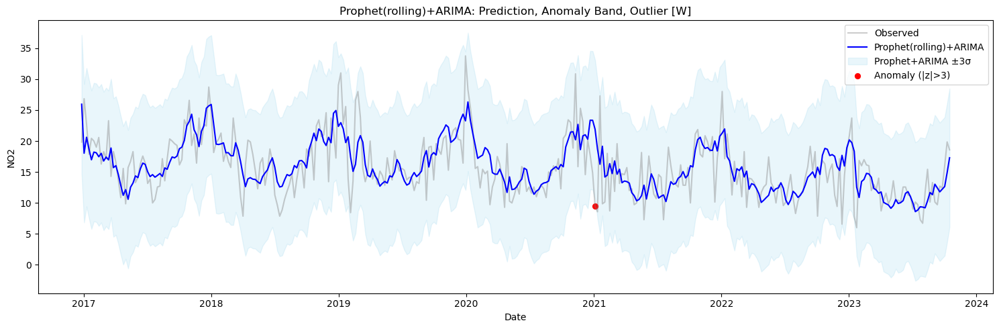

In [79]:
plot_arima_anomaly_band(df_shu_weekly_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='W')


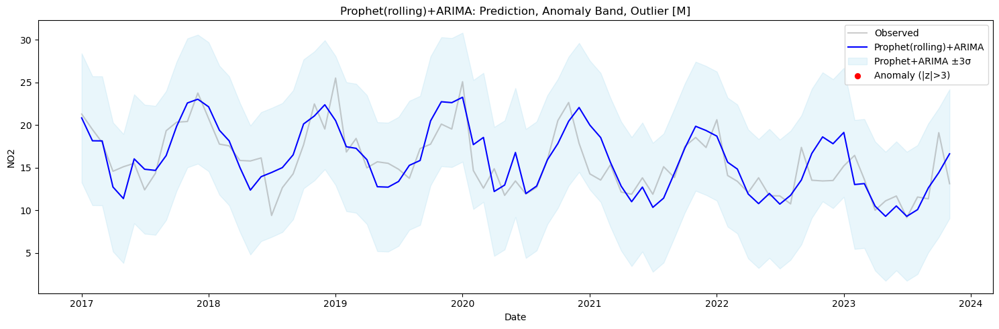

In [80]:
plot_arima_anomaly_band(df_shu_monthly_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='M')


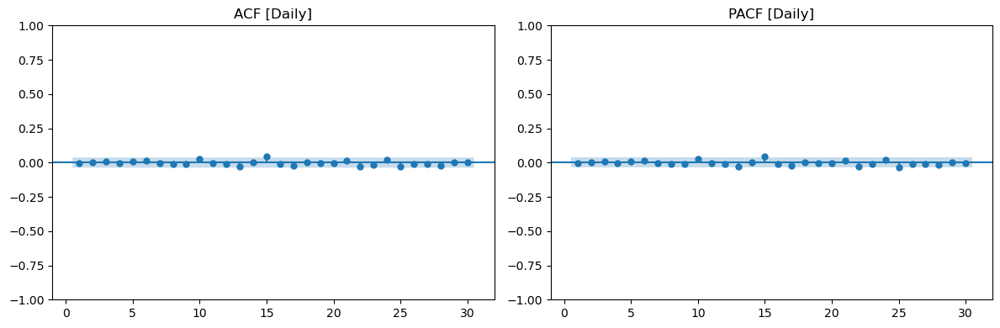

Ljung-Box Test [Daily] (using lags [10, 20, 30]):
      lb_stat  lb_pvalue
10   4.049991   0.945064
20  13.584484   0.850923
30  22.646602   0.829505



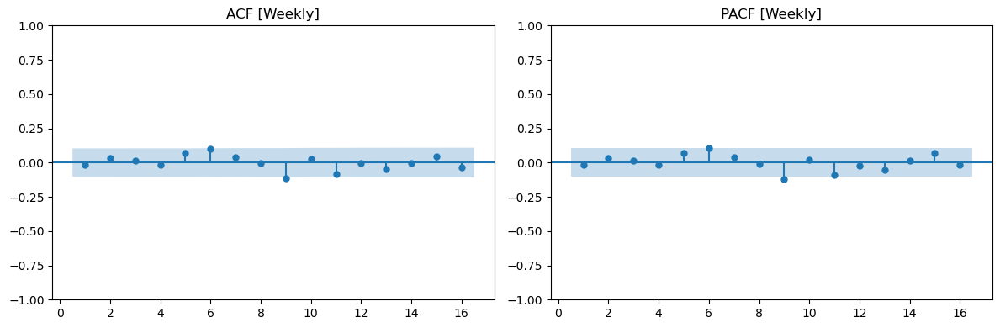

Ljung-Box Test [Weekly] (using lags [8, 12, 16]):
      lb_stat  lb_pvalue
8    6.705825   0.568679
12  14.376308   0.277326
16  16.347912   0.428954



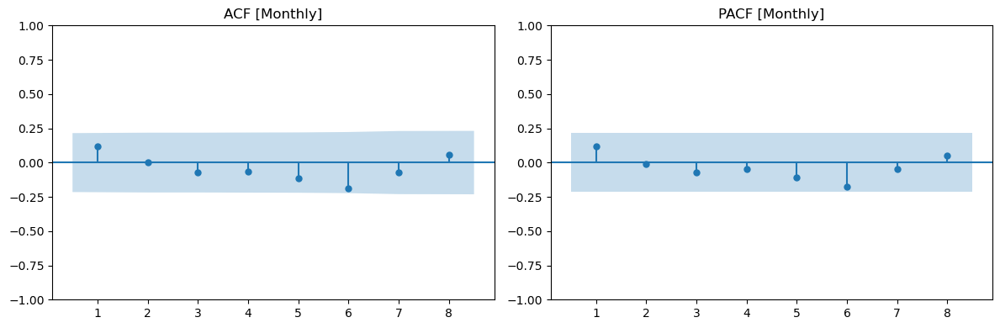

Ljung-Box Test [Monthly] (using lags [4, 8]):
    lb_stat  lb_pvalue
4  2.039005   0.728585
8  7.387651   0.495443



In [81]:
# Daily residual
residual_diagnostics(df_shu_daily_result_aqicn, lags=[10,20,30], title='[Daily]')
# Weekly residual
residual_diagnostics(df_shu_weekly_result_aqicn, lags=[8,12,16], title='[Weekly]')
# Monthly residual
residual_diagnostics(df_shu_monthly_result_aqicn, lags=[4,8], title='[Monthly]')

22:33:49 - cmdstanpy - INFO - Chain [1] start processing
22:33:49 - cmdstanpy - INFO - Chain [1] done processing
22:33:49 - cmdstanpy - INFO - Chain [1] start processing
22:33:49 - cmdstanpy - INFO - Chain [1] done processing
22:33:49 - cmdstanpy - INFO - Chain [1] start processing
22:33:49 - cmdstanpy - INFO - Chain [1] done processing
22:33:49 - cmdstanpy - INFO - Chain [1] start processing
22:33:49 - cmdstanpy - INFO - Chain [1] done processing
22:33:50 - cmdstanpy - INFO - Chain [1] start processing
22:33:50 - cmdstanpy - INFO - Chain [1] done processing
22:33:50 - cmdstanpy - INFO - Chain [1] start processing
22:33:50 - cmdstanpy - INFO - Chain [1] done processing
22:33:50 - cmdstanpy - INFO - Chain [1] start processing
22:33:50 - cmdstanpy - INFO - Chain [1] done processing
22:33:50 - cmdstanpy - INFO - Chain [1] start processing
22:33:50 - cmdstanpy - INFO - Chain [1] done processing
22:33:51 - cmdstanpy - INFO - Chain [1] start processing
22:33:51 - cmdstanpy - INFO - Chain [1]

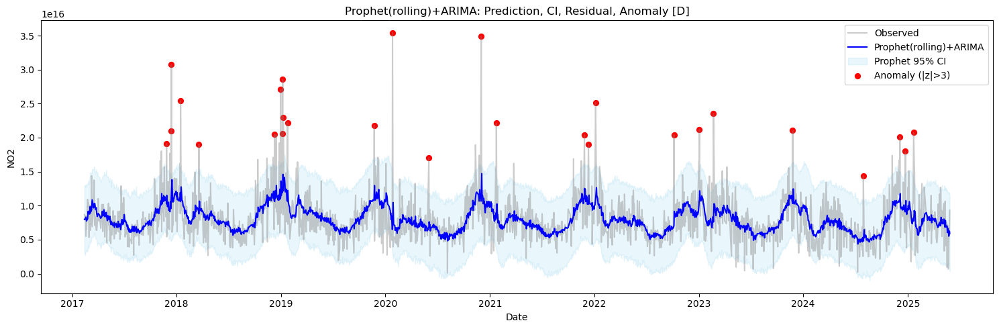

22:34:12 - cmdstanpy - INFO - Chain [1] start processing
22:34:12 - cmdstanpy - INFO - Chain [1] done processing
22:34:12 - cmdstanpy - INFO - Chain [1] start processing
22:34:12 - cmdstanpy - INFO - Chain [1] done processing
22:34:12 - cmdstanpy - INFO - Chain [1] start processing
22:34:12 - cmdstanpy - INFO - Chain [1] done processing
22:34:12 - cmdstanpy - INFO - Chain [1] start processing
22:34:12 - cmdstanpy - INFO - Chain [1] done processing
22:34:12 - cmdstanpy - INFO - Chain [1] start processing
22:34:13 - cmdstanpy - INFO - Chain [1] done processing
22:34:13 - cmdstanpy - INFO - Chain [1] start processing
22:34:13 - cmdstanpy - INFO - Chain [1] done processing
22:34:13 - cmdstanpy - INFO - Chain [1] start processing
22:34:13 - cmdstanpy - INFO - Chain [1] done processing
22:34:13 - cmdstanpy - INFO - Chain [1] start processing
22:34:13 - cmdstanpy - INFO - Chain [1] done processing
22:34:13 - cmdstanpy - INFO - Chain [1] start processing
22:34:13 - cmdstanpy - INFO - Chain [1]

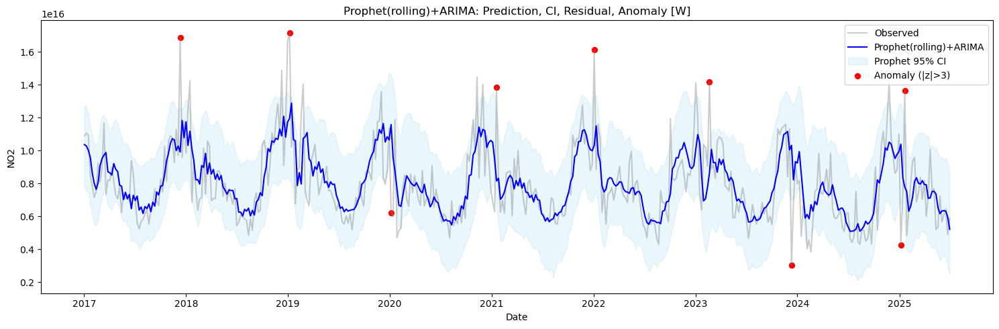

22:34:35 - cmdstanpy - INFO - Chain [1] start processing
22:34:35 - cmdstanpy - INFO - Chain [1] done processing
22:34:35 - cmdstanpy - INFO - Chain [1] start processing
22:34:35 - cmdstanpy - INFO - Chain [1] done processing
22:34:35 - cmdstanpy - INFO - Chain [1] start processing
22:34:36 - cmdstanpy - INFO - Chain [1] done processing
22:34:36 - cmdstanpy - INFO - Chain [1] start processing
22:34:36 - cmdstanpy - INFO - Chain [1] done processing
22:34:36 - cmdstanpy - INFO - Chain [1] start processing
22:34:36 - cmdstanpy - INFO - Chain [1] done processing
22:34:36 - cmdstanpy - INFO - Chain [1] start processing
22:34:37 - cmdstanpy - INFO - Chain [1] done processing
22:34:37 - cmdstanpy - INFO - Chain [1] start processing
22:34:37 - cmdstanpy - INFO - Chain [1] done processing
22:34:37 - cmdstanpy - INFO - Chain [1] start processing
22:34:37 - cmdstanpy - INFO - Chain [1] done processing
22:34:37 - cmdstanpy - INFO - Chain [1] start processing
22:34:38 - cmdstanpy - INFO - Chain [1]

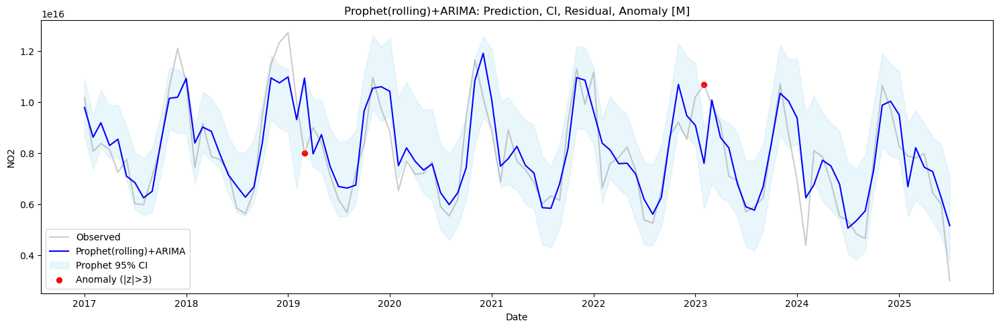

In [82]:
df_shu_daily_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_shu_NASA, freq='D',pollutant='NO2'), pollutant='NO2',
    train_steps=730, test_steps=30, step=30, z_thresh=3, freq='D', plot=True
)
df_shu_weekly_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_shu_NASA, freq='W',pollutant='NO2'), pollutant='NO2',
    train_steps=156, test_steps=8, step=4, z_thresh=3, freq='W', plot=True
)
df_shu_monthly_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_shu_NASA, freq='M',pollutant='NO2'), pollutant='NO2',
    train_steps=36, test_steps=4, step=1, z_thresh=3, freq='M', plot=True
)

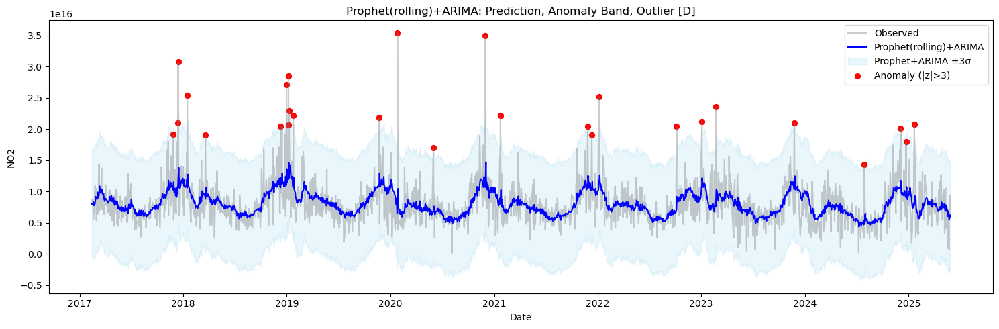

In [83]:
plot_arima_anomaly_band(df_shu_daily_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='D')


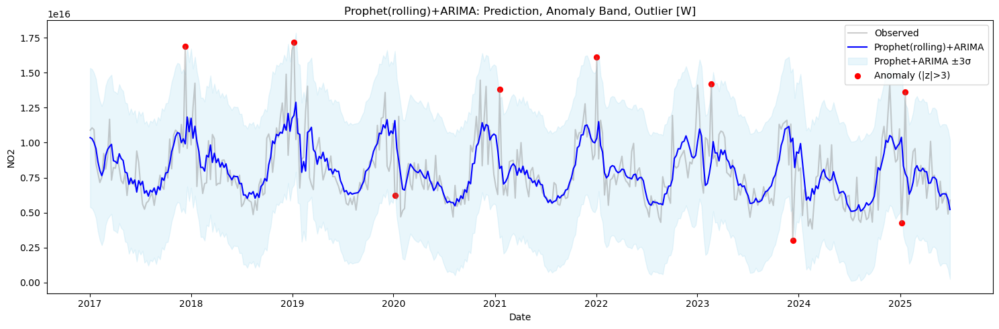

In [84]:
plot_arima_anomaly_band(df_shu_weekly_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='W')


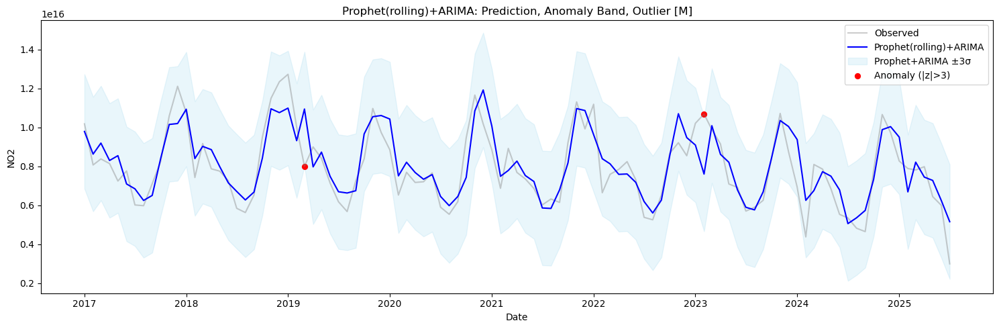

In [85]:
plot_arima_anomaly_band(df_shu_monthly_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='M')


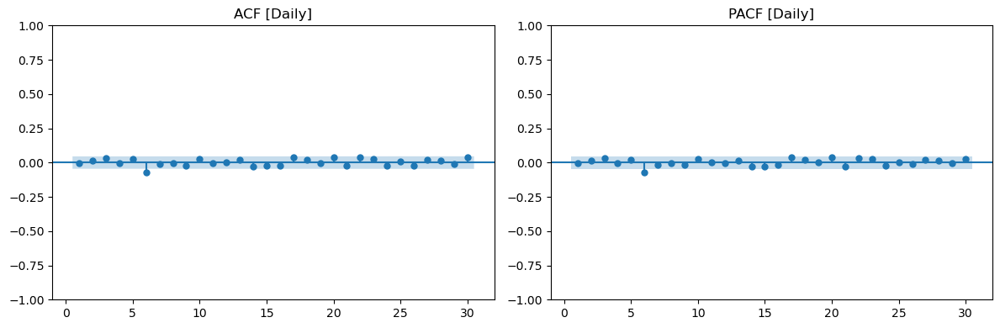

Ljung-Box Test [Daily] (using lags [10, 20, 30]):
      lb_stat  lb_pvalue
10  14.946073   0.134040
20  25.708152   0.175669
30  37.481248   0.163528



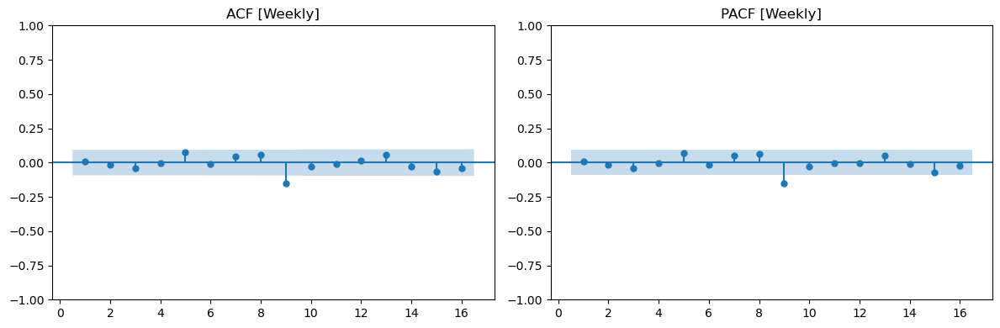

Ljung-Box Test [Weekly] (using lags [8, 12, 16]):
      lb_stat  lb_pvalue
8    5.913035   0.656973
12  17.087370   0.146340
16  21.737917   0.151857



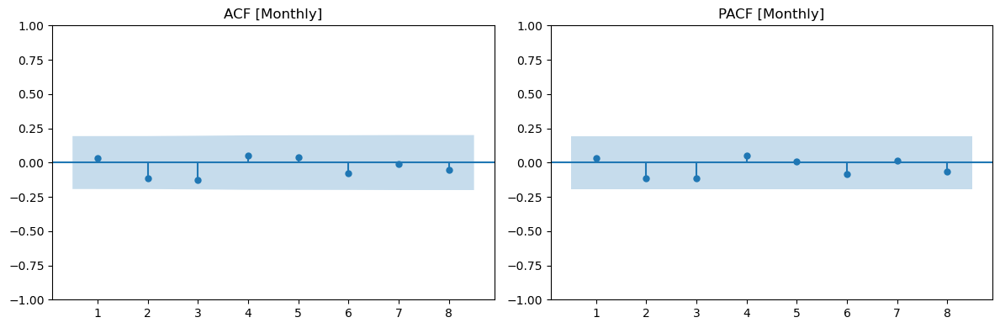

Ljung-Box Test [Monthly] (using lags [4, 8]):
    lb_stat  lb_pvalue
4  3.466821   0.482941
8  4.621615   0.797146



In [86]:
# Daily residual
residual_diagnostics(df_shu_daily_result_nasa, lags=[10,20,30], title='[Daily]')
# Weekly residual
residual_diagnostics(df_shu_weekly_result_nasa, lags=[8,12,16], title='[Weekly]')
# Monthly residual
residual_diagnostics(df_shu_monthly_result_nasa, lags=[4,8], title='[Monthly]')

# wuhan

In [87]:
df_whn_AQICN = pd.read_csv("data/aqicn/wuhan.csv")
df_whn_AQICN = change_df(df_whn_AQICN)
df_whn_NASA = pd.read_csv('data/nasa_data/wuhanNO2.csv')
df_whn_NASA = cleaning_NASA_data(df_whn_NASA,'NO2')

22:35:05 - cmdstanpy - INFO - Chain [1] start processing
22:35:06 - cmdstanpy - INFO - Chain [1] done processing
22:35:06 - cmdstanpy - INFO - Chain [1] start processing
22:35:06 - cmdstanpy - INFO - Chain [1] done processing
22:35:06 - cmdstanpy - INFO - Chain [1] start processing
22:35:06 - cmdstanpy - INFO - Chain [1] done processing
22:35:06 - cmdstanpy - INFO - Chain [1] start processing
22:35:06 - cmdstanpy - INFO - Chain [1] done processing
22:35:06 - cmdstanpy - INFO - Chain [1] start processing
22:35:06 - cmdstanpy - INFO - Chain [1] done processing
22:35:07 - cmdstanpy - INFO - Chain [1] start processing
22:35:07 - cmdstanpy - INFO - Chain [1] done processing
22:35:07 - cmdstanpy - INFO - Chain [1] start processing
22:35:07 - cmdstanpy - INFO - Chain [1] done processing
22:35:07 - cmdstanpy - INFO - Chain [1] start processing
22:35:07 - cmdstanpy - INFO - Chain [1] done processing
22:35:07 - cmdstanpy - INFO - Chain [1] start processing
22:35:07 - cmdstanpy - INFO - Chain [1]

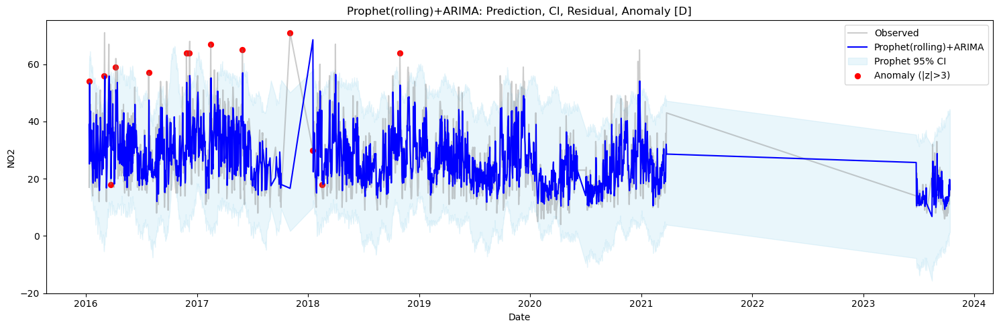

22:35:28 - cmdstanpy - INFO - Chain [1] start processing
22:35:28 - cmdstanpy - INFO - Chain [1] done processing
22:35:28 - cmdstanpy - INFO - Chain [1] start processing
22:35:28 - cmdstanpy - INFO - Chain [1] done processing
22:35:28 - cmdstanpy - INFO - Chain [1] start processing
22:35:28 - cmdstanpy - INFO - Chain [1] done processing
22:35:29 - cmdstanpy - INFO - Chain [1] start processing
22:35:29 - cmdstanpy - INFO - Chain [1] done processing
22:35:29 - cmdstanpy - INFO - Chain [1] start processing
22:35:29 - cmdstanpy - INFO - Chain [1] done processing
22:35:29 - cmdstanpy - INFO - Chain [1] start processing
22:35:29 - cmdstanpy - INFO - Chain [1] done processing
22:35:29 - cmdstanpy - INFO - Chain [1] start processing
22:35:29 - cmdstanpy - INFO - Chain [1] done processing
22:35:29 - cmdstanpy - INFO - Chain [1] start processing
22:35:29 - cmdstanpy - INFO - Chain [1] done processing
22:35:29 - cmdstanpy - INFO - Chain [1] start processing
22:35:29 - cmdstanpy - INFO - Chain [1]

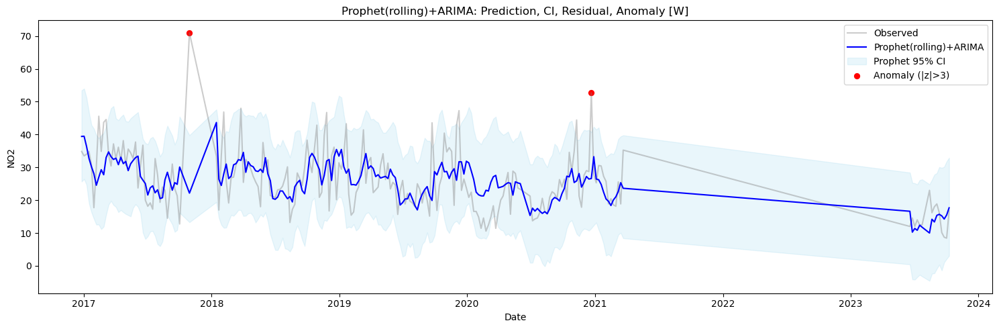

22:35:38 - cmdstanpy - INFO - Chain [1] start processing
22:35:38 - cmdstanpy - INFO - Chain [1] done processing
22:35:38 - cmdstanpy - INFO - Chain [1] start processing
22:35:38 - cmdstanpy - INFO - Chain [1] done processing
22:35:38 - cmdstanpy - INFO - Chain [1] start processing
22:35:38 - cmdstanpy - INFO - Chain [1] done processing
22:35:39 - cmdstanpy - INFO - Chain [1] start processing
22:35:39 - cmdstanpy - INFO - Chain [1] done processing
22:35:39 - cmdstanpy - INFO - Chain [1] start processing
22:35:39 - cmdstanpy - INFO - Chain [1] done processing
22:35:39 - cmdstanpy - INFO - Chain [1] start processing
22:35:39 - cmdstanpy - INFO - Chain [1] done processing
22:35:39 - cmdstanpy - INFO - Chain [1] start processing
22:35:40 - cmdstanpy - INFO - Chain [1] done processing
22:35:40 - cmdstanpy - INFO - Chain [1] start processing
22:35:40 - cmdstanpy - INFO - Chain [1] done processing
22:35:40 - cmdstanpy - INFO - Chain [1] start processing
22:35:40 - cmdstanpy - INFO - Chain [1]

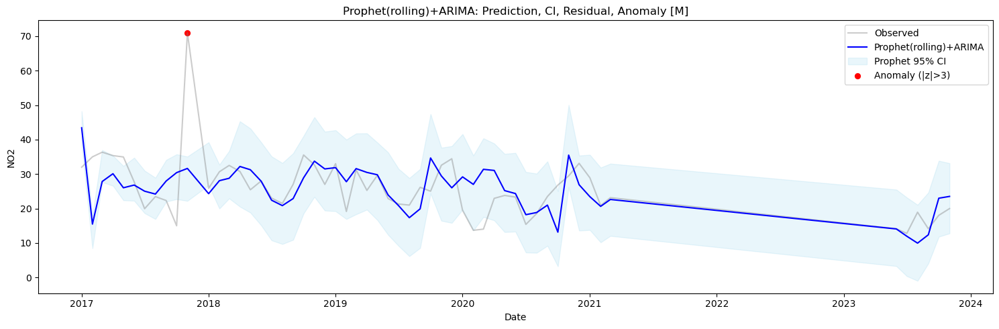

In [88]:
df_whn_daily_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_whn_AQICN, freq='D',pollutant='NO2'), pollutant='NO2',
    train_steps=730, test_steps=30, step=30, z_thresh=3, freq='D', plot=True
)
df_whn_weekly_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_whn_AQICN, freq='W',pollutant='NO2'), pollutant='NO2',
    train_steps=156, test_steps=8, step=4, z_thresh=3, freq='W', plot=True
)
df_whn_monthly_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_whn_AQICN, freq='M',pollutant='NO2'), pollutant='NO2',
    train_steps=36, test_steps=4, step=1, z_thresh=3, freq='M', plot=True
)

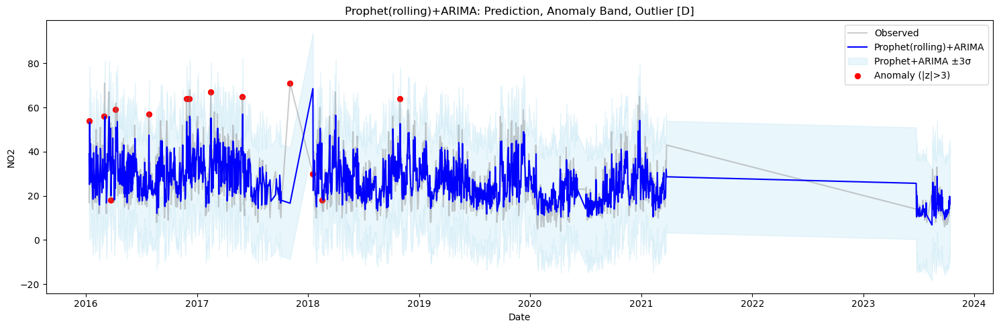

In [89]:
plot_arima_anomaly_band(df_whn_daily_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='D')

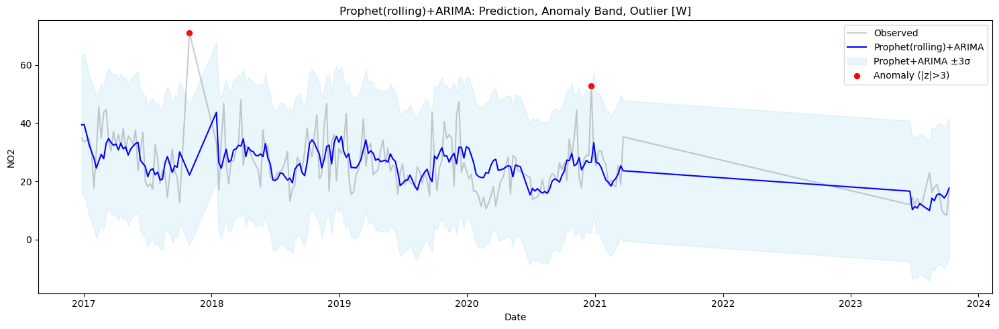

In [90]:
plot_arima_anomaly_band(df_whn_weekly_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='W')


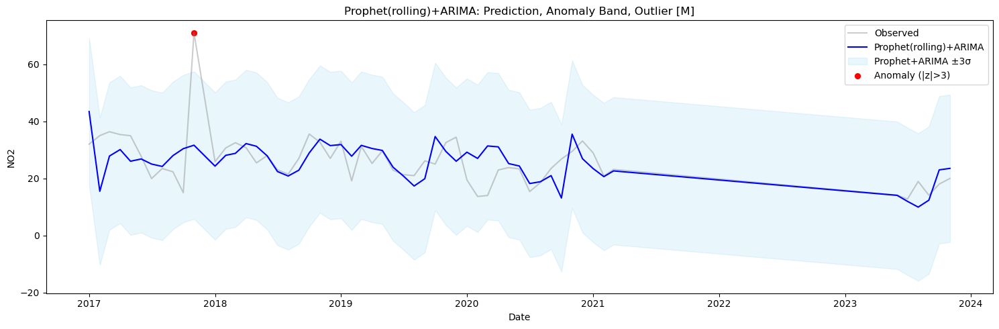

In [91]:
plot_arima_anomaly_band(df_whn_monthly_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='M')


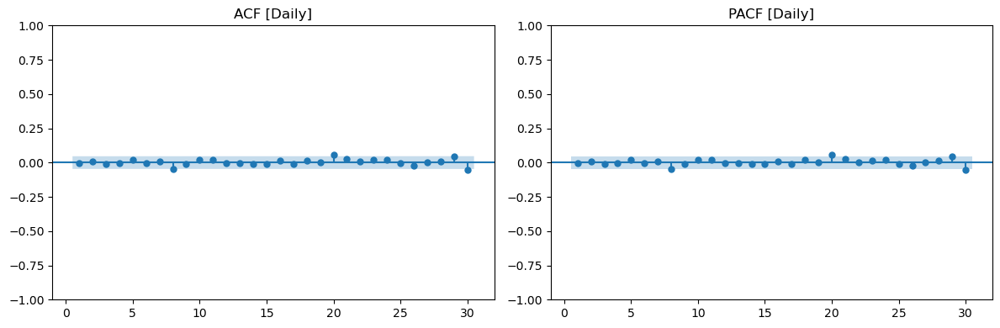

Ljung-Box Test [Daily] (using lags [10, 20, 30]):
      lb_stat  lb_pvalue
10   6.514363   0.770358
20  14.587560   0.799501
30  26.887673   0.629163



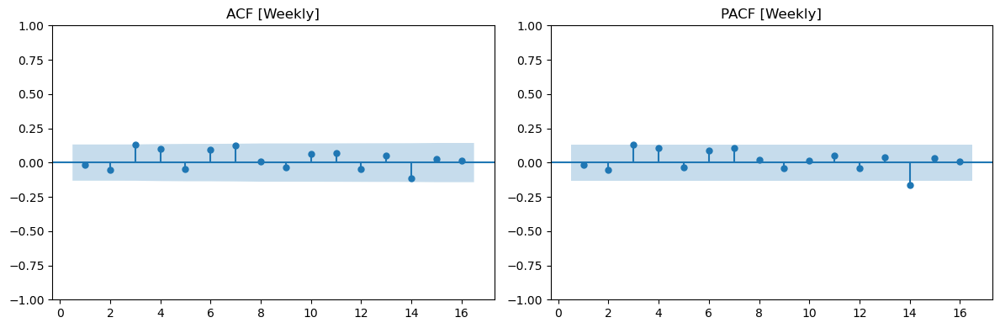

Ljung-Box Test [Weekly] (using lags [8, 12, 16]):
      lb_stat  lb_pvalue
8   13.165509   0.106280
12  15.886250   0.196502
16  19.905565   0.224504



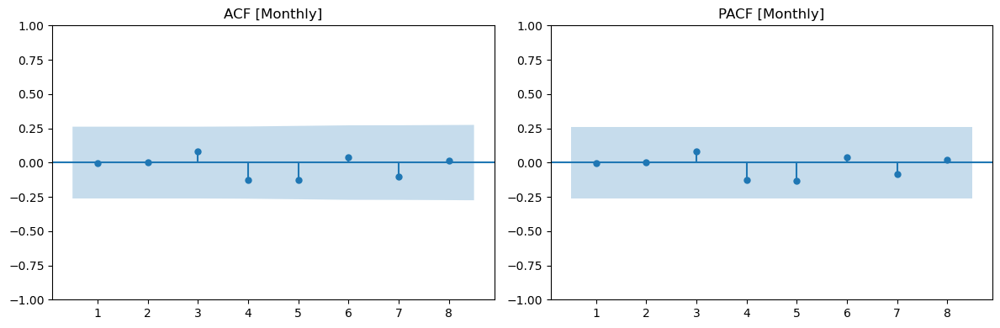

Ljung-Box Test [Monthly] (using lags [4, 8]):
    lb_stat  lb_pvalue
4  1.388871   0.846127
8  3.253284   0.917472



In [92]:
# Daily residual
residual_diagnostics(df_whn_daily_result_aqicn, lags=[10,20,30], title='[Daily]')
# Weekly residual
residual_diagnostics(df_whn_weekly_result_aqicn, lags=[8,12,16], title='[Weekly]')
# Monthly residual
residual_diagnostics(df_whn_monthly_result_aqicn, lags=[4,8], title='[Monthly]')

22:35:56 - cmdstanpy - INFO - Chain [1] start processing
22:35:56 - cmdstanpy - INFO - Chain [1] done processing
22:35:56 - cmdstanpy - INFO - Chain [1] start processing
22:35:56 - cmdstanpy - INFO - Chain [1] done processing
22:35:56 - cmdstanpy - INFO - Chain [1] start processing
22:35:56 - cmdstanpy - INFO - Chain [1] done processing
22:35:56 - cmdstanpy - INFO - Chain [1] start processing
22:35:56 - cmdstanpy - INFO - Chain [1] done processing
22:35:56 - cmdstanpy - INFO - Chain [1] start processing
22:35:56 - cmdstanpy - INFO - Chain [1] done processing
22:35:57 - cmdstanpy - INFO - Chain [1] start processing
22:35:57 - cmdstanpy - INFO - Chain [1] done processing
22:35:57 - cmdstanpy - INFO - Chain [1] start processing
22:35:57 - cmdstanpy - INFO - Chain [1] done processing
22:35:57 - cmdstanpy - INFO - Chain [1] start processing
22:35:57 - cmdstanpy - INFO - Chain [1] done processing
22:35:57 - cmdstanpy - INFO - Chain [1] start processing
22:35:57 - cmdstanpy - INFO - Chain [1]

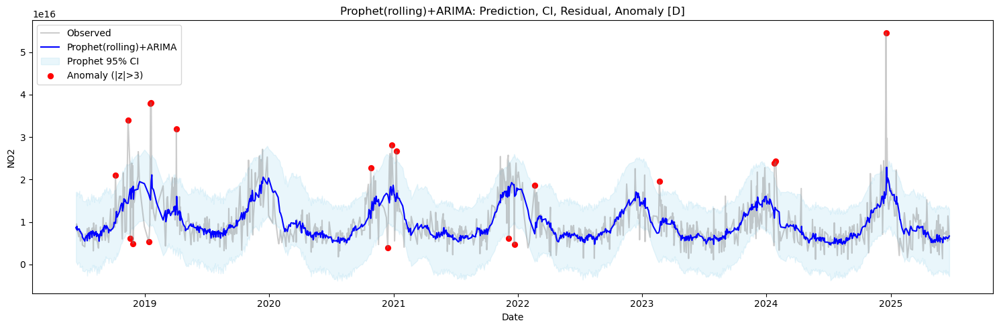

22:36:08 - cmdstanpy - INFO - Chain [1] start processing
22:36:08 - cmdstanpy - INFO - Chain [1] done processing
22:36:08 - cmdstanpy - INFO - Chain [1] start processing
22:36:08 - cmdstanpy - INFO - Chain [1] done processing
22:36:09 - cmdstanpy - INFO - Chain [1] start processing
22:36:09 - cmdstanpy - INFO - Chain [1] done processing
22:36:09 - cmdstanpy - INFO - Chain [1] start processing
22:36:09 - cmdstanpy - INFO - Chain [1] done processing
22:36:09 - cmdstanpy - INFO - Chain [1] start processing
22:36:09 - cmdstanpy - INFO - Chain [1] done processing
22:36:09 - cmdstanpy - INFO - Chain [1] start processing
22:36:09 - cmdstanpy - INFO - Chain [1] done processing
22:36:09 - cmdstanpy - INFO - Chain [1] start processing
22:36:09 - cmdstanpy - INFO - Chain [1] done processing
22:36:09 - cmdstanpy - INFO - Chain [1] start processing
22:36:09 - cmdstanpy - INFO - Chain [1] done processing
22:36:10 - cmdstanpy - INFO - Chain [1] start processing
22:36:10 - cmdstanpy - INFO - Chain [1]

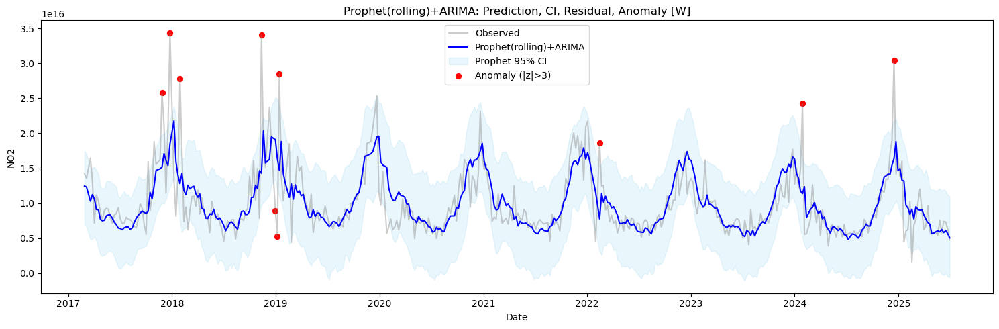

22:36:28 - cmdstanpy - INFO - Chain [1] start processing
22:36:28 - cmdstanpy - INFO - Chain [1] done processing
22:36:28 - cmdstanpy - INFO - Chain [1] start processing
22:36:28 - cmdstanpy - INFO - Chain [1] done processing
22:36:28 - cmdstanpy - INFO - Chain [1] start processing
22:36:28 - cmdstanpy - INFO - Chain [1] done processing
22:36:29 - cmdstanpy - INFO - Chain [1] start processing
22:36:29 - cmdstanpy - INFO - Chain [1] done processing
22:36:29 - cmdstanpy - INFO - Chain [1] start processing
22:36:29 - cmdstanpy - INFO - Chain [1] done processing
22:36:29 - cmdstanpy - INFO - Chain [1] start processing
22:36:29 - cmdstanpy - INFO - Chain [1] done processing
22:36:29 - cmdstanpy - INFO - Chain [1] start processing
22:36:30 - cmdstanpy - INFO - Chain [1] done processing
22:36:30 - cmdstanpy - INFO - Chain [1] start processing
22:36:30 - cmdstanpy - INFO - Chain [1] done processing
22:36:30 - cmdstanpy - INFO - Chain [1] start processing
22:36:30 - cmdstanpy - INFO - Chain [1]

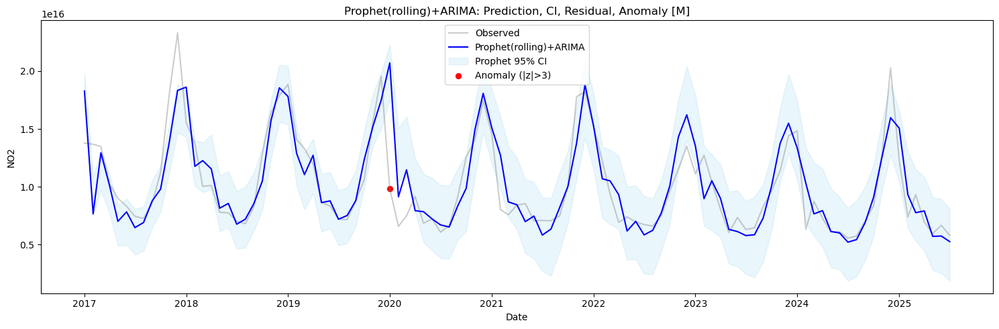

In [93]:
df_whn_daily_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_whn_NASA, freq='D',pollutant='NO2'), pollutant='NO2',
    train_steps=730, test_steps=30, step=30, z_thresh=3, freq='D', plot=True
)
df_whn_weekly_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_whn_NASA, freq='W',pollutant='NO2'), pollutant='NO2',
    train_steps=156, test_steps=8, step=4, z_thresh=3, freq='W', plot=True
)
df_whn_monthly_result_nasa = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_whn_NASA, freq='M',pollutant='NO2'), pollutant='NO2',
    train_steps=36, test_steps=4, step=1, z_thresh=3, freq='M', plot=True
)

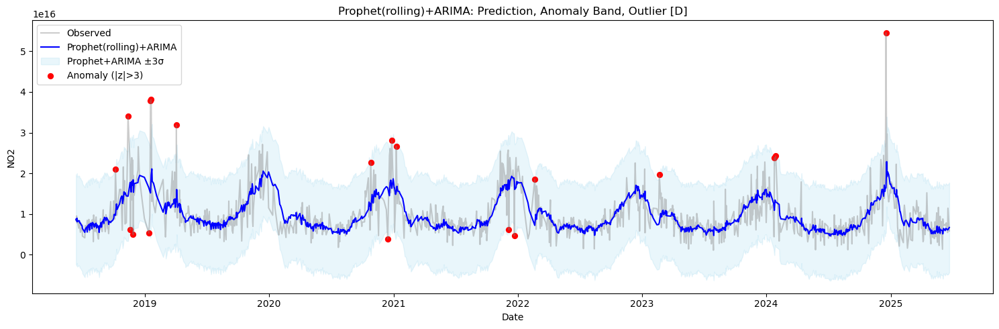

In [94]:
plot_arima_anomaly_band(df_whn_daily_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='D')


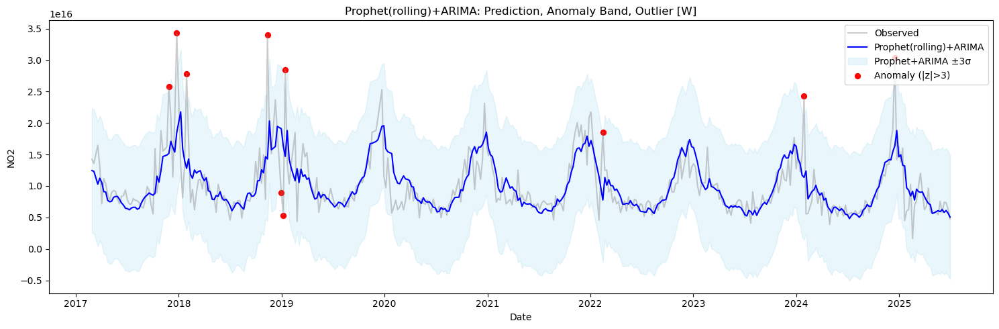

In [95]:
plot_arima_anomaly_band(df_whn_weekly_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='W')


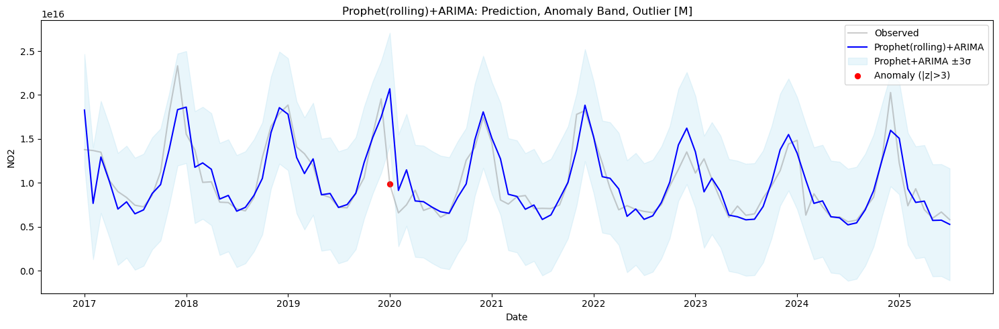

In [96]:
plot_arima_anomaly_band(df_whn_monthly_result_nasa, pollutant='NO2', shading_k=3, z_thresh=3, freq='M')


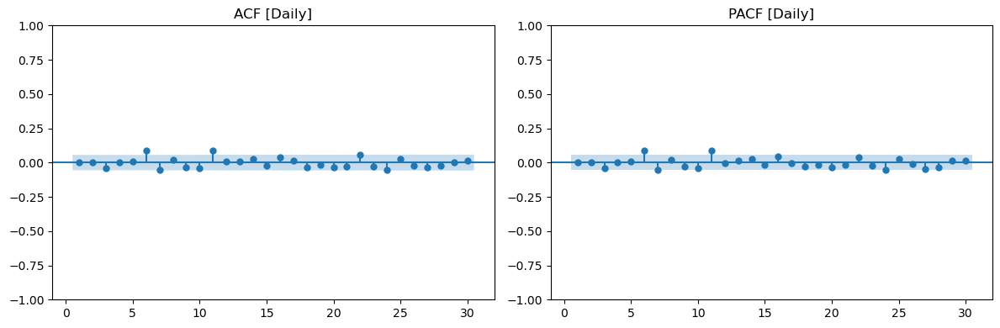

Ljung-Box Test [Daily] (using lags [10, 20, 30]):
      lb_stat  lb_pvalue
10  19.529326   0.034032
20  36.082583   0.015041
30  49.138244   0.015216



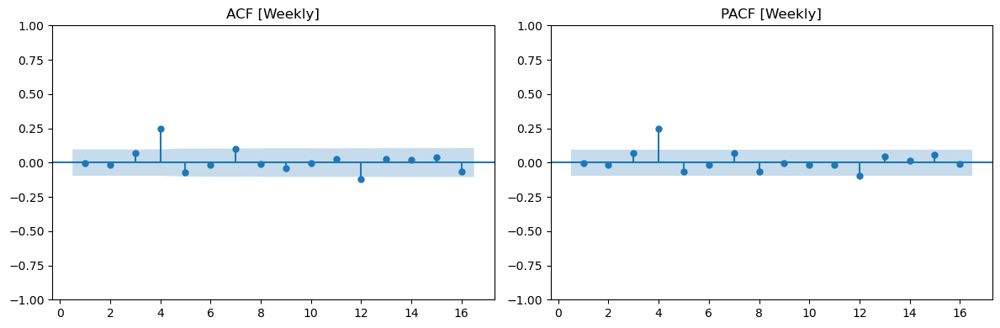

Ljung-Box Test [Weekly] (using lags [8, 12, 16]):
      lb_stat  lb_pvalue
8   34.448854   0.000034
12  41.475423   0.000041
16  44.295143   0.000178



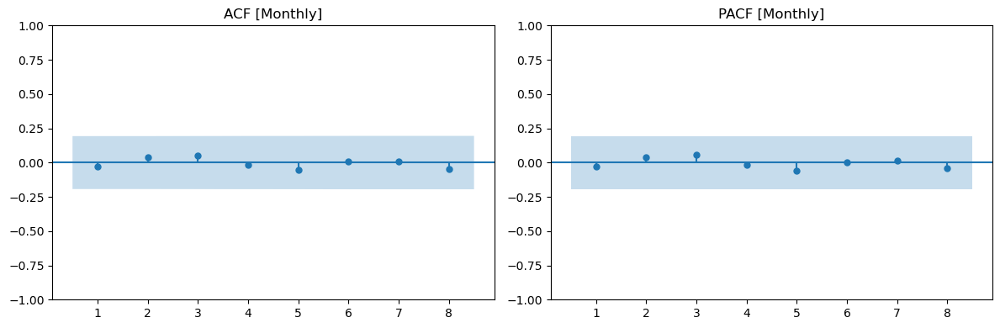

Ljung-Box Test [Monthly] (using lags [4, 8]):
    lb_stat  lb_pvalue
4  0.583909   0.964835
8  1.176961   0.996864



In [97]:
# Daily residual
residual_diagnostics(df_whn_daily_result_nasa, lags=[10,20,30], title='[Daily]')
# Weekly residual
residual_diagnostics(df_whn_weekly_result_nasa, lags=[8,12,16], title='[Weekly]')
# Monthly residual
residual_diagnostics(df_whn_monthly_result_nasa, lags=[4,8], title='[Monthly]')

# tangshan (ONly AQICN)

In [99]:
df_tan_AQICN = pd.read_csv("data/aqicn/tangshan.csv")
df_tan_AQICN = change_df(df_tan_AQICN)


C:\Users\Sehong\AppData\Local\Temp\ipykernel_18252\3838085212.py:3: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  data.date = pd.to_datetime(data.date)


22:36:59 - cmdstanpy - INFO - Chain [1] start processing
22:36:59 - cmdstanpy - INFO - Chain [1] done processing
22:36:59 - cmdstanpy - INFO - Chain [1] start processing
22:36:59 - cmdstanpy - INFO - Chain [1] done processing
22:36:59 - cmdstanpy - INFO - Chain [1] start processing
22:36:59 - cmdstanpy - INFO - Chain [1] done processing
22:36:59 - cmdstanpy - INFO - Chain [1] start processing
22:37:00 - cmdstanpy - INFO - Chain [1] done processing
22:37:00 - cmdstanpy - INFO - Chain [1] start processing
22:37:00 - cmdstanpy - INFO - Chain [1] done processing
22:37:00 - cmdstanpy - INFO - Chain [1] start processing
22:37:00 - cmdstanpy - INFO - Chain [1] done processing
22:37:00 - cmdstanpy - INFO - Chain [1] start processing
22:37:00 - cmdstanpy - INFO - Chain [1] done processing
22:37:00 - cmdstanpy - INFO - Chain [1] start processing
22:37:00 - cmdstanpy - INFO - Chain [1] done processing
22:37:01 - cmdstanpy - INFO - Chain [1] start processing
22:37:01 - cmdstanpy - INFO - Chain [1]

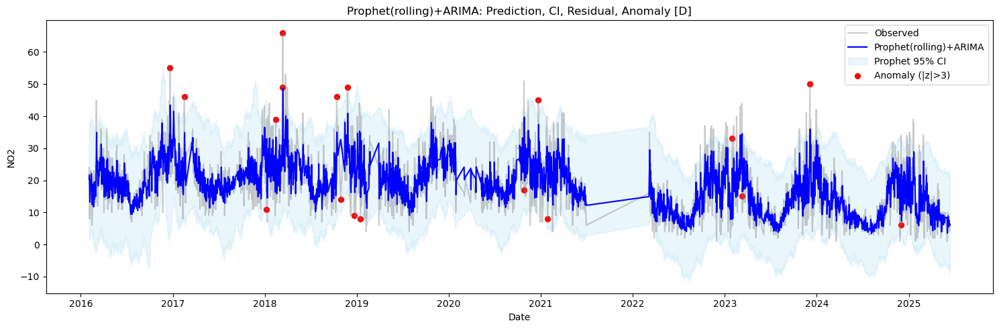

22:37:38 - cmdstanpy - INFO - Chain [1] start processing
22:37:38 - cmdstanpy - INFO - Chain [1] done processing
22:37:38 - cmdstanpy - INFO - Chain [1] start processing
22:37:38 - cmdstanpy - INFO - Chain [1] done processing
22:37:38 - cmdstanpy - INFO - Chain [1] start processing
22:37:38 - cmdstanpy - INFO - Chain [1] done processing
22:37:38 - cmdstanpy - INFO - Chain [1] start processing
22:37:38 - cmdstanpy - INFO - Chain [1] done processing
22:37:38 - cmdstanpy - INFO - Chain [1] start processing
22:37:38 - cmdstanpy - INFO - Chain [1] done processing
22:37:39 - cmdstanpy - INFO - Chain [1] start processing
22:37:39 - cmdstanpy - INFO - Chain [1] done processing
22:37:39 - cmdstanpy - INFO - Chain [1] start processing
22:37:39 - cmdstanpy - INFO - Chain [1] done processing
22:37:39 - cmdstanpy - INFO - Chain [1] start processing
22:37:39 - cmdstanpy - INFO - Chain [1] done processing
22:37:39 - cmdstanpy - INFO - Chain [1] start processing
22:37:39 - cmdstanpy - INFO - Chain [1]

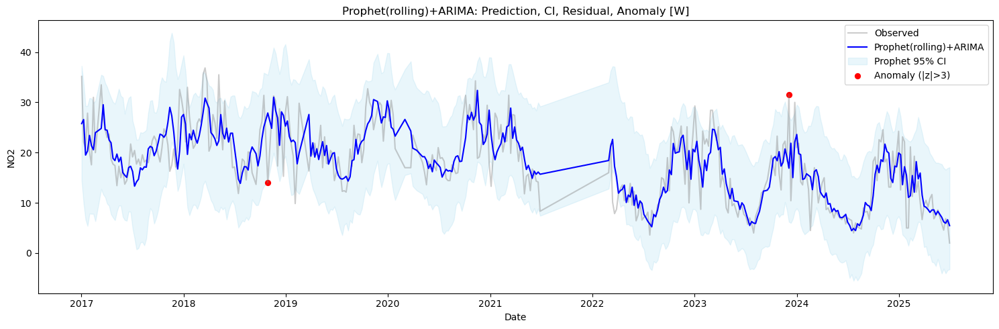

22:37:56 - cmdstanpy - INFO - Chain [1] start processing
22:37:56 - cmdstanpy - INFO - Chain [1] done processing
22:37:56 - cmdstanpy - INFO - Chain [1] start processing
22:37:56 - cmdstanpy - INFO - Chain [1] done processing
22:37:56 - cmdstanpy - INFO - Chain [1] start processing
22:37:56 - cmdstanpy - INFO - Chain [1] done processing
22:37:56 - cmdstanpy - INFO - Chain [1] start processing
22:37:57 - cmdstanpy - INFO - Chain [1] done processing
22:37:57 - cmdstanpy - INFO - Chain [1] start processing
22:37:57 - cmdstanpy - INFO - Chain [1] done processing
22:37:57 - cmdstanpy - INFO - Chain [1] start processing
22:37:57 - cmdstanpy - INFO - Chain [1] done processing
22:37:57 - cmdstanpy - INFO - Chain [1] start processing
22:37:57 - cmdstanpy - INFO - Chain [1] done processing
22:37:57 - cmdstanpy - INFO - Chain [1] start processing
22:37:58 - cmdstanpy - INFO - Chain [1] done processing
22:37:58 - cmdstanpy - INFO - Chain [1] start processing
22:37:58 - cmdstanpy - INFO - Chain [1]

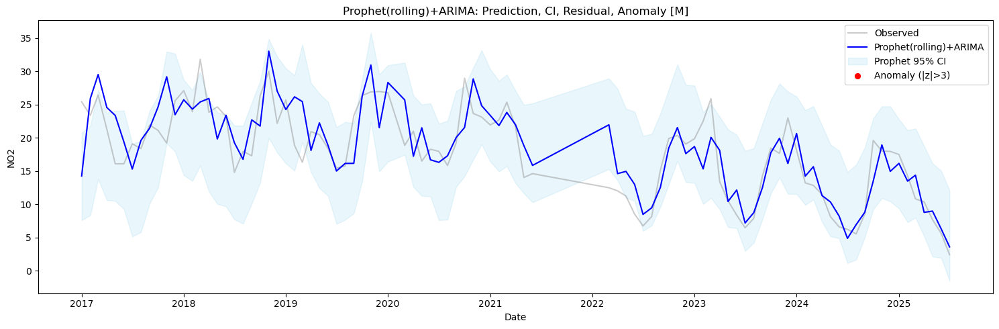

In [100]:
df_tan_daily_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_tan_AQICN, freq='D',pollutant='NO2'), pollutant='NO2',
    train_steps=730, test_steps=30, step=30, z_thresh=3, freq='D', plot=True
)
df_tan_weekly_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_tan_AQICN, freq='W',pollutant='NO2'), pollutant='NO2',
    train_steps=156, test_steps=8, step=4, z_thresh=3, freq='W', plot=True
)
df_tan_monthly_result_aqicn = rolling_prophet_forecast_CI_with_arima(
    make_agg(df_tan_AQICN, freq='M',pollutant='NO2'), pollutant='NO2',
    train_steps=36, test_steps=4, step=1, z_thresh=3, freq='M', plot=True
)

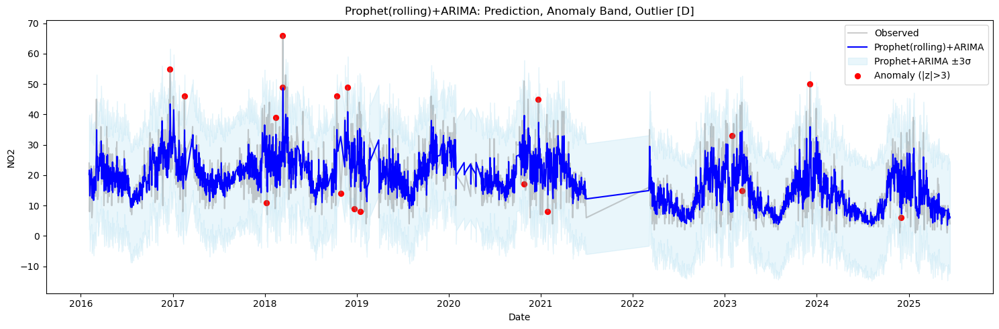

In [101]:
plot_arima_anomaly_band(df_tan_daily_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='D')

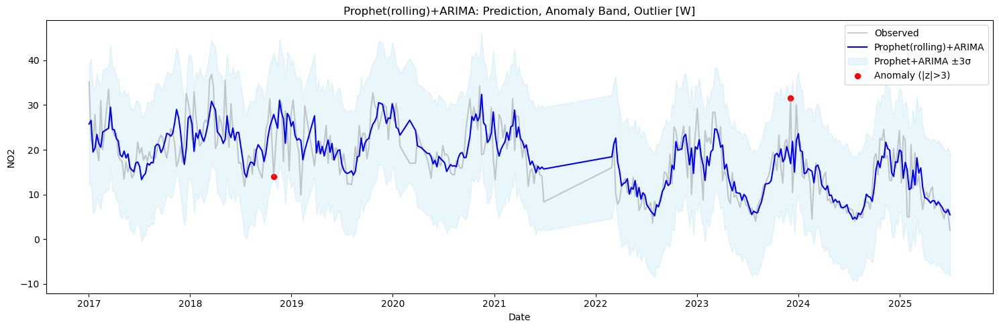

In [102]:
plot_arima_anomaly_band(df_tan_weekly_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='W')


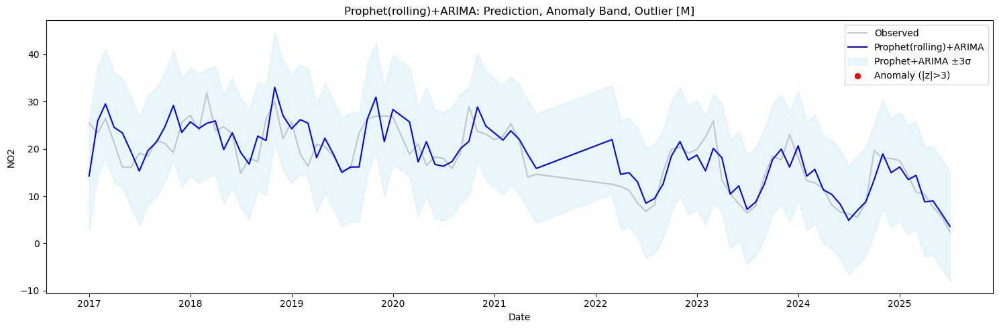

In [103]:
plot_arima_anomaly_band(df_tan_monthly_result_aqicn, pollutant='NO2', shading_k=3, z_thresh=3, freq='M')


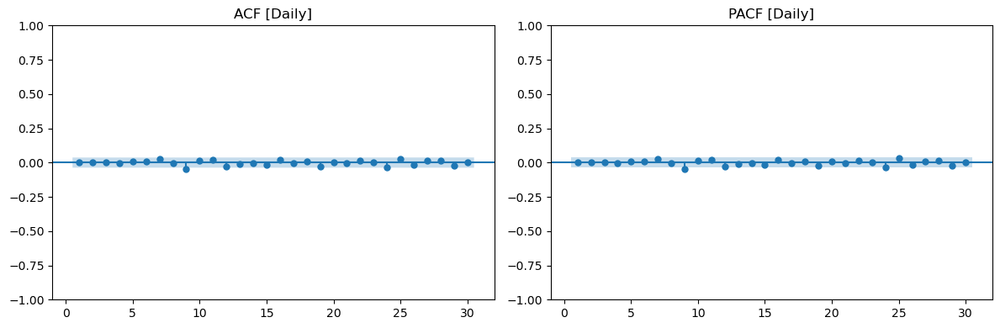

Ljung-Box Test [Daily] (using lags [10, 20, 30]):
      lb_stat  lb_pvalue
10  10.490834   0.398535
20  18.174572   0.575909
30  27.957522   0.572688



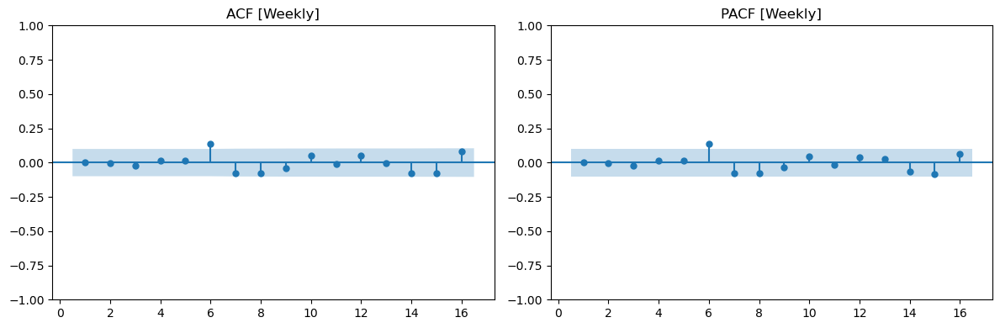

Ljung-Box Test [Weekly] (using lags [8, 12, 16]):
      lb_stat  lb_pvalue
8   12.365774   0.135615
12  15.175301   0.231989
16  22.964735   0.114680



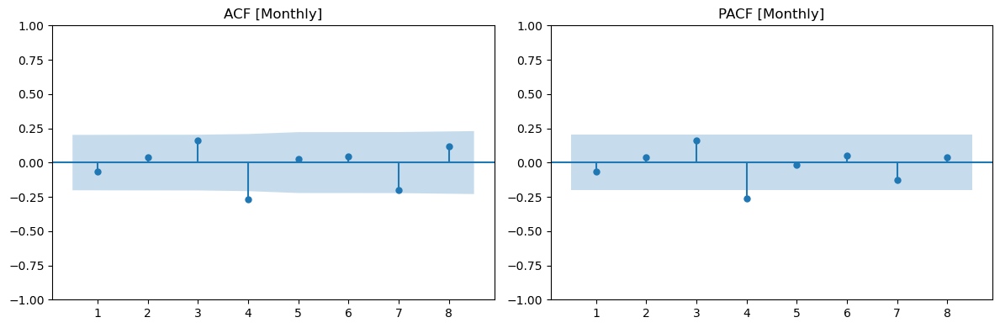

Ljung-Box Test [Monthly] (using lags [4, 8]):
     lb_stat  lb_pvalue
4  10.398387   0.034226
8  16.194421   0.039680



In [104]:
# Daily residual
residual_diagnostics(df_tan_daily_result_aqicn, lags=[10,20,30], title='[Daily]')
# Weekly residual
residual_diagnostics(df_tan_weekly_result_aqicn, lags=[8,12,16], title='[Weekly]')
# Monthly residual
residual_diagnostics(df_tan_monthly_result_aqicn, lags=[4,8], title='[Monthly]')